<a href="https://colab.research.google.com/github/acse-moj20/msc-irp/blob/dev/PredGAN/PredGAN_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Dev Code (PredGAN) For Fluid Problem** 

General Specs:
- POD Coefficients: 292
- GAN Architecture 
  - generator: Modified. Additional conv2dT layer and filter size.
  - disciriminator: Modified. 2 additional conv2d layers. 
- Learning_rate: 1e-4
- number generated: 5
- Batch_size: 256
- Epochs: 50,000

**Version: A300**
- Latent space: 300
- ntimes: 21; steps: 1

**Version: B300** (HERE)
- Latent space: 300
- ntimes: 21; steps: 2



Setup and package import

In [1]:
%matplotlib inline
import sys
import os
import sklearn
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import joblib
import time


mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [2]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# Processing Power and Available Memory

GPU Specs

In [3]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('GPU info not found.')
else:
  print(gpu_info)

print('Num of available GPUs: ', len(tf.config.list_physical_devices('GPU')))

Thu Aug  5 04:57:21 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Memory Allocation

In [4]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM



#Utility Functions

In [5]:
## UTILITY FUNCTIONS FOR VISUALIZATION AND ERROR MEASUREMENT

def calculate_error(data, data_recovered):
  abs_error = abs(data - data_recovered)
  perc_error = abs_error*100/abs(data)

  return np.max(abs_error), np.mean(abs_error)

def plot_vortex(data, times, cols, rows=1):
  fig, ax = plt.subplots(rows, cols, figsize=[20, 5*cols])
  
  for i, step in enumerate(times):
    im = ax.flatten()[i].imshow(data[step], cmap='RdBu')
    cbar = plt.colorbar(im, ax=ax.flatten()[i], shrink=0.25, pad=0.05, panchor=(0.0, 0.0))    
    ax.flatten()[i].set_title('t = {}'.format(step), y=1.05, 
                          fontsize=16, fontweight="bold")
  plt.show()


def concat_timesteps(X_train, ntimes, step, window_start, window_end):
    X_train_concat = []
    for start, end in zip(window_start, window_end):
      for i in range(start, end+step): 
        X_train_concat.append(X_train[i:i+ntimes*step:step])
        # print('sample starts from {} :'.format(i))
        # for j in range(i, i+ntimes*step, step):
        #   print('{}'.format(j) , end=', ')
        # print('\n')
    return np.array(X_train_concat)

def invert_data(X_data):
  X_scale_inverted = scaler.inverse_transform(X_data)
  X_pca_inverted = pca.inverse_transform(X_scale_inverted)
  return X_pca_inverted

def transform_data(X_data):
  X_pca = pca.fit_transform(X_data)
  X_pca_scaled = scaler.fit_transform(X_pca)
  return X_pca_scaled


# Model Reduction

##**Data Details**

What we know so far:


*   Dataset represents the parameter values of u, v and p for 100 separate examples of the high fidelity solution.
*   Each example is computed over 50 timesteps and a on a 256-by-256 grid.

*   Vorticity over the vector field is obatined by computing the curl of u (x-component velocity vector) and v (y-component velocity vector)






##**Raw data transformation**

**Get Data from Drive and transform**

To be run only once

In [ ]:
# data_dir = 'drive/MyDrive/MSC_IRP/data/vortex_100.npy'

# # Load x and y velocity components.
# data_file = np.load(data_dir)

# print('Size of dataset:         ', data_file.shape)
# print('Number of data samples:  ', len(data_file))
# print('Size of each sample:     ', data_file[0].shape)
# print('Number of time steps:    ', len(data_file[0]))

Size of dataset:          (100, 50, 256, 256, 3)
Number of data samples:   100
Size of each sample:      (50, 256, 256, 3)
Number of time steps:     50


In [ ]:

# # Data transformation - computing vorticity from vector field.
# # vorticity is the curl of the velocity vector field (raw dataset).

# def curl(u,v):
#   """ 
#   Function to calculate the curl of a 2-dimensional vector field.
#   Parameters:
#   -----------
#     u : 2d array of size n*m
#       vector component in the x direction.

#     v : 2d array of size n*m
#       vector component in the y direction
#   Output:
#   -------
#     curl : 2d array of size n*m
#       curl of vector field [i.e. (dv/dx)i - (du/dy)j]
#   """
#   curl = np.gradient(v)[0] - np.gradient(u)[1]
#   return curl


**Save Transformed Data to Drive**

To be run only once

In [ ]:
# Compute and save vorticity for easier data loading

# vorticity = np.zeros((100, 50, 256, 256))
# for i in range(len(data_file)):
#  for j in range(len(data_file[0])):
#    vorticity[i][j] = curl(data_file[i][j][:, :, 0], data_file[i][j][:, :, 1])
# save_dir = 'drive/MyDrive/MSC_IRP/data/calc_vortex_100.npy'
# np.save(save_dir, vorticity)

##**Dataset visualization**

In [ ]:
import seaborn as sns
from matplotlib import animation

# # create a figure and axes
# fig, ax = plt.subplots(1,2, figsize=(12,5))

# ax[0].set_xlim((0,1))
# ax[0].set_ylim((0,1))
# ax[0].set_xlabel('X')
# ax[0].set_ylabel('Y')
# ax[0].set_title('X-Velocity vs. time')

# ax[1].set_xlim((0,1))
# ax[1].set_ylim((0,1))
# ax[1].set_xlabel('X')
# ax[1].set_ylabel('Y')
# ax[1].set_title('Y-Velocity vs. time')
# txt_title = ax[1].set_title('')
# line1 = ax[0].imshow(data[0][:, :, 0])     # ax.plot returns a list of 2D line objects
# line2 = ax[1].imshow(data[0][:, :, 1])

fig, ax= plt.subplots(figsize=(10,10))
ax.set_xlim((0,1))
ax.set_ylim((0,1))
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('Y-Velocity vs. time')
txt_title = ax.set_title('')

def drawframe(n):

    x,y = np.meshgrid(np.linspace(0,1,256),np.linspace(0,1,256))
    plot = plt.quiver(x, y, data[n][:, :, 0], data[n][:, :, 1], 
                      np.arctan2(data[n][:, :, 0], data[n][:, :, 1]),
                      angles='xy', cmap='RdBu')
    # line1 = plt.imshow(data[n][:, :, 0])
    # line2 = plt.imshow(data[n][:, :, 1])
    txt_title.set_text('Frame = {0:4d}'.format(n))
    return (plot.U, plot.V)

txt_title.set_text('Frame = {0:4d}'.format(25))
anim = animation.FuncAnimation(fig, drawframe, frames=49, interval=200)
from IPython.display import HTML
HTML(anim.to_html5_video())

# x,y = np.meshgrid(np.linspace(0,1,256),np.linspace(0,1,256))

# plt.quiver(x, y, data[10][:, :, 0], data[10][:, :, 1], np.arcsin(data[10][:, :, 0], data[10][:, :, 1],), angles='xy', scale_units='xy', scale=1,color='r')
# plt.show()

# x,y = np.meshgrid(np.linspace(0,1,256),np.linspace(0,1,256))
# plt.quiver(x, y, data[35][:, :, 0], data[35][:, :, 1], np.arcsin(data[35][:, :, 0], data[35][:, :, 1],), angles='xy', scale_units='xy', scale=1,color='r')
# plt.show()

In [ ]:
# from mpl_toolkits.mplot3d import Axes3D
# import matplotlib.pyplot as plt
# import numpy as np
# from itertools import product, combinations


# fig = plt.figure()
# ax = fig.gca(projection='3d')


# # draw cube
# r = [-1, 0]
# for s, e in combinations(np.array(list(product(r, r, r))), 2):
#     if np.sum(np.abs(s-e)) == r[1]-r[0]:
#         ax.plot3D(*zip(s, e), color="b")
# r = [1, 1]
# for s, e in combinations(np.array(list(product(r, r, r))), 2):
#     if np.sum(np.abs(s-e)) == r[1]-r[0]:
#         ax.plot3D(*zip(s, e), color="b")
# # make the panes transparent
# ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
# ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
# ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
# # make the grid lines transparent
# ax.xaxis._axinfo["grid"]['color'] =  (1,1,1,0)
# ax.yaxis._axinfo["grid"]['color'] =  (1,1,1,0)
# ax.zaxis._axinfo["grid"]['color'] =  (1,1,1,0)
# ax.set_axis_off()
# plt.show()





# def plot_cuboid(center, size):
#     """
#        Create a data array for cuboid plotting.


#        ============= ================================================
#        Argument      Description
#        ============= ================================================
#        center        center of the cuboid, triple
#        size          size of the cuboid, triple, (x_length,y_width,z_height)
#        :type size: tuple, numpy.array, list
#        :param size: size of the cuboid, triple, (x_length,y_width,z_height)
#        :type center: tuple, numpy.array, list
#        :param center: center of the cuboid, triple, (x,y,z)
#    """
#     # suppose axis direction: x: to left; y: to inside; z: to upper
#     # get the (left, outside, bottom) point
#     import numpy as np
#     ox, oy, oz = center
#     l, w, h = size

#     x = np.linspace(ox-l/2,ox+l/2,num=10)
#     y = np.linspace(oy-w/2,oy+w/2,num=10)
#     z = np.linspace(oz-h/2,oz+h/2,num=10)
#     x1, z1 = np.meshgrid(x, z)
#     y11 = np.ones_like(x1)*(oy-w/2)
#     y12 = np.ones_like(x1)*(oy+w/2)
#     x2, y2 = np.meshgrid(x, y)
#     z21 = np.ones_like(x2)*(oz-h/2)
#     z22 = np.ones_like(x2)*(oz+h/2)
#     y3, z3 = np.meshgrid(y, z)
#     x31 = np.ones_like(y3)*(ox-l/2)
#     x32 = np.ones_like(y3)*(ox+l/2)

#     from mpl_toolkits.mplot3d import Axes3D
#     import matplotlib.pyplot as plt
#     fig = plt.figure()
#     ax = fig.gca(projection='3d')
#     # outside surface
#     ax.plot_wireframe(x1, y11, z1, color='r', rstride=1, cstride=1, alpha=0.6)
#     # inside surface
#     ax.plot_wireframe(x1, y12, z1, color='r', rstride=1, cstride=1, alpha=0.6)
#     # bottom surface
#     ax.plot_wireframe(x2, y2, z21, color='r', rstride=1, cstride=1, alpha=0.6)
#     # upper surface
#     ax.plot_wireframe(x2, y2, z22, color='r', rstride=1, cstride=1, alpha=0.6)
#     # left surface
#     ax.plot_wireframe(x31, y3, z3, color='r', rstride=1, cstride=1, alpha=0.6)
#     # right surface
#     ax.plot_wireframe(x32, y3, z3, color='r', rstride=1, cstride=1, alpha=0.6)
#     ax.set_xlabel('X')
#     ax.set_xlim(-100, 100)
#     ax.set_ylabel('Y')
#     ax.set_ylim(-100, 100)
#     ax.set_zlabel('Z')
#     ax.set_zlim(-100, 100)
#     # make the panes transparent
#     ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#     ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#     ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#     # make the grid lines transparent
#     ax.xaxis._axinfo["grid"]['color'] =  (1,1,1,0)
#     ax.yaxis._axinfo["grid"]['color'] =  (1,1,1,0)
#     ax.zaxis._axinfo["grid"]['color'] =  (1,1,1,0)
#     ax.set_axis_off()
#     plt.show()



# def test():
#     center = [0, 0, 0]
#     length = 50 * 3
#     width = 50 * 3
#     height = 3 * 10
#     plot_cuboid(center, (length, width, height))
# test()

##**Dimensionality reduction - PCA**

The training dataset will consist of 100 samples of a high-fidelity numerical simulation each with 50 evenly sampled snapshots (in time). Each simulation represents velocity (in x and y directions) and pressure for the turbulent flow model over a region of grid size 256x256. These values can be used to generate a vorticity field for the model. Thus, there is a total number of 256 * 256 = 65,536 variables per time step and a total of 50 * 100 = 5,000 samples. Dimensionality reduction of this high dimensional space is then performed using Principal Component Analysis (PCA) in order to work with a relatively low dimension space

###Load Data

In [ ]:
# Load vortex data as traing data.
X_train3d = np.load('drive/MyDrive/MSC_IRP/data/calc_vortex_100.npy')

In [ ]:
times = [0, 14, 20, 49]
plot_vortex(X_train3d[58], times, len(times))

In [ ]:
nx = len(X_train3d[0][0])
timestep = len(X_train3d[0])
X_train3d.shape

(100, 50, 256, 256)

###Build PCA Model

This PCA model is built using the 292 components that gave > 99.9% variance in the reduction.

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

normalize = False # flag to normalize training data before PCA or not.
X_train1d = X_train3d.reshape((-1, nx*nx))
print(X_train1d.shape)

# Normalization
if(normalize):
  X_train1d = StandardScaler().fit_transform(X_train1d)

# Initiate PCA
pca = PCA(X_train1d.shape[0])
X_train_pca = pca.fit_transform(X_train1d)

(5000, 65536)


KeyboardInterrupt: ignored

In [ ]:
X_recovered_1d = pca.inverse_transform(X_train_pca)
np.allclose(X_recovered_1d, X_train1d)

True

In [ ]:
p = 0.999
cumsum_eig = np.cumsum(pca.explained_variance_ratio_)
n_components_eig = np.argmax(cumsum_eig >= p) + 1 # returns the indices of the maximum values along an axis.
n_components_eig

292

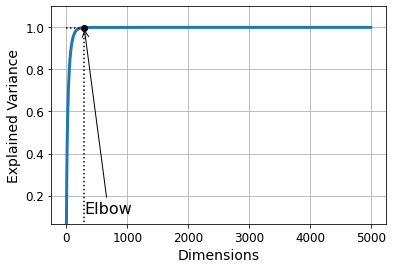

In [ ]:
plt.figure(figsize=(6,4))
plt.plot(cumsum_eig, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.ylim([cumsum_eig[0],1.1])
plt.plot([n_components_eig, n_components_eig], [0, p], "k:")
plt.plot([0, n_components_eig], [p, p], "k:")
plt.plot(n_components_eig, p, "ko")
plt.annotate("Elbow", xy=(n_components_eig, p), xytext=(n_components_eig, cumsum_eig[0]+0.05),
             arrowprops=dict(arrowstyle="->"), fontsize=16)
plt.grid(True)
plt.show()

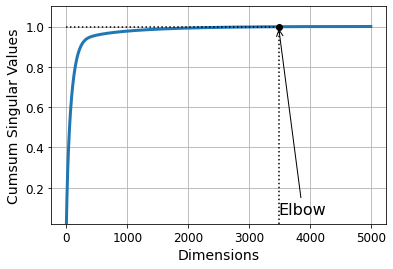

In [ ]:
p = 0.999
cumsum_sv = np.cumsum(pca.singular_values_/sum(pca.singular_values_))
n_components_sv = np.argmax(cumsum_sv >= p) + 1

d = n_components_sv
plt.figure(figsize=(6,4))
plt.plot(cumsum_sv, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Cumsum Singular Values")
plt.ylim([cumsum_sv[0],1.1])
plt.plot([d, d], [0, p], "k:")
plt.plot([0, d], [p, p], "k:")
plt.plot(d, p, "ko")
plt.annotate("Elbow", xy=(d, p), xytext=(d, cumsum_sv[0]+0.05),
             arrowprops=dict(arrowstyle="->"), fontsize=16)
plt.grid(True)
plt.show()
print(d)

In [ ]:
pca_rom = PCA(n_components=n_components_eig)
X_train_pca = pca_rom.fit_transform(X_train1d)
X_reconstruct = pca_rom.inverse_transform(X_train_pca)
print(X_train_pca.shape)
np.allclose(X_reconstruct, X_train1d)

(5000, 292)


False

In [ ]:
# Comparing actual data and pca reduced data
actual_data = X_train1d.reshape((-1, timestep, nx, nx))[89]
recon_data = X_reconstruct.reshape((-1, timestep, nx, nx))[89]

In [ ]:
plot_vortex(actual_data, times, len(times))

In [ ]:
plot_vortex(recon_data, times, len(times))

###Calculate Error

In [ ]:
max_abs_err, mean_abs_err = calculate_error(actual_data, recon_data)
print("Max. abs. error: {}". format(max_abs_err))
print("Mean abs. error: {}".format(mean_abs_err))

Max. abs. error: 0.0026068006677143927
Mean abs. error: 5.0103895884519914e-05


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """


###Save PCA model

In [ ]:
import joblib
pca_file_dir = "drive/MyDrive/MSC_IRP/PredGAN/pca_rom_292.pkl"
with open(pca_file_dir, 'wb') as save_file:  
  joblib.dump(pca_rom, save_file)
#np.save('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_100.npy', X_train_pca)

#Training Prediction GAN

Following reduction in dimension, we can now proceed to train a GAN for prediction.

###Load Data

In [6]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

SAVE_DIR = 'drive/MyDrive/MSC_IRP/PredGAN/'

nx = 256 # len(X_train3d[0][0])
timestep = 50 # len(X_train3d[0])

print (nx)
print(timestep)

256
50


**CONFIG. SETTINGS**

In [7]:
normalize = False # flag to normalize training data before PCA or not.
mem_load = True
num_of_coeff = 292
ntimes = 7 # Consecutive times for the GAN
step = 5 # step between times


g_lr = 1e-4
d_lr = 1e-4
num_examples_to_generate = 15

BATCH_SIZE = 16
latent_space = 3000

# Seed and intitialization
seed = tf.random.normal([num_examples_to_generate, latent_space])

In [8]:
if (mem_load):
  pca = joblib.load('drive/MyDrive/MSC_IRP/PredGAN/pca_rom_292.pkl')
  X_train1d_pca = np.load('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_100.npy')
else: 
  # Load vortex data as traing data.
  X_train3d = np.load('drive/MyDrive/MSC_IRP/data/calc_vortex_100.npy')
  X_train1d = X_train3d.reshape((-1, nx*nx))
  if (normalize):
    X_train1d = StandardScaler().fit_transform(X_train1d)
  # 
  pca = PCA(num_of_coeff)
  X_train1d_pca = pca.fit_transform(X_train1d)
print(X_train1d_pca.shape)

(5000, 292)


In [9]:
# test 1
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train1d_pca_scaled = scaler.fit_transform(X_train1d_pca)
np.allclose(X_train1d_pca, scaler.inverse_transform((X_train1d_pca_scaled)))


True

### Visualize Data

In [45]:
times = [0, 14, 20, 49]
plot_vortex(X_train3d[69], times, len(times))

NameError: ignored

(100, 50, 256, 256)


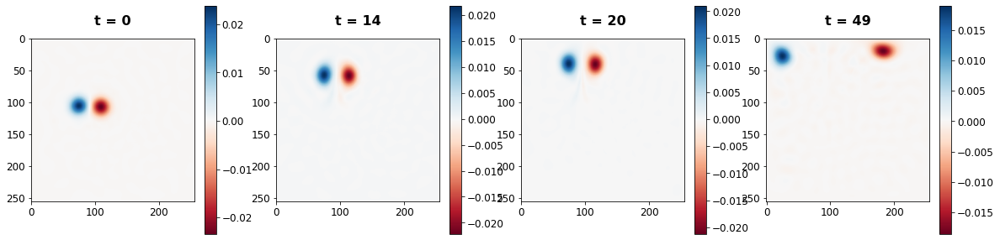

In [46]:
# Inverse PCA plots
X_recovered = pca.inverse_transform(X_train1d_pca).reshape(-1,timestep, nx, nx)
print(X_recovered.shape)
plot_vortex(X_recovered[69], times, len(times))

(100, 50, 256, 256)


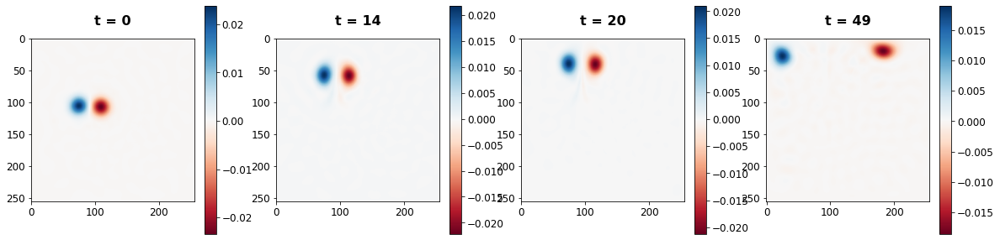

In [47]:
# Inverse scaling and inverse PCA plots
X_recovered = invert_data(X_train1d_pca_scaled).reshape(-1,timestep, nx, nx)
print(X_recovered.shape)
plot_vortex(X_recovered[69], times, len(times))

### Time series Concatenation

In [10]:
sample_size = 100 # X_train3d.shape[0] #100 separate samples
window_start = [(sample*timestep)for sample in range(sample_size)]
window_end = [(sample*timestep) - (ntimes*step) for sample in range(1, sample_size + 1)]


X_train_concat = concat_timesteps(X_train1d_pca_scaled, ntimes, step, window_start, window_end)
X_train_concat_flatten = X_train_concat.reshape(X_train_concat.shape[0], num_of_coeff*ntimes)
print(X_train_concat.shape)
print(X_train_concat_flatten.shape)

(2000, 7, 292)
(2000, 2044)


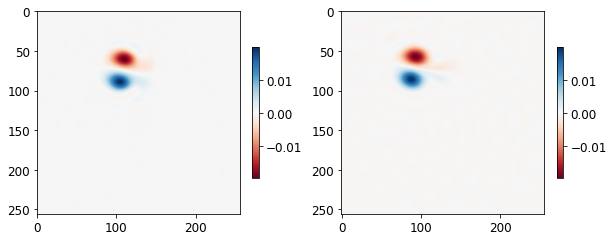

(5, 65536)


In [ ]:
# Reverse transform concatenated series to check correctness
fig, ax = plt.subplots(1, 2, figsize=[10,10])
X_ = invert_data(X_train_concat[69, :, :])
im = ax[0].imshow(X_[0,:].reshape(nx, nx), cmap='RdBu')
im = ax[1].imshow(X_[1, :].reshape(nx, nx), cmap='RdBu')
fig.colorbar(im, ax=ax.flatten()[0], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
fig.colorbar(im, ax=ax.flatten()[1], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
plt.show()
print(X_.shape)


Dataset Creation

In [ ]:
# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], ntimes, num_of_coeff, 1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_concat)).batch(BATCH_SIZE)

### DCGAN 

1. (original architecture with diff LR: disc=1e-4, gen=5e-5) **still collapses**
2. More latent space, 64 batch size, equal LR. **still collapses**
3. 3000 latent space, 7 consecutive times for the GAN, 5 step gap between times

Generator Model

In [ ]:
def make_generator_model():
    # model = tf.keras.Sequential()
    # model.add(keras.layers.Dense(5*73*256, use_bias=False, input_shape=(latent_space,)))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Reshape((5, 73, 256)))

    # model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU()) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3), padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 30720)             92160000  
_________________________________________________________________
batch_normalization_5 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 30720)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_6 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 5, 12, 256)       

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


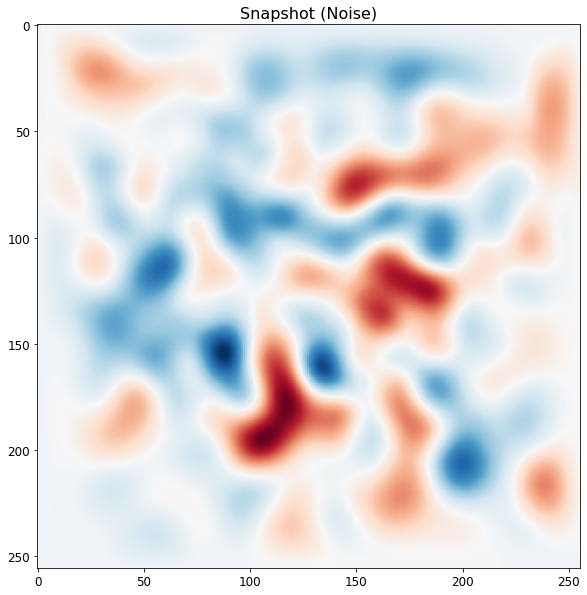

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Discriminator

In [ ]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 4, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 4, 146, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 2, 73, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 2, 73, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 1, 37, 128)       

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-2.5051228e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

Cost Function and Optimization

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def generator_loss(fake_output):
  fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
  return fake_loss

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

# Optimizers for generator and optimizer models

generator_optimizer = tf.keras.optimizers.Adam(g_lr)
discriminator_optimizer = tf.keras.optimizers.Adam(d_lr)


In [ ]:
# logs to document losses
version_num = 'E3000_16b'
# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: gen-', g_lr, ', disc-', d_lr)
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_16b
POD coeffiecients:  292
Batch size:  16
Learning Rate: gen- 0.0001 , disc- 0.0001


Training step

In [ ]:
@tf.function
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)

Train GAN - Training loop

In [ ]:
def train(dataset, epochs):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        print("discriminator loss: ", "{:.6f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.6f}".format(hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show() 
                    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
        if epoch%1000 == 0:
          # Save model once greater that 10,000 iterations 
            gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                        str(num_of_coeff)+'_'+str(epoch)+'.h5')  
            
    return hist


discriminator loss:  0.259732 - generator loss:  3.153177 - 3s
Epoch 14296/50000
discriminator loss:  0.239889 - generator loss:  3.206501 - 3s
Epoch 14297/50000
discriminator loss:  0.245524 - generator loss:  3.176093 - 3s
Epoch 14298/50000
discriminator loss:  0.238950 - generator loss:  3.165423 - 3s
Epoch 14299/50000
discriminator loss:  0.246171 - generator loss:  3.163595 - 3s
Epoch 14300/50000
discriminator loss:  0.247237 - generator loss:  3.159078 - 3s
Epoch 14301/50000
discriminator loss:  0.243870 - generator loss:  3.195791 - 3s
(105, 65536)


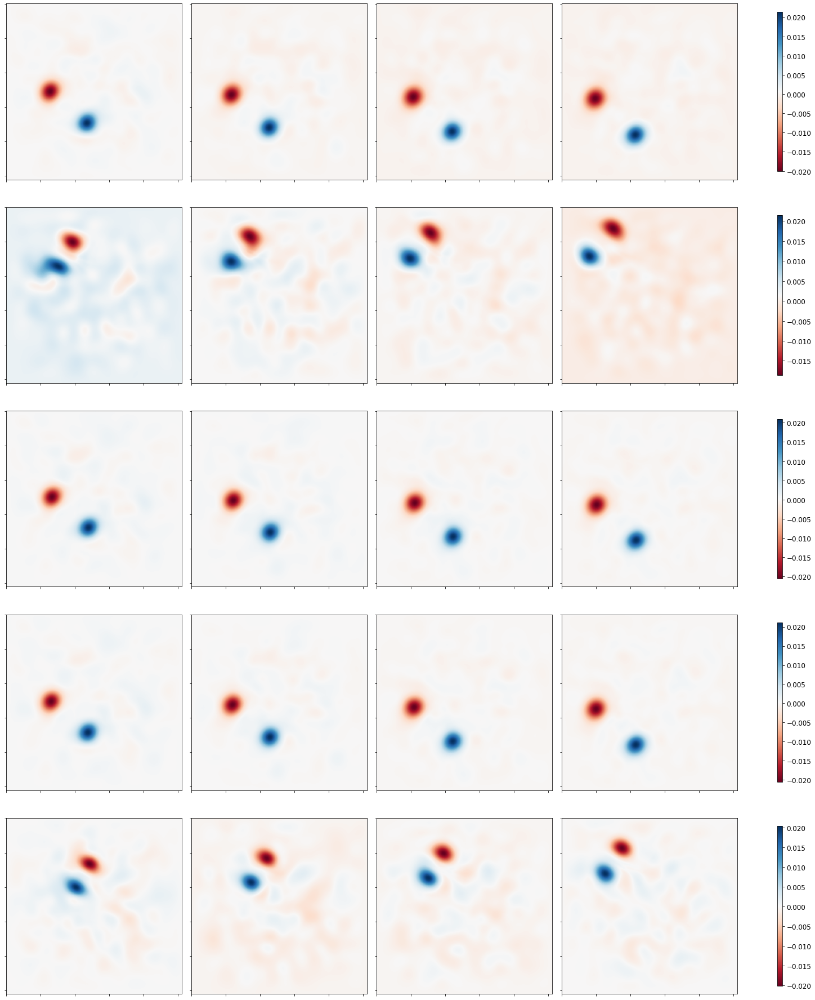

Loss: 


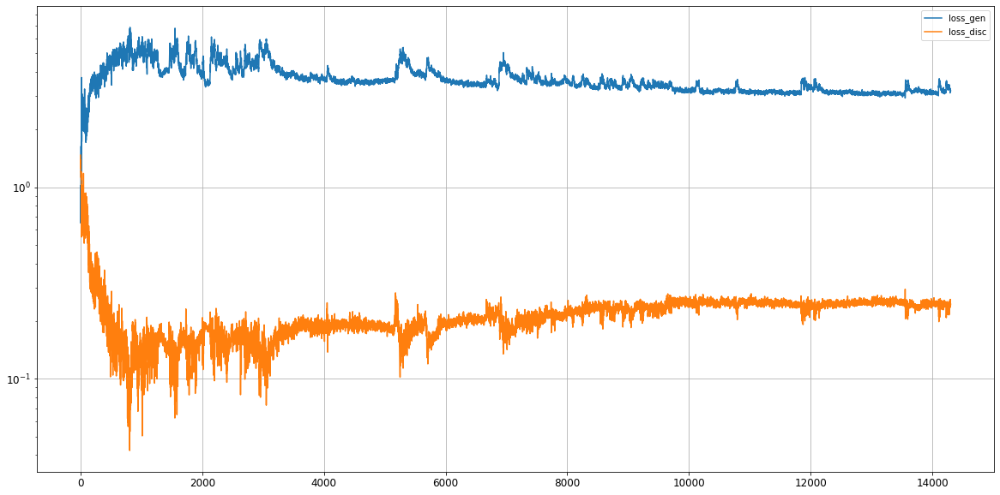

Epoch 14302/50000
discriminator loss:  0.241157 - generator loss:  3.115705 - 3s
Epoch 14303/50000
discriminator loss:  0.249884 - generator loss:  3.225255 - 3s
Epoch 14304/50000
discriminator loss:  0.249090 - generator loss:  3.185432 - 3s
Epoch 14305/50000
discriminator loss:  0.252996 - generator loss:  3.123598 - 3s
Epoch 14306/50000
discriminator loss:  0.245098 - generator loss:  3.141293 - 3s
Epoch 14307/50000
discriminator loss:  0.241962 - generator loss:  3.177523 - 3s
Epoch 14308/50000
discriminator loss:  0.243652 - generator loss:  3.186898 - 3s
Epoch 14309/50000
discriminator loss:  0.248797 - generator loss:  3.207737 - 3s
Epoch 14310/50000
discriminator loss:  0.244158 - generator loss:  3.189337 - 3s
Epoch 14311/50000
discriminator loss:  0.248637 - generator loss:  3.185931 - 3s
Epoch 14312/50000
discriminator loss:  0.250789 - generator loss:  3.161213 - 3s
Epoch 14313/50000
discriminator loss:  0.238249 - generator loss:  3.135392 - 3s
Epoch 14314/50000
discrimina

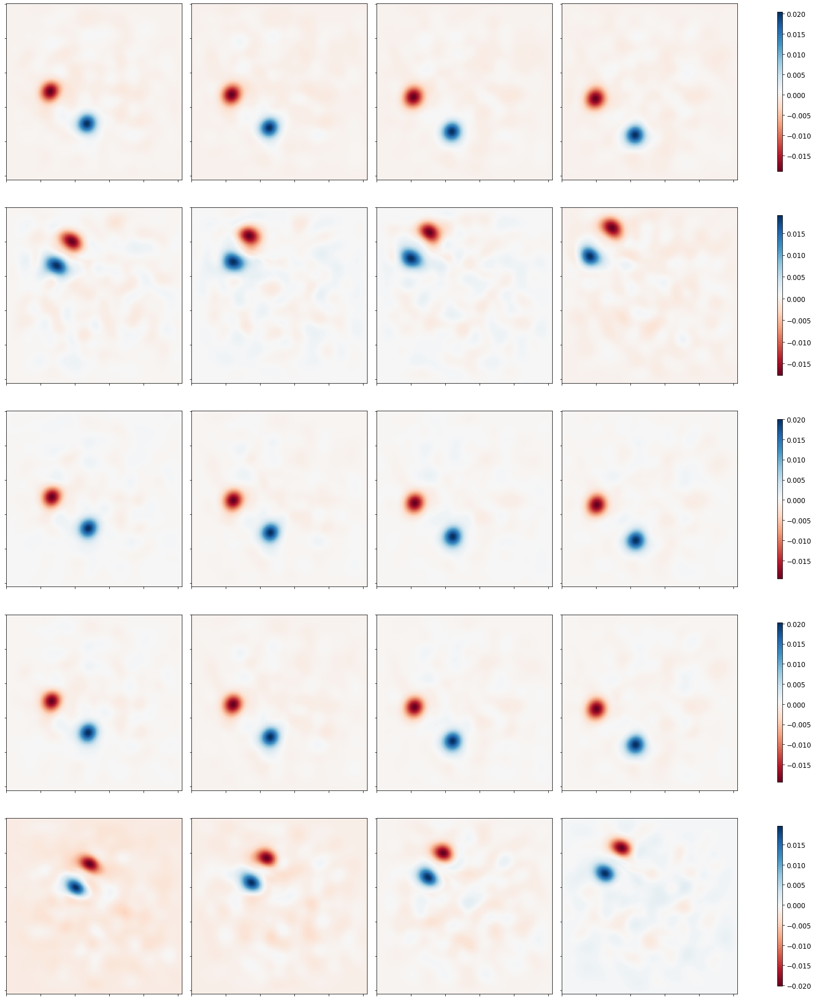

Loss: 


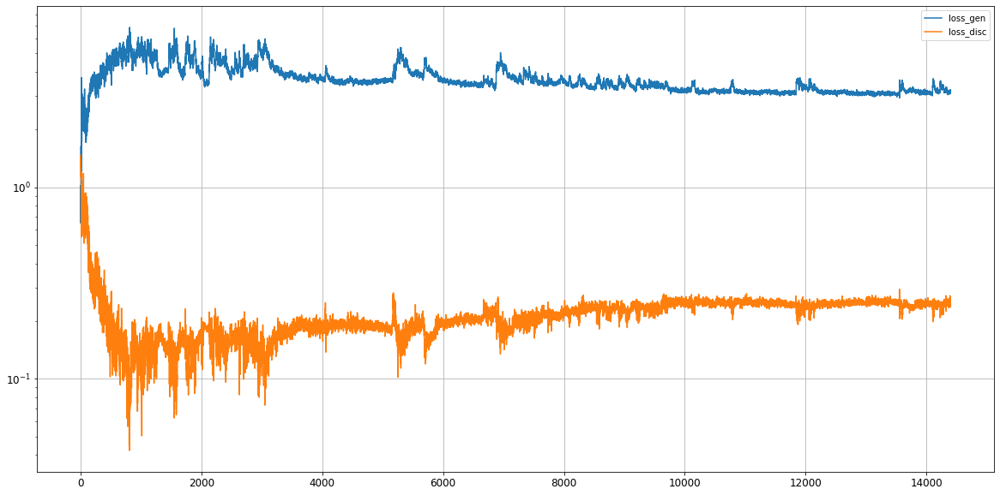

Epoch 14402/50000
discriminator loss:  0.245247 - generator loss:  3.180223 - 3s
Epoch 14403/50000
discriminator loss:  0.242622 - generator loss:  3.250556 - 3s
Epoch 14404/50000
discriminator loss:  0.250968 - generator loss:  3.231119 - 3s
Epoch 14405/50000
discriminator loss:  0.235070 - generator loss:  3.245481 - 3s
Epoch 14406/50000
discriminator loss:  0.243436 - generator loss:  3.173062 - 3s
Epoch 14407/50000
discriminator loss:  0.250604 - generator loss:  3.180510 - 3s
Epoch 14408/50000
discriminator loss:  0.248091 - generator loss:  3.216831 - 3s
Epoch 14409/50000
discriminator loss:  0.254857 - generator loss:  3.136299 - 3s
Epoch 14410/50000
discriminator loss:  0.255297 - generator loss:  3.118003 - 3s
Epoch 14411/50000
discriminator loss:  0.251365 - generator loss:  3.185372 - 3s
Epoch 14412/50000
discriminator loss:  0.249048 - generator loss:  3.165015 - 3s
Epoch 14413/50000
discriminator loss:  0.237660 - generator loss:  3.185696 - 3s
Epoch 14414/50000
discrimina

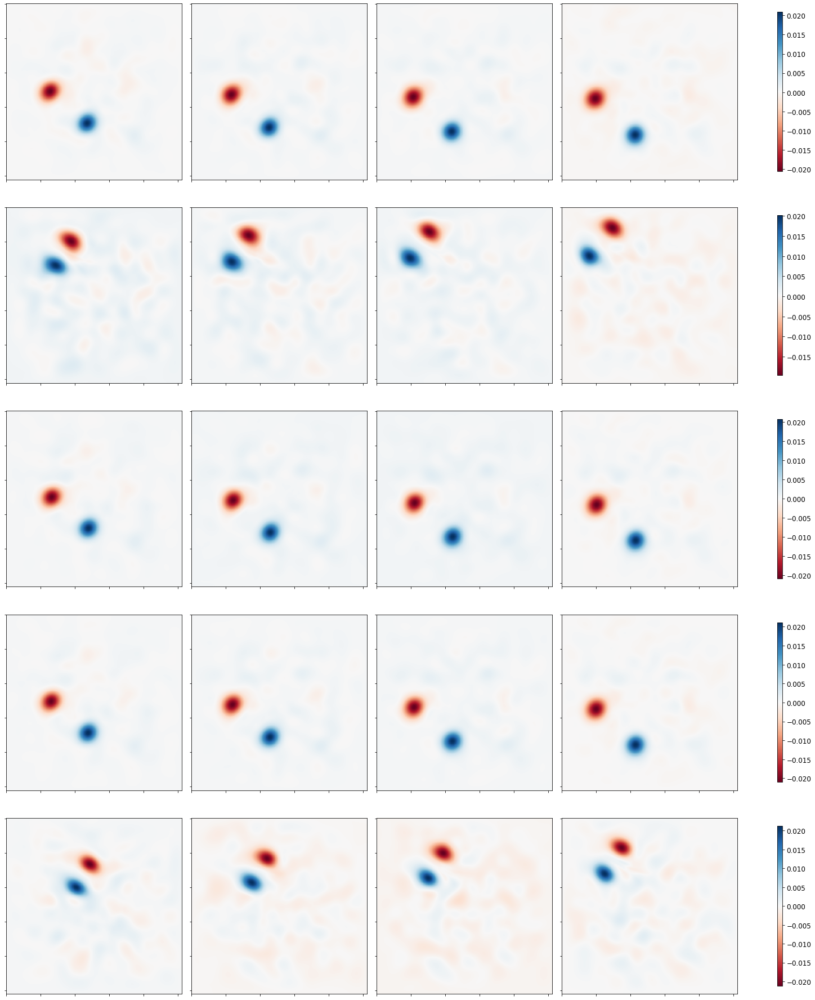

Loss: 


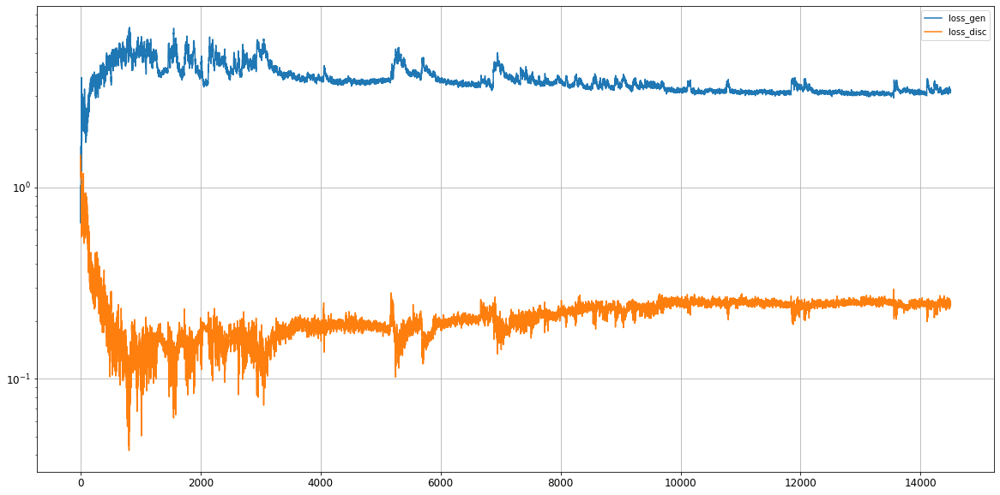

Epoch 14502/50000
discriminator loss:  0.246077 - generator loss:  3.147831 - 3s
Epoch 14503/50000
discriminator loss:  0.243749 - generator loss:  3.215193 - 3s
Epoch 14504/50000
discriminator loss:  0.251904 - generator loss:  3.097431 - 3s
Epoch 14505/50000
discriminator loss:  0.245214 - generator loss:  3.197208 - 3s
Epoch 14506/50000
discriminator loss:  0.251771 - generator loss:  3.116421 - 3s
Epoch 14507/50000
discriminator loss:  0.250601 - generator loss:  3.126313 - 3s
Epoch 14508/50000
discriminator loss:  0.241563 - generator loss:  3.182691 - 3s
Epoch 14509/50000
discriminator loss:  0.246339 - generator loss:  3.173528 - 3s
Epoch 14510/50000
discriminator loss:  0.246203 - generator loss:  3.104435 - 3s
Epoch 14511/50000
discriminator loss:  0.242313 - generator loss:  3.187987 - 3s
Epoch 14512/50000
discriminator loss:  0.247999 - generator loss:  3.103585 - 3s
Epoch 14513/50000
discriminator loss:  0.252273 - generator loss:  3.151133 - 3s
Epoch 14514/50000
discrimina

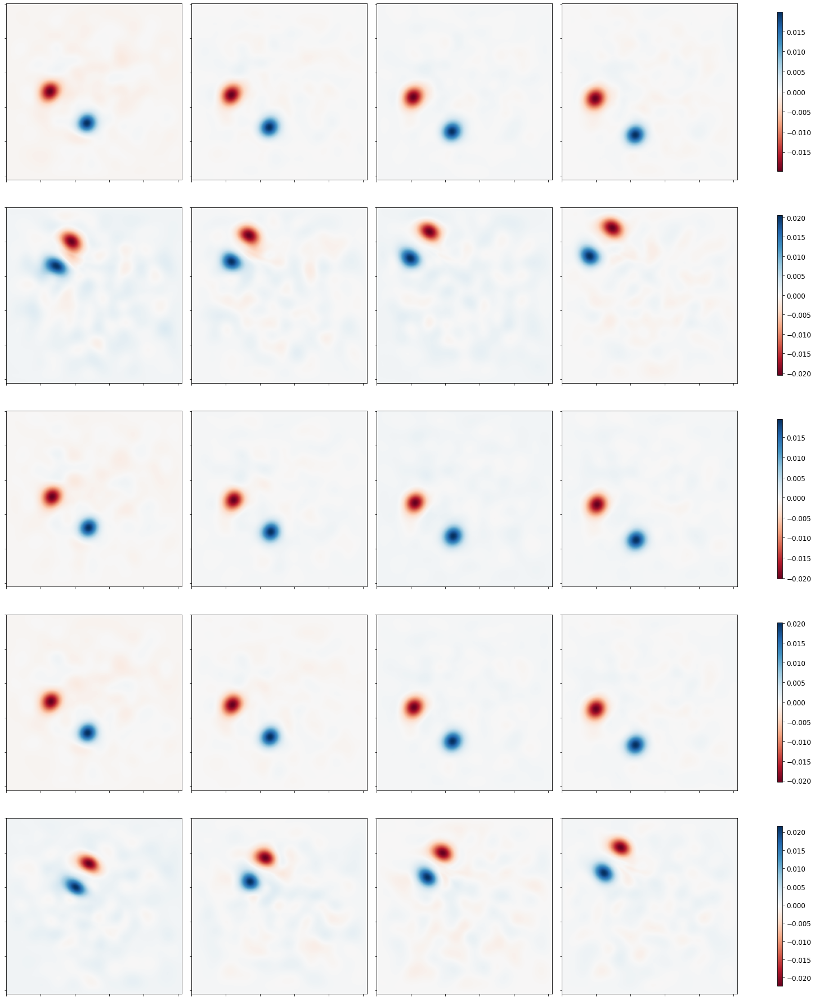

Loss: 


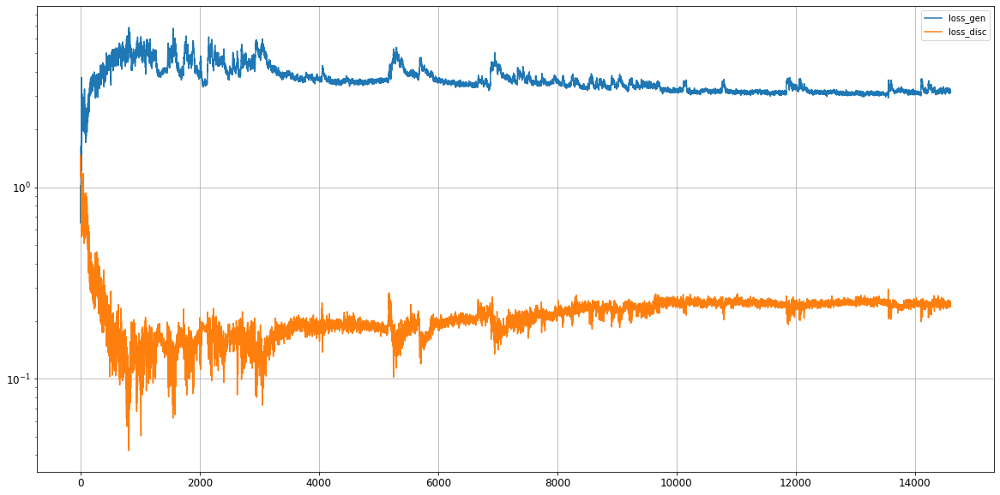

Epoch 14602/50000
discriminator loss:  0.235235 - generator loss:  3.268919 - 3s
Epoch 14603/50000
discriminator loss:  0.254831 - generator loss:  3.141519 - 3s
Epoch 14604/50000
discriminator loss:  0.244193 - generator loss:  3.139790 - 3s
Epoch 14605/50000
discriminator loss:  0.240274 - generator loss:  3.220747 - 3s
Epoch 14606/50000
discriminator loss:  0.248879 - generator loss:  3.085817 - 3s
Epoch 14607/50000
discriminator loss:  0.247013 - generator loss:  3.151006 - 3s
Epoch 14608/50000
discriminator loss:  0.244634 - generator loss:  3.184362 - 3s
Epoch 14609/50000
discriminator loss:  0.246215 - generator loss:  3.109778 - 3s
Epoch 14610/50000
discriminator loss:  0.253013 - generator loss:  3.128381 - 3s
Epoch 14611/50000
discriminator loss:  0.253204 - generator loss:  3.084340 - 3s
Epoch 14612/50000
discriminator loss:  0.243867 - generator loss:  3.118556 - 3s
Epoch 14613/50000
discriminator loss:  0.253760 - generator loss:  3.119840 - 3s
Epoch 14614/50000
discrimina

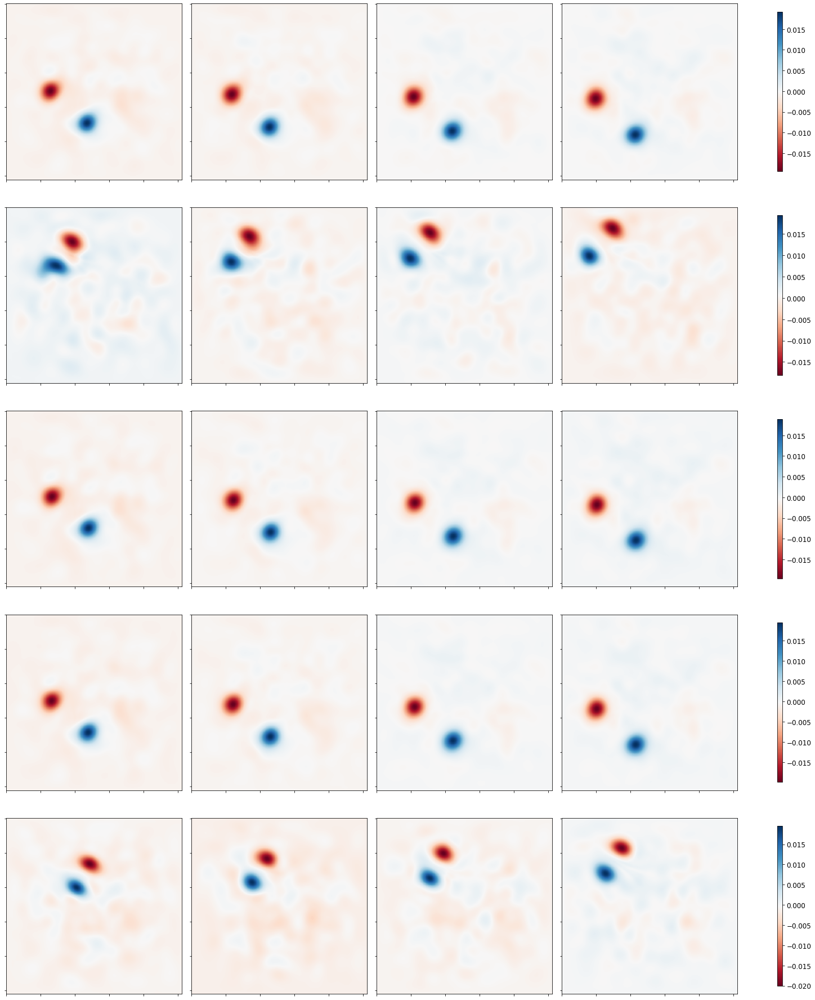

Loss: 


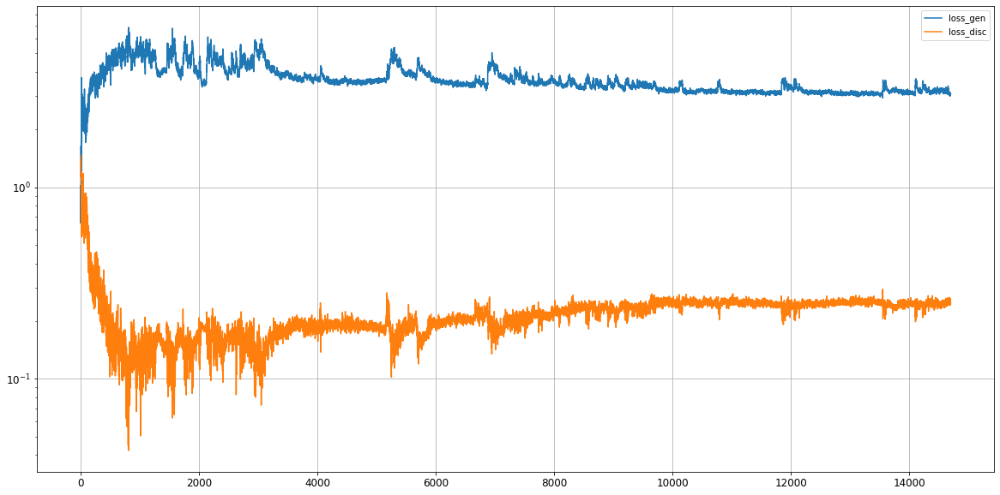

Epoch 14702/50000
discriminator loss:  0.248668 - generator loss:  3.063776 - 3s
Epoch 14703/50000
discriminator loss:  0.258011 - generator loss:  3.114875 - 3s
Epoch 14704/50000
discriminator loss:  0.248494 - generator loss:  3.070616 - 3s
Epoch 14705/50000
discriminator loss:  0.259167 - generator loss:  3.074380 - 3s
Epoch 14706/50000
discriminator loss:  0.261674 - generator loss:  3.105678 - 3s
Epoch 14707/50000
discriminator loss:  0.253270 - generator loss:  3.075228 - 3s
Epoch 14708/50000
discriminator loss:  0.253293 - generator loss:  3.132112 - 3s
Epoch 14709/50000
discriminator loss:  0.260222 - generator loss:  3.082669 - 3s
Epoch 14710/50000
discriminator loss:  0.249268 - generator loss:  3.091159 - 3s
Epoch 14711/50000
discriminator loss:  0.253718 - generator loss:  3.066545 - 3s
Epoch 14712/50000
discriminator loss:  0.259452 - generator loss:  3.063951 - 3s
Epoch 14713/50000
discriminator loss:  0.263588 - generator loss:  3.069331 - 3s
Epoch 14714/50000
discrimina

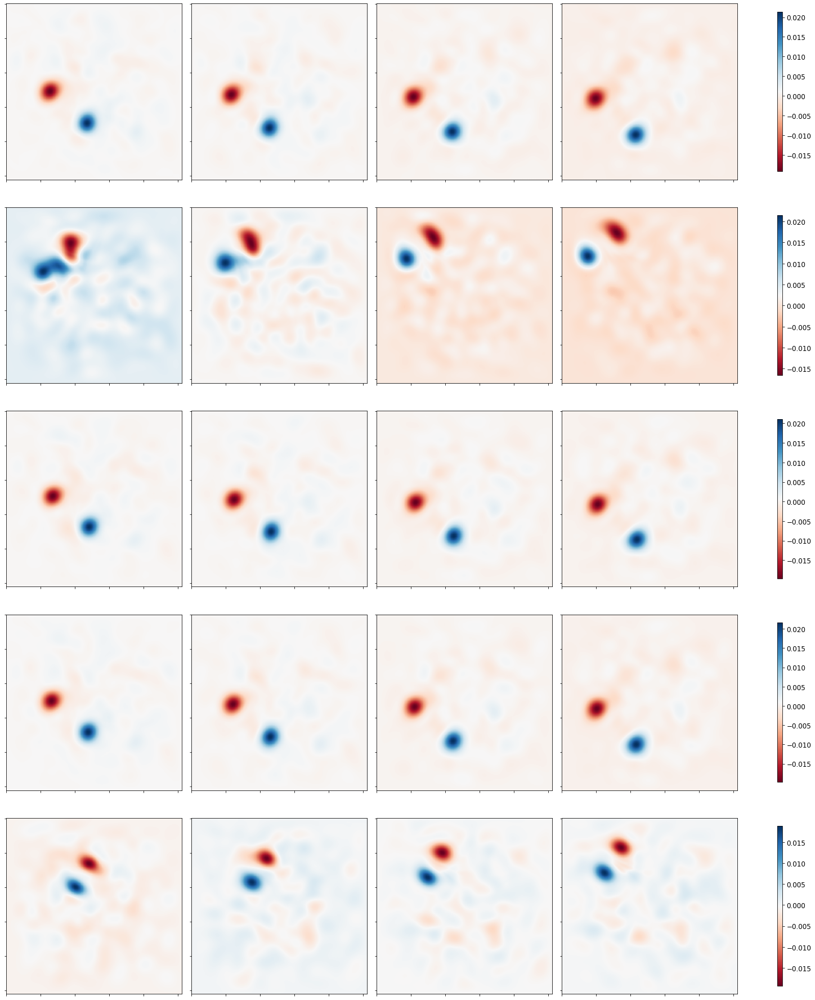

Loss: 


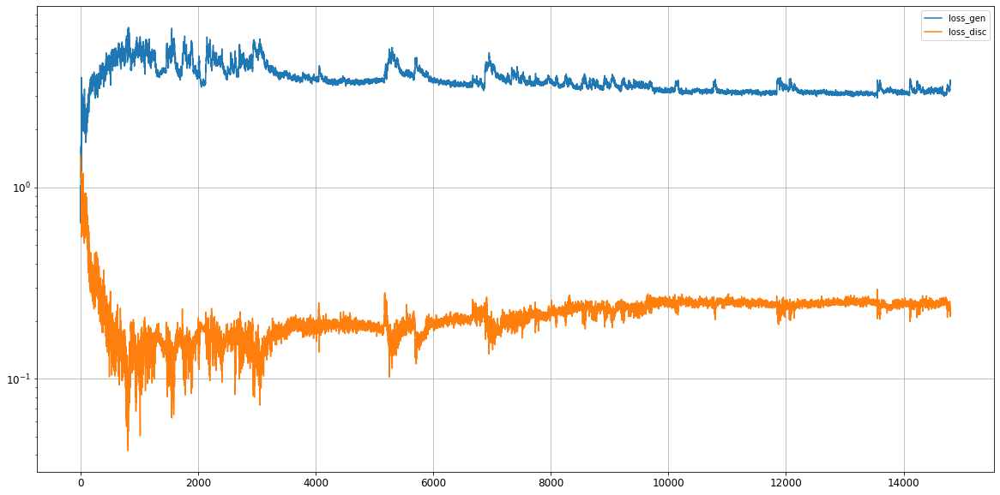

Epoch 14802/50000
discriminator loss:  0.203752 - generator loss:  3.611136 - 3s
Epoch 14803/50000
discriminator loss:  0.215669 - generator loss:  3.630293 - 3s
Epoch 14804/50000
discriminator loss:  0.225243 - generator loss:  3.530526 - 3s
Epoch 14805/50000
discriminator loss:  0.211930 - generator loss:  3.651843 - 3s
Epoch 14806/50000
discriminator loss:  0.220257 - generator loss:  3.580017 - 3s
Epoch 14807/50000
discriminator loss:  0.233790 - generator loss:  3.478025 - 3s
Epoch 14808/50000
discriminator loss:  0.227183 - generator loss:  3.401058 - 3s
Epoch 14809/50000
discriminator loss:  0.220322 - generator loss:  3.547641 - 3s
Epoch 14810/50000
discriminator loss:  0.231377 - generator loss:  3.411732 - 3s
Epoch 14811/50000
discriminator loss:  0.233992 - generator loss:  3.346653 - 3s
Epoch 14812/50000
discriminator loss:  0.224207 - generator loss:  3.366542 - 3s
Epoch 14813/50000
discriminator loss:  0.226691 - generator loss:  3.428194 - 3s
Epoch 14814/50000
discrimina

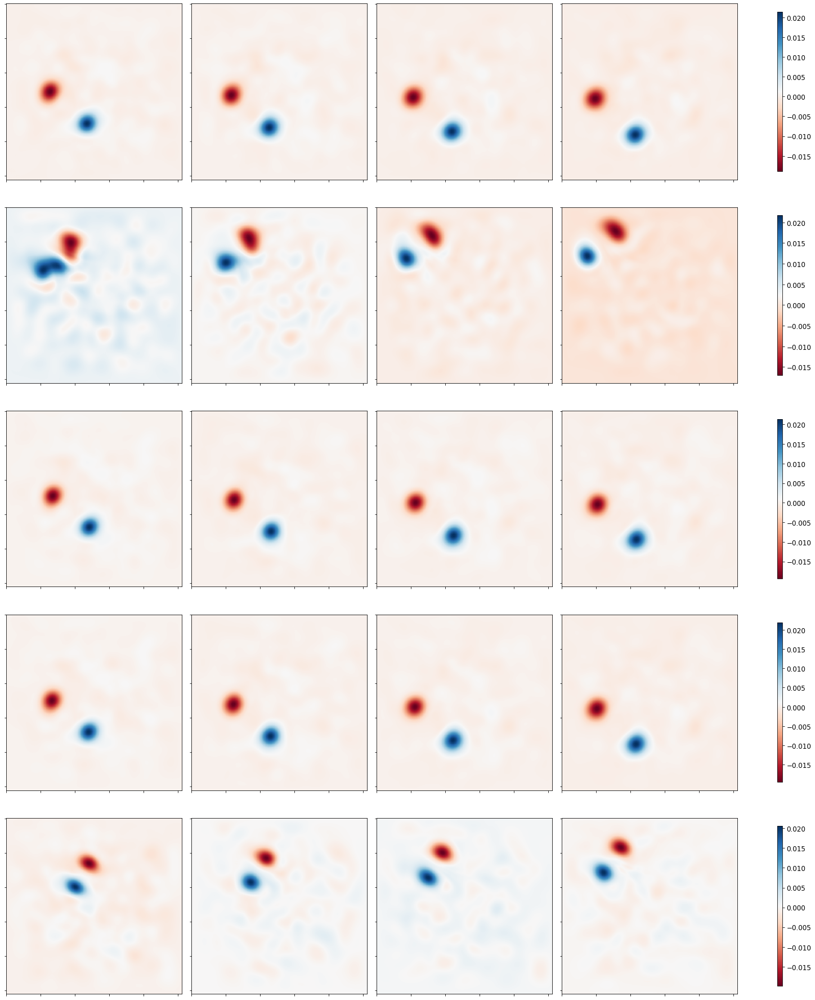

Loss: 


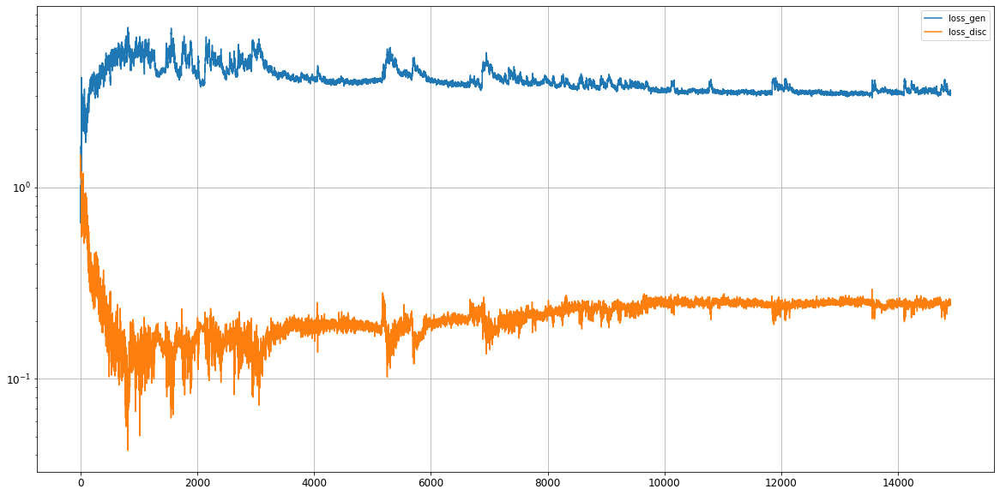

Epoch 14902/50000
discriminator loss:  0.255911 - generator loss:  3.117010 - 3s
Epoch 14903/50000
discriminator loss:  0.259345 - generator loss:  2.982064 - 3s
Epoch 14904/50000
discriminator loss:  0.243917 - generator loss:  3.113790 - 3s
Epoch 14905/50000
discriminator loss:  0.250601 - generator loss:  3.076491 - 3s
Epoch 14906/50000
discriminator loss:  0.250791 - generator loss:  3.089267 - 3s
Epoch 14907/50000
discriminator loss:  0.244548 - generator loss:  3.067880 - 3s
Epoch 14908/50000
discriminator loss:  0.250776 - generator loss:  3.047329 - 3s
Epoch 14909/50000
discriminator loss:  0.250281 - generator loss:  3.086052 - 3s
Epoch 14910/50000
discriminator loss:  0.252594 - generator loss:  3.061222 - 3s
Epoch 14911/50000
discriminator loss:  0.256406 - generator loss:  3.022662 - 3s
Epoch 14912/50000
discriminator loss:  0.245826 - generator loss:  3.152612 - 3s
Epoch 14913/50000
discriminator loss:  0.247972 - generator loss:  3.051692 - 3s
Epoch 14914/50000
discrimina

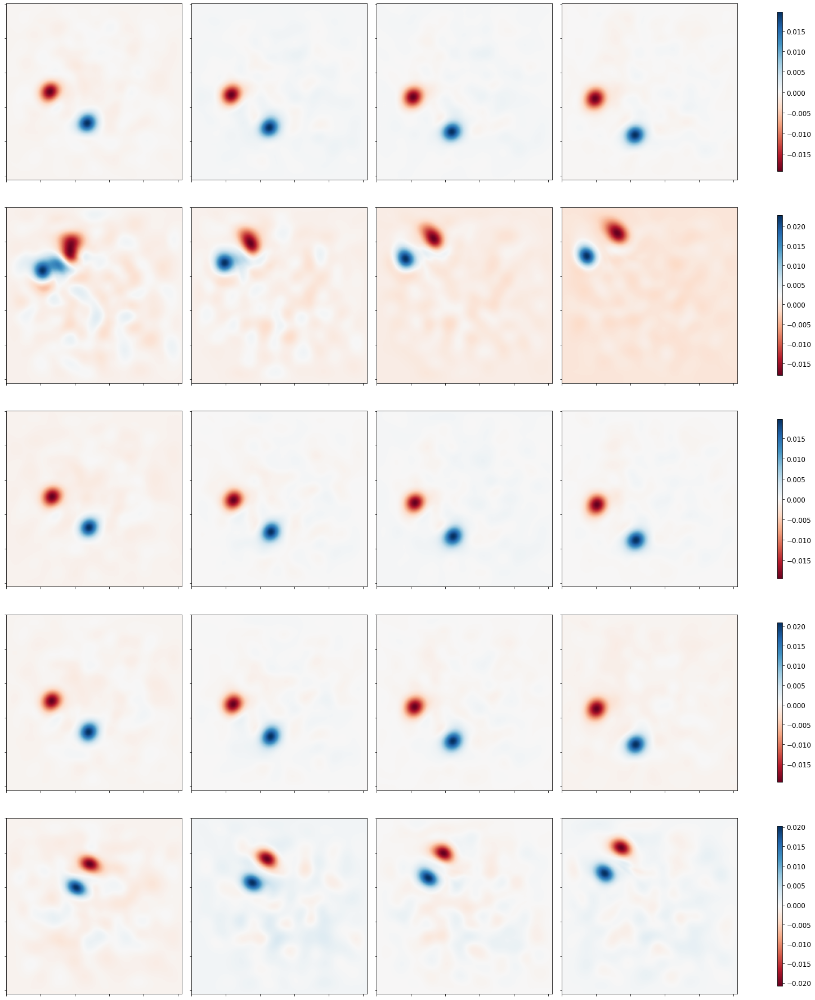

Loss: 


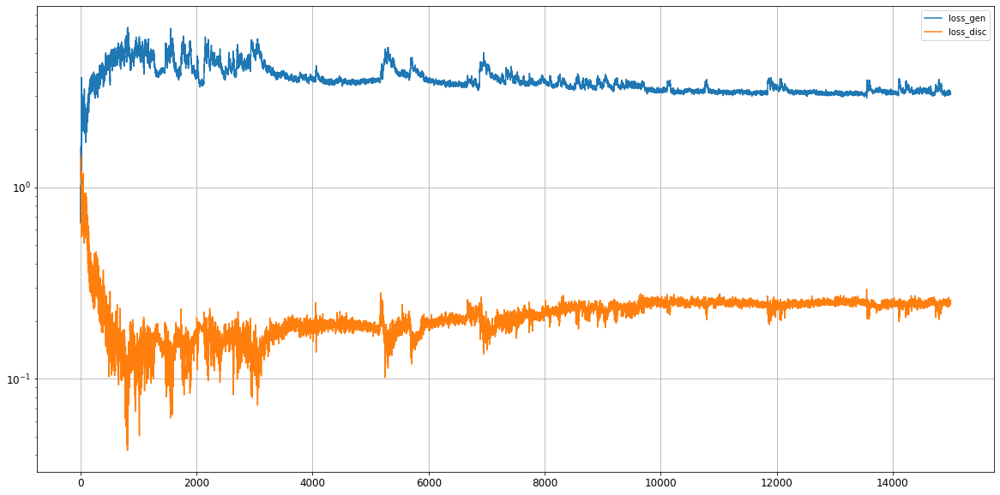

Epoch 15002/50000
discriminator loss:  0.245452 - generator loss:  3.074991 - 3s
Epoch 15003/50000
discriminator loss:  0.248507 - generator loss:  3.128340 - 3s
Epoch 15004/50000
discriminator loss:  0.247431 - generator loss:  3.116268 - 3s
Epoch 15005/50000
discriminator loss:  0.245780 - generator loss:  3.066875 - 3s
Epoch 15006/50000
discriminator loss:  0.252150 - generator loss:  3.060521 - 3s
Epoch 15007/50000
discriminator loss:  0.250126 - generator loss:  3.142122 - 3s
Epoch 15008/50000
discriminator loss:  0.252292 - generator loss:  3.040283 - 3s
Epoch 15009/50000
discriminator loss:  0.247229 - generator loss:  3.127266 - 3s
Epoch 15010/50000
discriminator loss:  0.246111 - generator loss:  3.112002 - 3s
Epoch 15011/50000
discriminator loss:  0.245717 - generator loss:  3.080426 - 3s
Epoch 15012/50000
discriminator loss:  0.251278 - generator loss:  3.184175 - 3s
Epoch 15013/50000
discriminator loss:  0.250527 - generator loss:  3.099490 - 3s
Epoch 15014/50000
discrimina

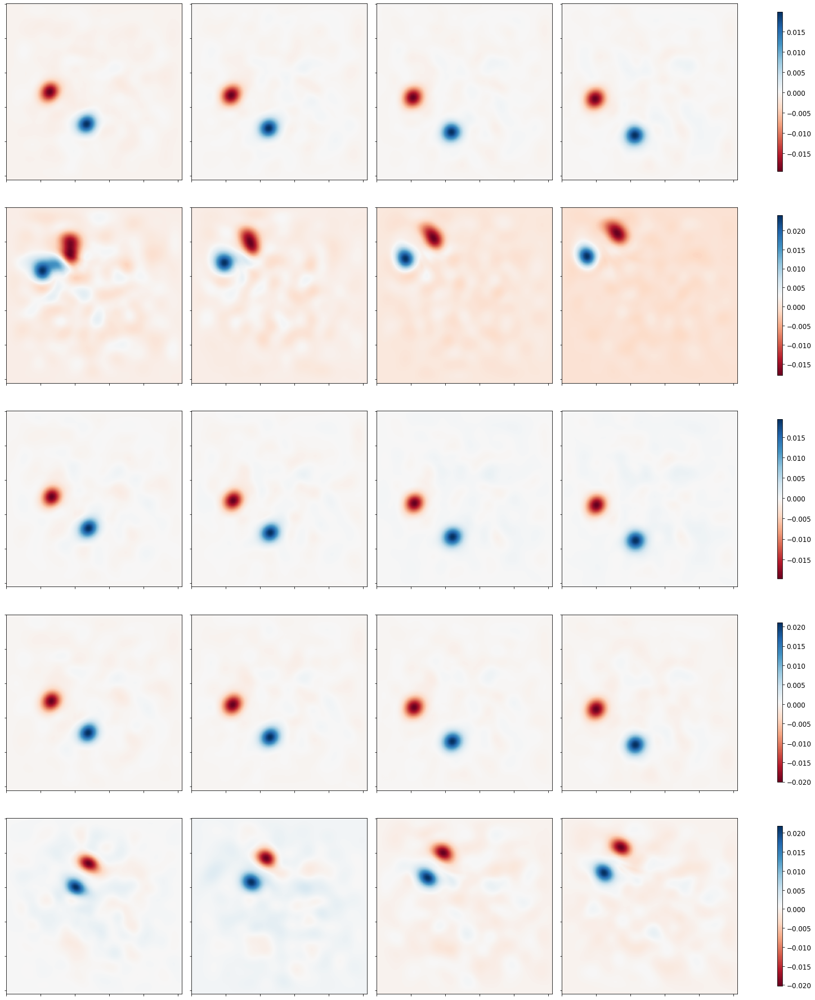

Loss: 


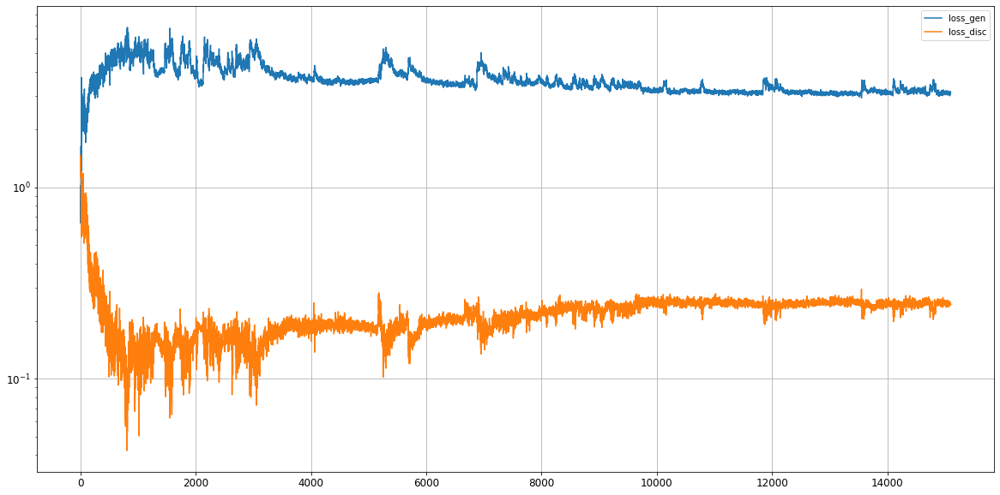

Epoch 15102/50000
discriminator loss:  0.246883 - generator loss:  3.086816 - 3s
Epoch 15103/50000
discriminator loss:  0.246908 - generator loss:  3.154304 - 3s
Epoch 15104/50000
discriminator loss:  0.243407 - generator loss:  3.120394 - 3s
Epoch 15105/50000
discriminator loss:  0.245570 - generator loss:  3.115118 - 3s
Epoch 15106/50000
discriminator loss:  0.239771 - generator loss:  3.105965 - 3s
Epoch 15107/50000
discriminator loss:  0.235963 - generator loss:  3.066225 - 3s
Epoch 15108/50000
discriminator loss:  0.253403 - generator loss:  3.150063 - 3s
Epoch 15109/50000
discriminator loss:  0.251191 - generator loss:  3.133061 - 3s
Epoch 15110/50000
discriminator loss:  0.240970 - generator loss:  3.088089 - 3s
Epoch 15111/50000
discriminator loss:  0.249701 - generator loss:  3.120664 - 3s
Epoch 15112/50000
discriminator loss:  0.250855 - generator loss:  3.062265 - 3s
Epoch 15113/50000
discriminator loss:  0.242018 - generator loss:  3.099181 - 3s
Epoch 15114/50000
discrimina

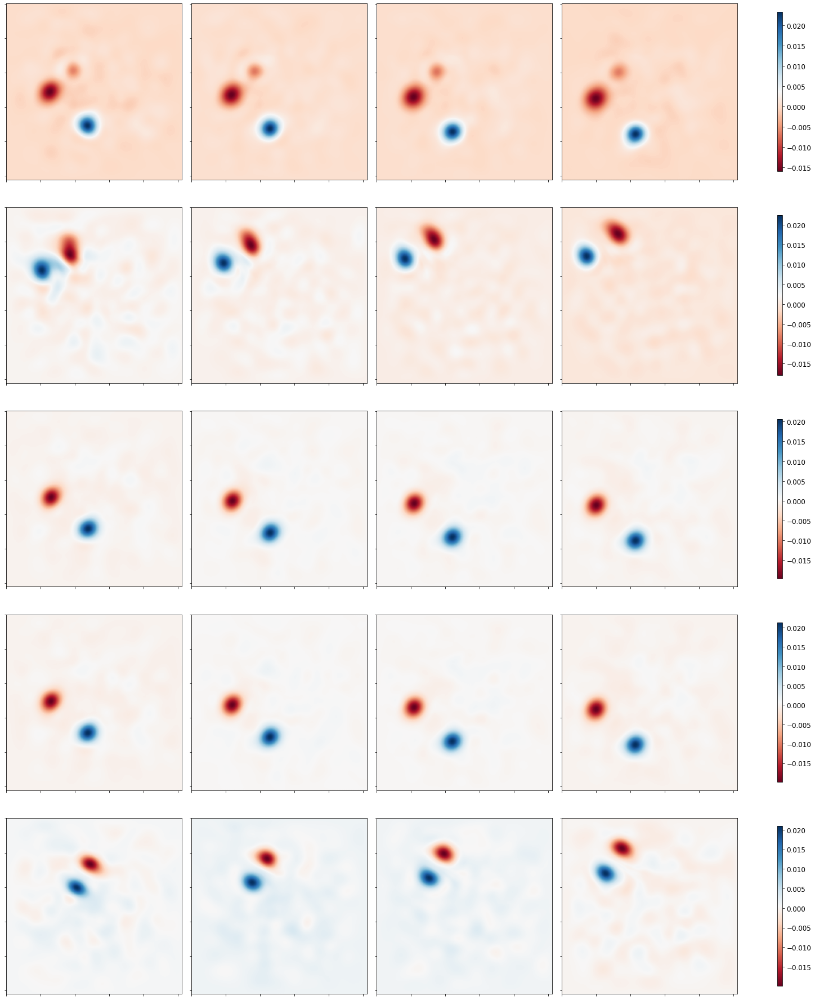

Loss: 


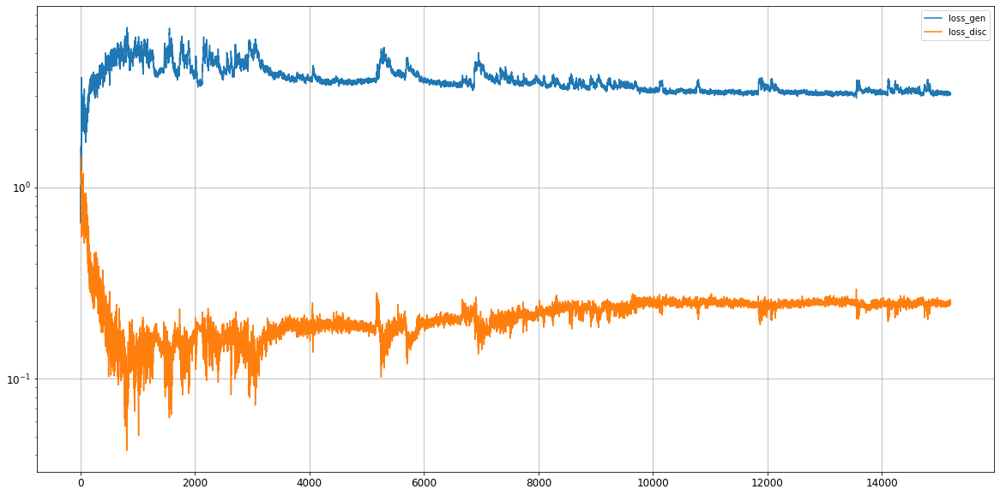

Epoch 15202/50000
discriminator loss:  0.240042 - generator loss:  3.107362 - 3s
Epoch 15203/50000
discriminator loss:  0.249826 - generator loss:  3.060562 - 3s
Epoch 15204/50000
discriminator loss:  0.254067 - generator loss:  3.062964 - 3s
Epoch 15205/50000
discriminator loss:  0.252171 - generator loss:  3.068742 - 3s
Epoch 15206/50000
discriminator loss:  0.252187 - generator loss:  3.093174 - 3s
Epoch 15207/50000
discriminator loss:  0.256878 - generator loss:  3.043140 - 3s
Epoch 15208/50000
discriminator loss:  0.245379 - generator loss:  3.124640 - 3s
Epoch 15209/50000
discriminator loss:  0.244537 - generator loss:  3.073493 - 3s
Epoch 15210/50000
discriminator loss:  0.256104 - generator loss:  3.152571 - 3s
Epoch 15211/50000
discriminator loss:  0.245975 - generator loss:  3.045504 - 3s
Epoch 15212/50000
discriminator loss:  0.255244 - generator loss:  3.077197 - 3s
Epoch 15213/50000
discriminator loss:  0.243367 - generator loss:  3.098965 - 3s
Epoch 15214/50000
discrimina

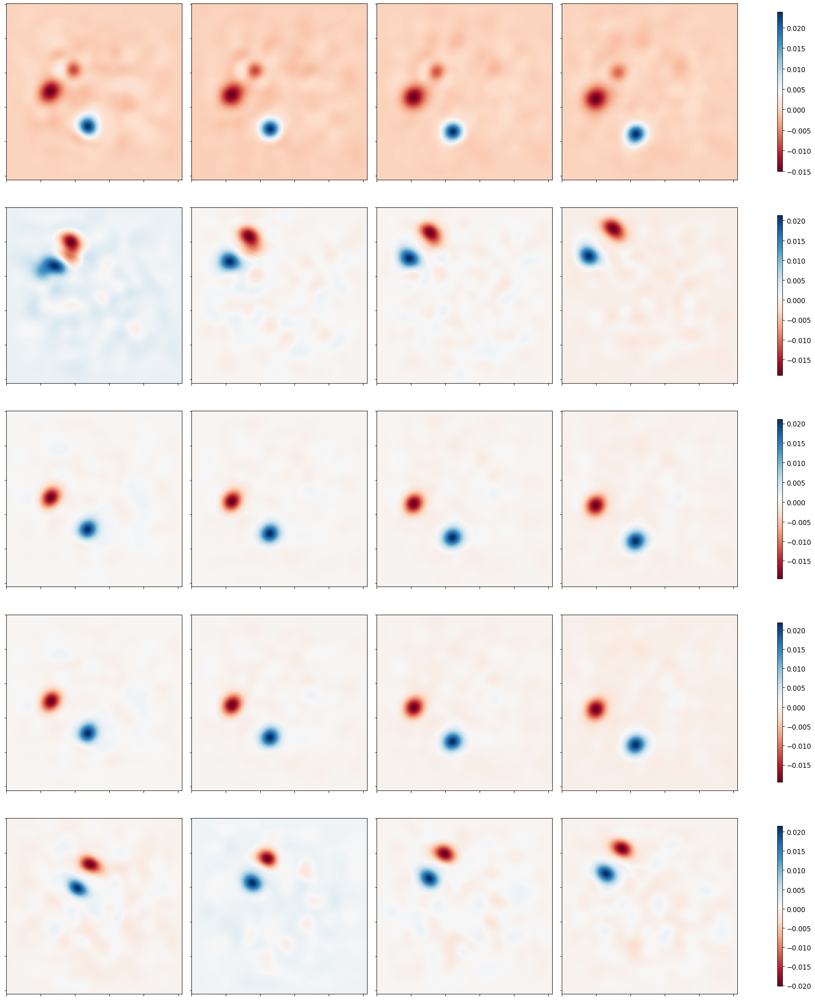

Loss: 


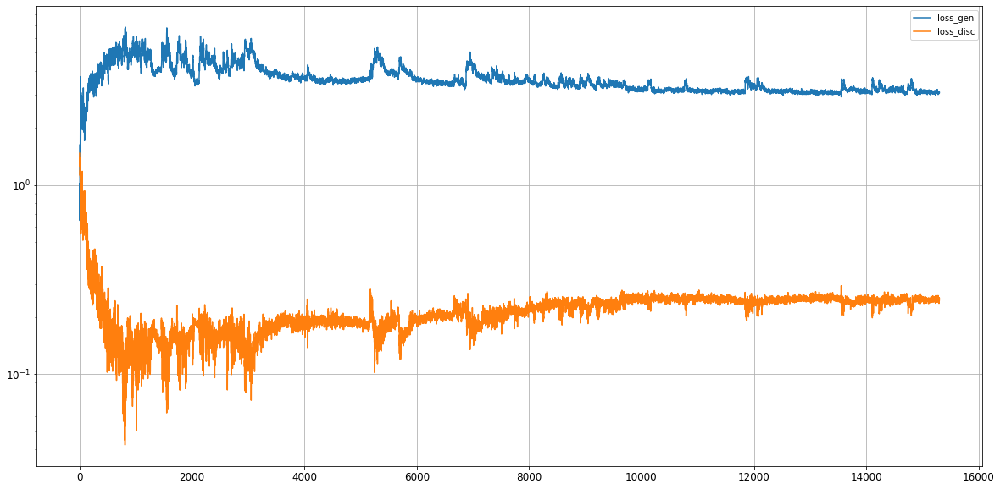

Epoch 15302/50000
discriminator loss:  0.255366 - generator loss:  3.041173 - 3s
Epoch 15303/50000
discriminator loss:  0.243814 - generator loss:  3.093991 - 3s
Epoch 15304/50000
discriminator loss:  0.254029 - generator loss:  3.080133 - 3s
Epoch 15305/50000
discriminator loss:  0.245474 - generator loss:  3.104292 - 3s
Epoch 15306/50000
discriminator loss:  0.249597 - generator loss:  3.091703 - 3s
Epoch 15307/50000
discriminator loss:  0.247594 - generator loss:  3.054491 - 3s
Epoch 15308/50000
discriminator loss:  0.259243 - generator loss:  3.136735 - 3s
Epoch 15309/50000
discriminator loss:  0.248765 - generator loss:  3.033426 - 3s
Epoch 15310/50000
discriminator loss:  0.250086 - generator loss:  3.086140 - 3s
Epoch 15311/50000
discriminator loss:  0.258372 - generator loss:  3.034951 - 3s
Epoch 15312/50000
discriminator loss:  0.256631 - generator loss:  3.071734 - 3s
Epoch 15313/50000
discriminator loss:  0.244650 - generator loss:  3.086842 - 3s
Epoch 15314/50000
discrimina

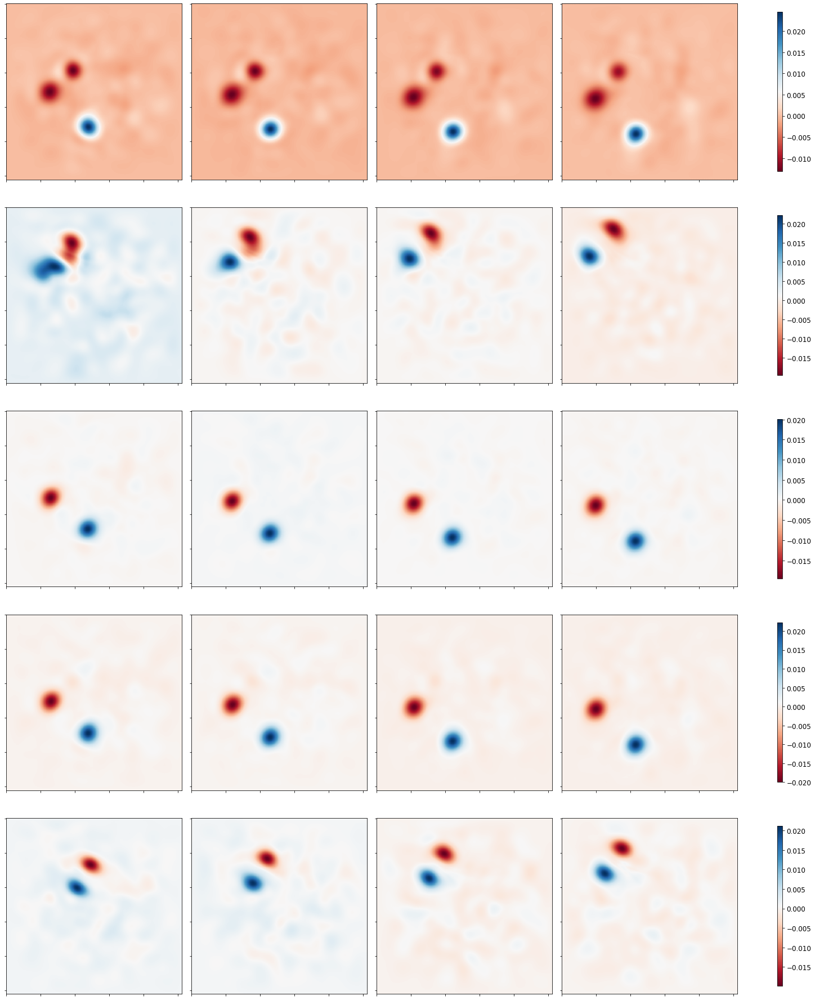

Loss: 


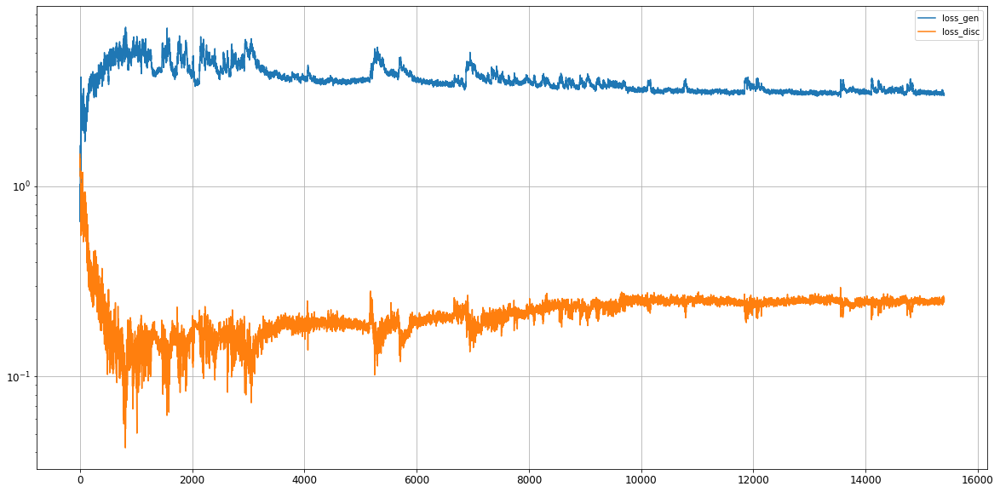

Epoch 15402/50000
discriminator loss:  0.250372 - generator loss:  3.068519 - 3s
Epoch 15403/50000
discriminator loss:  0.246501 - generator loss:  3.081345 - 3s
Epoch 15404/50000
discriminator loss:  0.245928 - generator loss:  3.041381 - 3s
Epoch 15405/50000
discriminator loss:  0.244956 - generator loss:  3.062607 - 3s
Epoch 15406/50000
discriminator loss:  0.253664 - generator loss:  3.025520 - 3s
Epoch 15407/50000
discriminator loss:  0.256185 - generator loss:  3.066029 - 3s
Epoch 15408/50000
discriminator loss:  0.257485 - generator loss:  2.995465 - 3s
Epoch 15409/50000
discriminator loss:  0.252616 - generator loss:  3.079008 - 3s
Epoch 15410/50000
discriminator loss:  0.247154 - generator loss:  2.981473 - 3s
Epoch 15411/50000
discriminator loss:  0.256952 - generator loss:  3.061340 - 3s
Epoch 15412/50000
discriminator loss:  0.247541 - generator loss:  3.013695 - 3s
Epoch 15413/50000
discriminator loss:  0.257158 - generator loss:  3.042941 - 3s
Epoch 15414/50000
discrimina

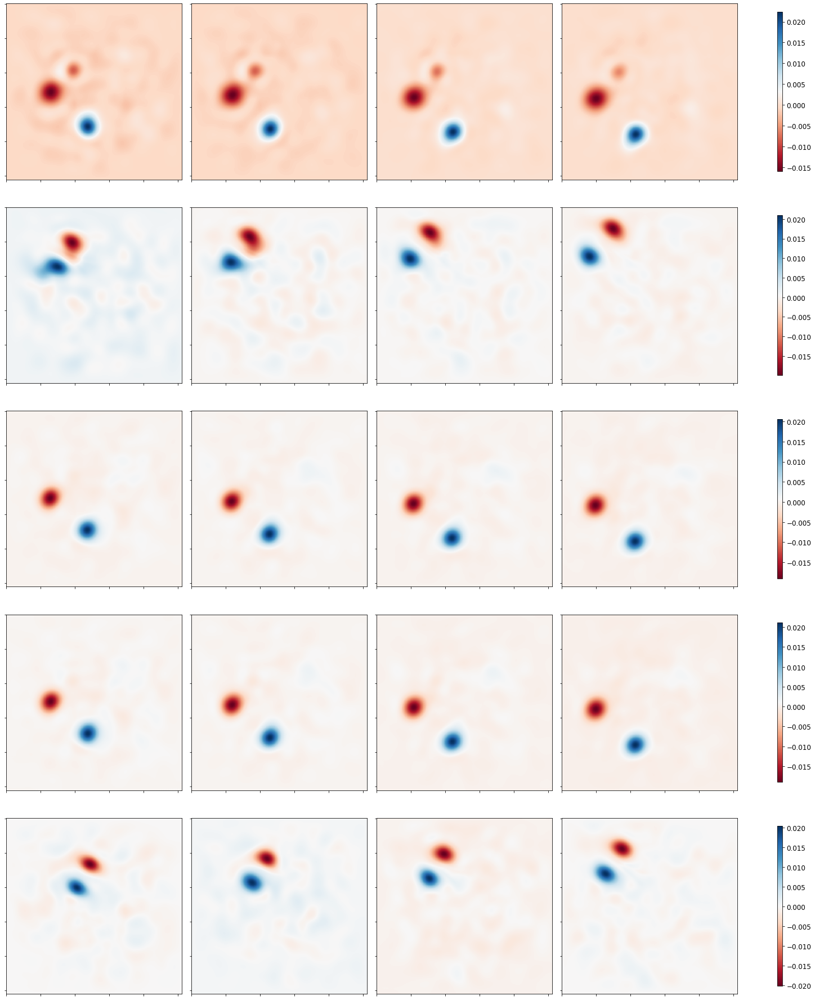

Loss: 


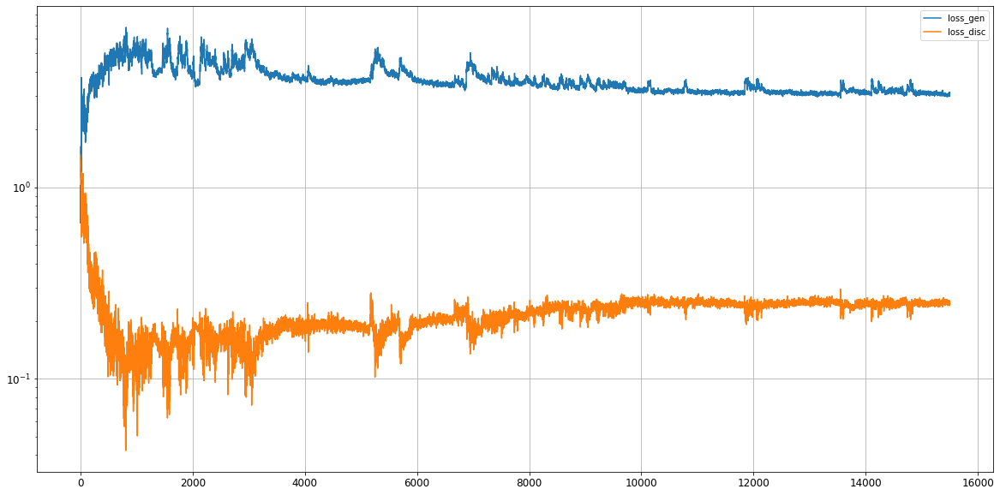

Epoch 15502/50000
discriminator loss:  0.260463 - generator loss:  3.004495 - 3s
Epoch 15503/50000
discriminator loss:  0.256925 - generator loss:  3.028791 - 3s
Epoch 15504/50000
discriminator loss:  0.251301 - generator loss:  3.027981 - 3s
Epoch 15505/50000
discriminator loss:  0.249347 - generator loss:  3.040274 - 3s
Epoch 15506/50000
discriminator loss:  0.248606 - generator loss:  3.050827 - 3s
Epoch 15507/50000
discriminator loss:  0.240739 - generator loss:  3.026838 - 3s
Epoch 15508/50000
discriminator loss:  0.251164 - generator loss:  3.103840 - 3s
Epoch 15509/50000
discriminator loss:  0.256462 - generator loss:  3.098418 - 3s
Epoch 15510/50000
discriminator loss:  0.247576 - generator loss:  2.984648 - 3s
Epoch 15511/50000
discriminator loss:  0.249492 - generator loss:  3.042523 - 3s
Epoch 15512/50000
discriminator loss:  0.245535 - generator loss:  3.011991 - 3s
Epoch 15513/50000
discriminator loss:  0.250818 - generator loss:  3.021973 - 3s
Epoch 15514/50000
discrimina

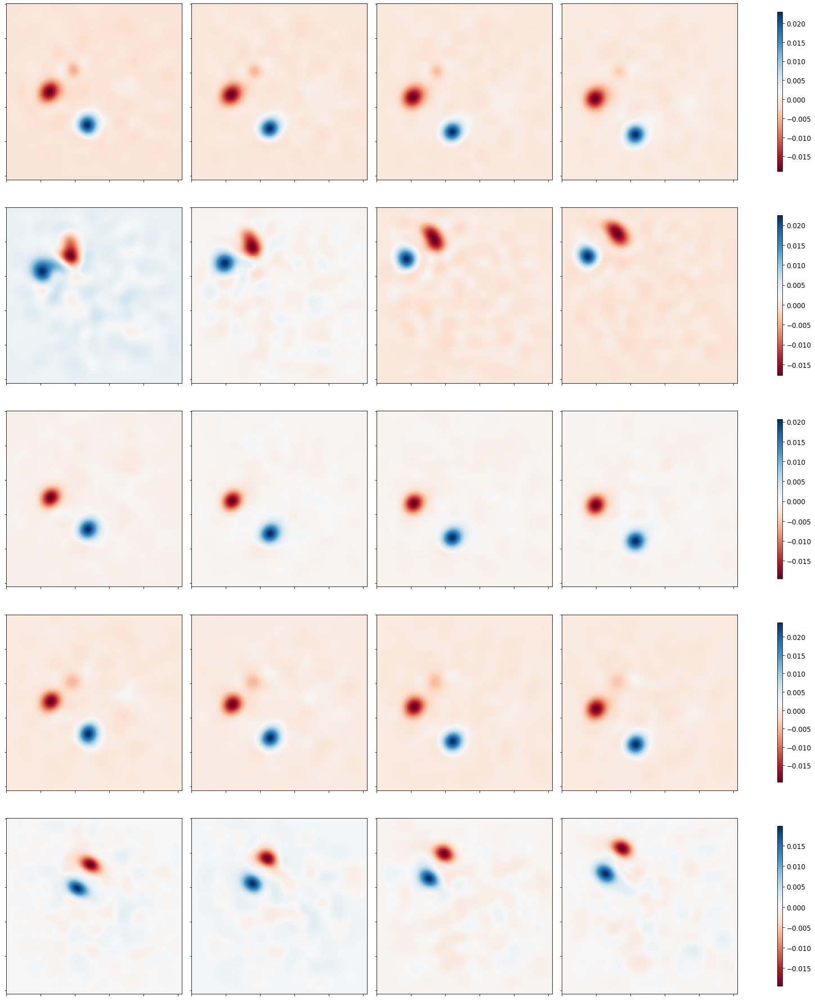

Loss: 


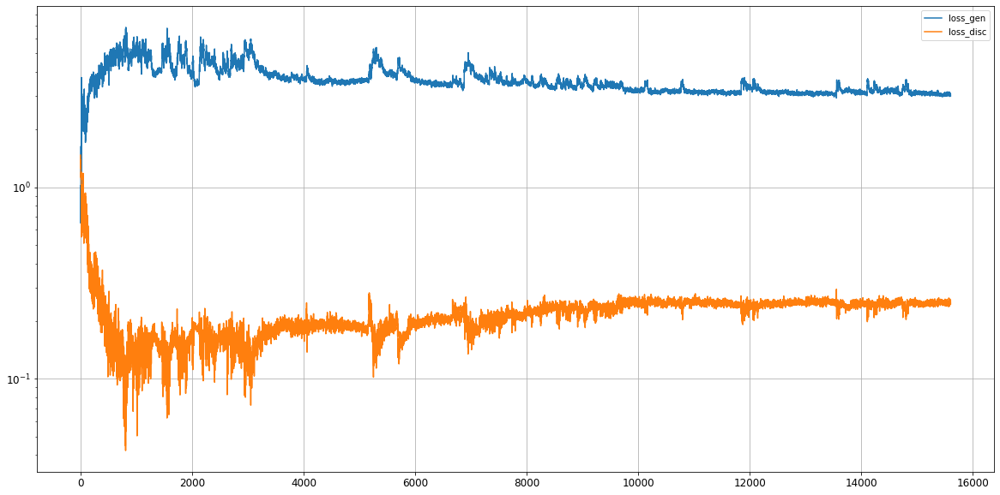

Epoch 15602/50000
discriminator loss:  0.254735 - generator loss:  3.109529 - 3s
Epoch 15603/50000
discriminator loss:  0.244357 - generator loss:  3.023051 - 3s
Epoch 15604/50000
discriminator loss:  0.246860 - generator loss:  3.047523 - 3s
Epoch 15605/50000
discriminator loss:  0.251781 - generator loss:  3.064621 - 3s
Epoch 15606/50000
discriminator loss:  0.249642 - generator loss:  3.030772 - 3s
Epoch 15607/50000
discriminator loss:  0.246134 - generator loss:  3.039178 - 3s
Epoch 15608/50000
discriminator loss:  0.248786 - generator loss:  3.053357 - 3s
Epoch 15609/50000
discriminator loss:  0.255083 - generator loss:  3.025842 - 3s
Epoch 15610/50000
discriminator loss:  0.251919 - generator loss:  3.048997 - 3s
Epoch 15611/50000
discriminator loss:  0.251363 - generator loss:  3.038995 - 3s
Epoch 15612/50000
discriminator loss:  0.248306 - generator loss:  3.087043 - 3s
Epoch 15613/50000
discriminator loss:  0.249764 - generator loss:  3.053399 - 3s
Epoch 15614/50000
discrimina

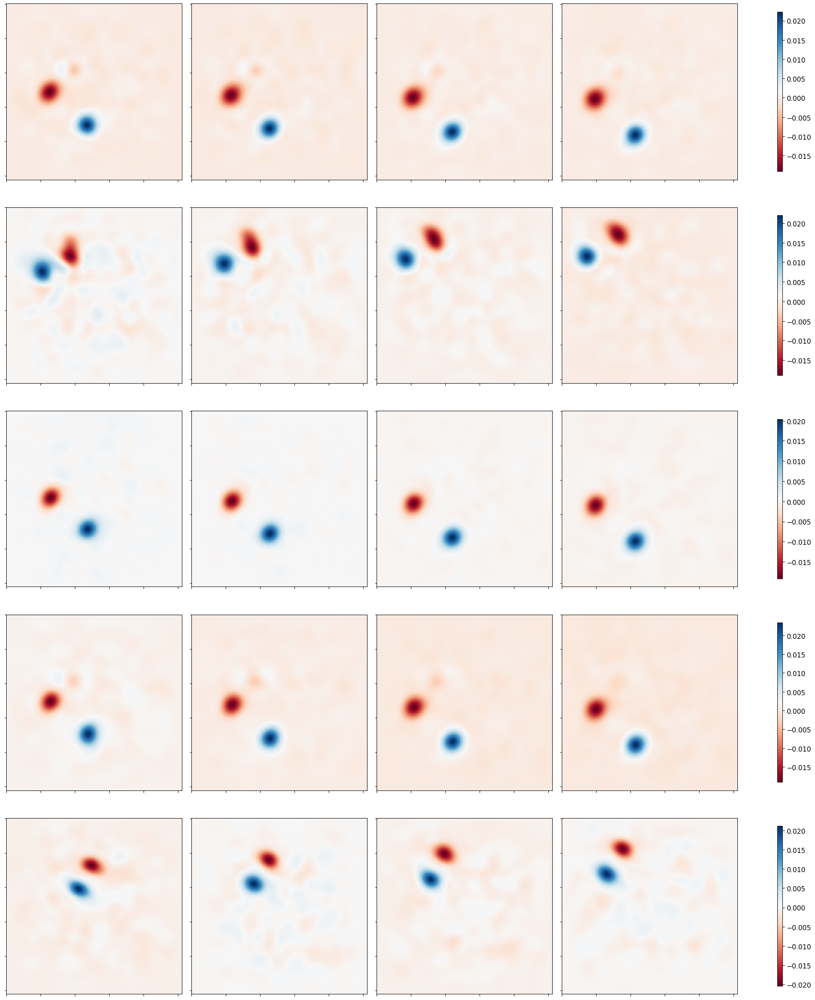

Loss: 


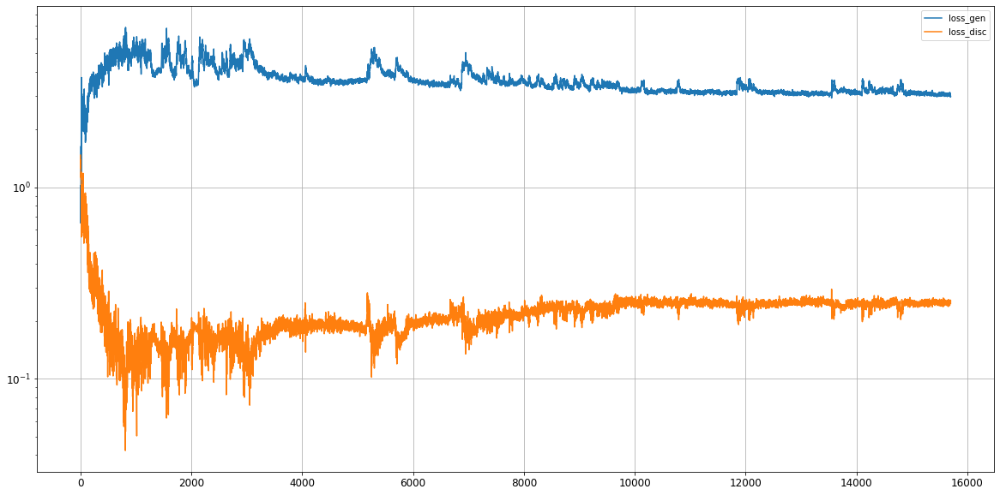

Epoch 15702/50000
discriminator loss:  0.249323 - generator loss:  3.078631 - 3s
Epoch 15703/50000
discriminator loss:  0.254464 - generator loss:  3.024795 - 3s
Epoch 15704/50000
discriminator loss:  0.250173 - generator loss:  2.993440 - 3s
Epoch 15705/50000
discriminator loss:  0.254754 - generator loss:  3.017880 - 3s
Epoch 15706/50000
discriminator loss:  0.249968 - generator loss:  3.013494 - 3s
Epoch 15707/50000
discriminator loss:  0.252084 - generator loss:  3.063914 - 3s
Epoch 15708/50000
discriminator loss:  0.246379 - generator loss:  2.987979 - 3s
Epoch 15709/50000
discriminator loss:  0.254326 - generator loss:  2.987170 - 3s
Epoch 15710/50000
discriminator loss:  0.249331 - generator loss:  3.057970 - 3s
Epoch 15711/50000
discriminator loss:  0.247332 - generator loss:  3.060827 - 3s
Epoch 15712/50000
discriminator loss:  0.244995 - generator loss:  3.028358 - 3s
Epoch 15713/50000
discriminator loss:  0.245271 - generator loss:  3.040883 - 3s
Epoch 15714/50000
discrimina

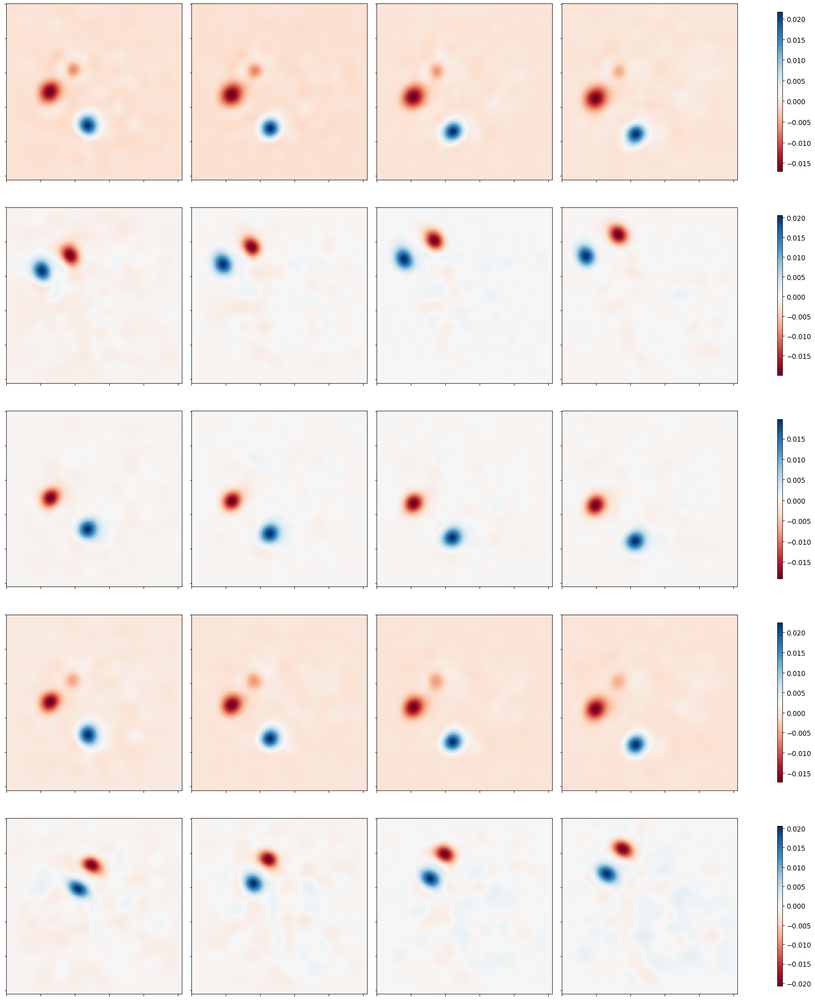

Loss: 


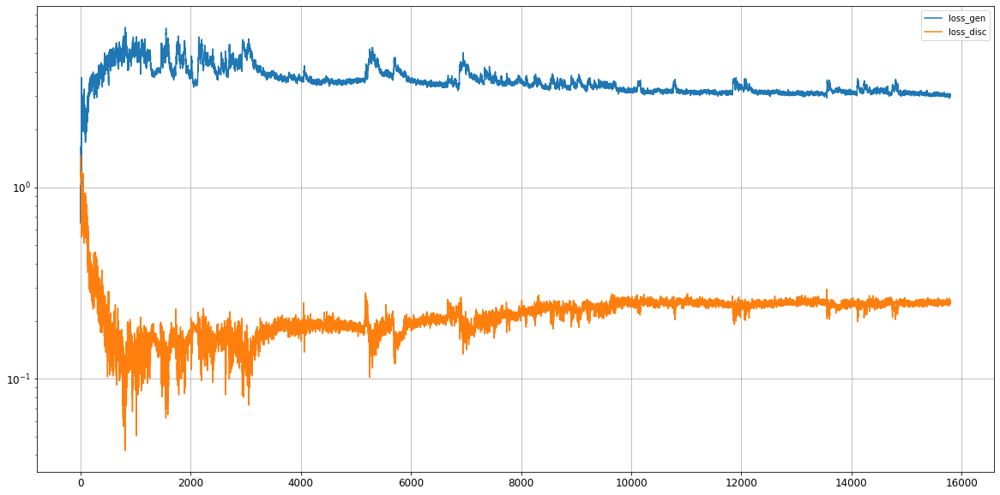

Epoch 15802/50000
discriminator loss:  0.248010 - generator loss:  2.992271 - 3s
Epoch 15803/50000
discriminator loss:  0.243243 - generator loss:  3.040196 - 3s
Epoch 15804/50000
discriminator loss:  0.245138 - generator loss:  2.999069 - 3s
Epoch 15805/50000
discriminator loss:  0.240968 - generator loss:  3.083728 - 3s
Epoch 15806/50000
discriminator loss:  0.246321 - generator loss:  3.037477 - 3s
Epoch 15807/50000
discriminator loss:  0.249607 - generator loss:  3.070951 - 3s
Epoch 15808/50000
discriminator loss:  0.250028 - generator loss:  3.064306 - 3s
Epoch 15809/50000
discriminator loss:  0.250327 - generator loss:  3.035814 - 3s
Epoch 15810/50000
discriminator loss:  0.251021 - generator loss:  3.063023 - 3s
Epoch 15811/50000
discriminator loss:  0.250690 - generator loss:  3.031738 - 3s
Epoch 15812/50000
discriminator loss:  0.247286 - generator loss:  3.071606 - 3s
Epoch 15813/50000
discriminator loss:  0.250558 - generator loss:  3.015727 - 3s
Epoch 15814/50000
discrimina

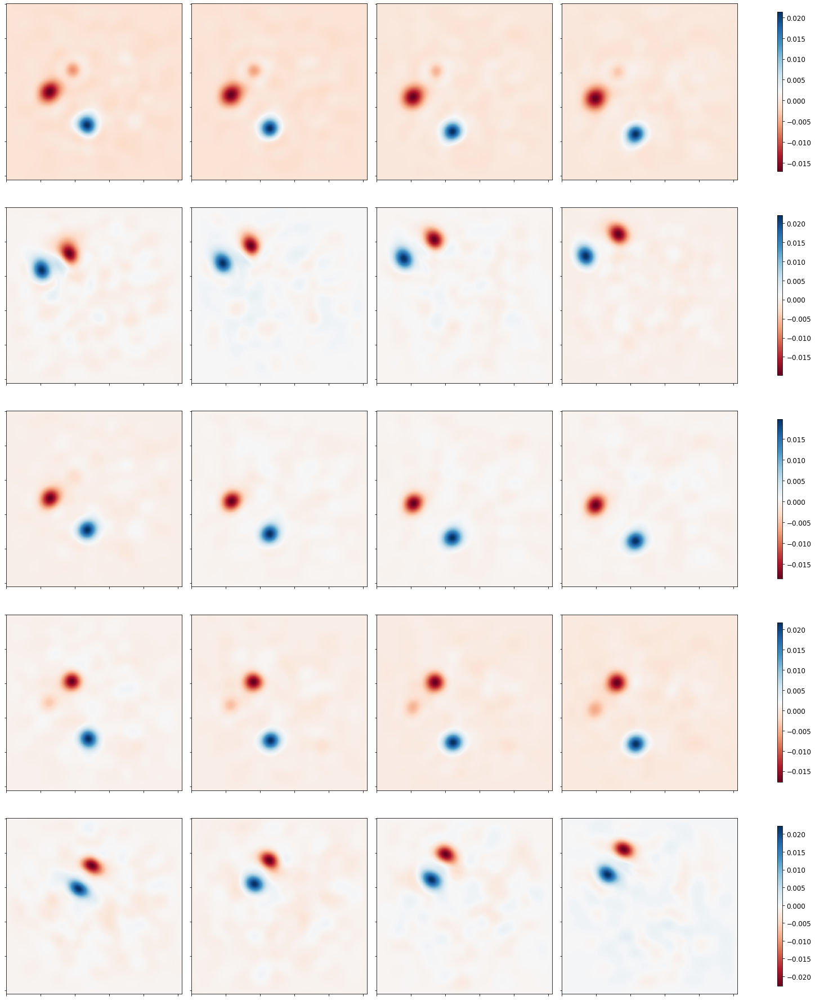

Loss: 


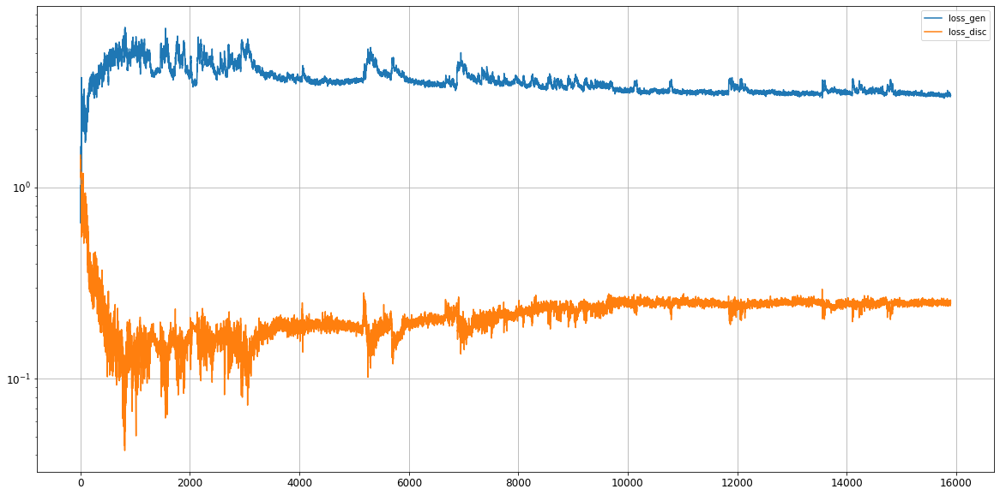

Epoch 15902/50000
discriminator loss:  0.237358 - generator loss:  3.086130 - 3s
Epoch 15903/50000
discriminator loss:  0.244743 - generator loss:  3.009195 - 3s
Epoch 15904/50000
discriminator loss:  0.254666 - generator loss:  3.044534 - 3s
Epoch 15905/50000
discriminator loss:  0.255101 - generator loss:  3.015708 - 3s
Epoch 15906/50000
discriminator loss:  0.247483 - generator loss:  3.005186 - 3s
Epoch 15907/50000
discriminator loss:  0.247827 - generator loss:  2.963446 - 3s
Epoch 15908/50000
discriminator loss:  0.254127 - generator loss:  3.008602 - 3s
Epoch 15909/50000
discriminator loss:  0.249064 - generator loss:  3.049615 - 3s
Epoch 15910/50000
discriminator loss:  0.251852 - generator loss:  3.004311 - 3s
Epoch 15911/50000
discriminator loss:  0.249848 - generator loss:  2.979361 - 3s
Epoch 15912/50000
discriminator loss:  0.245451 - generator loss:  3.033945 - 3s
Epoch 15913/50000
discriminator loss:  0.248673 - generator loss:  3.060598 - 3s
Epoch 15914/50000
discrimina

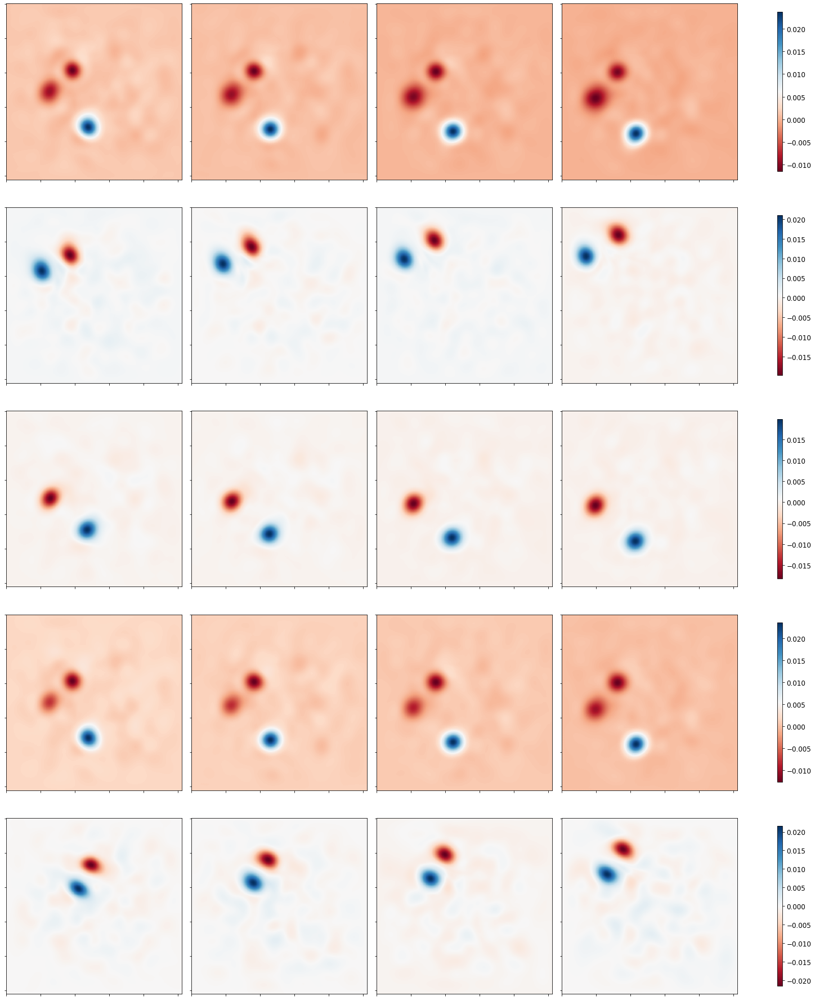

Loss: 


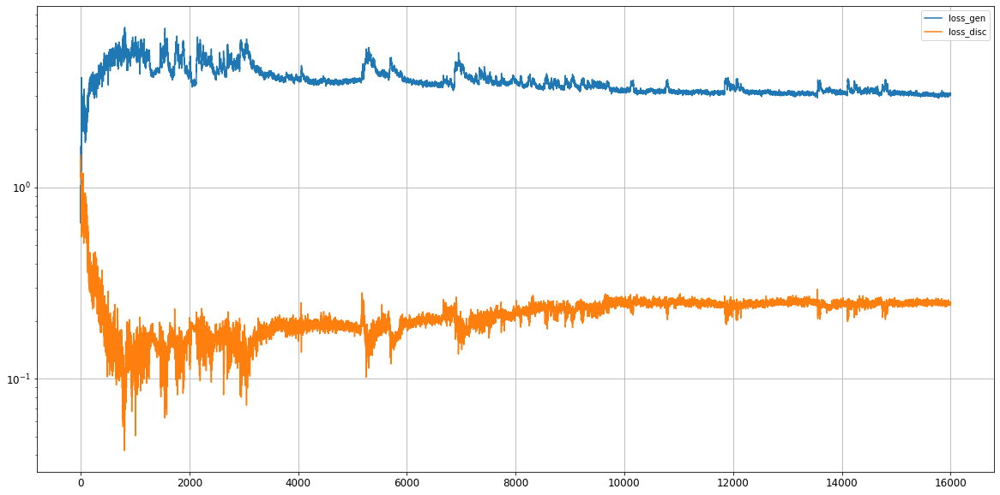

Epoch 16002/50000
discriminator loss:  0.245830 - generator loss:  3.063886 - 3s
Epoch 16003/50000
discriminator loss:  0.249561 - generator loss:  3.023472 - 3s
Epoch 16004/50000
discriminator loss:  0.246254 - generator loss:  3.009357 - 3s
Epoch 16005/50000
discriminator loss:  0.241010 - generator loss:  3.071462 - 3s
Epoch 16006/50000
discriminator loss:  0.245467 - generator loss:  3.082112 - 3s
Epoch 16007/50000
discriminator loss:  0.247807 - generator loss:  3.081335 - 3s
Epoch 16008/50000
discriminator loss:  0.246310 - generator loss:  3.005675 - 3s
Epoch 16009/50000
discriminator loss:  0.249931 - generator loss:  3.119819 - 3s
Epoch 16010/50000
discriminator loss:  0.250473 - generator loss:  3.036835 - 3s
Epoch 16011/50000
discriminator loss:  0.247333 - generator loss:  3.008787 - 3s
Epoch 16012/50000
discriminator loss:  0.249966 - generator loss:  3.032595 - 3s
Epoch 16013/50000
discriminator loss:  0.238666 - generator loss:  3.089134 - 3s
Epoch 16014/50000
discrimina

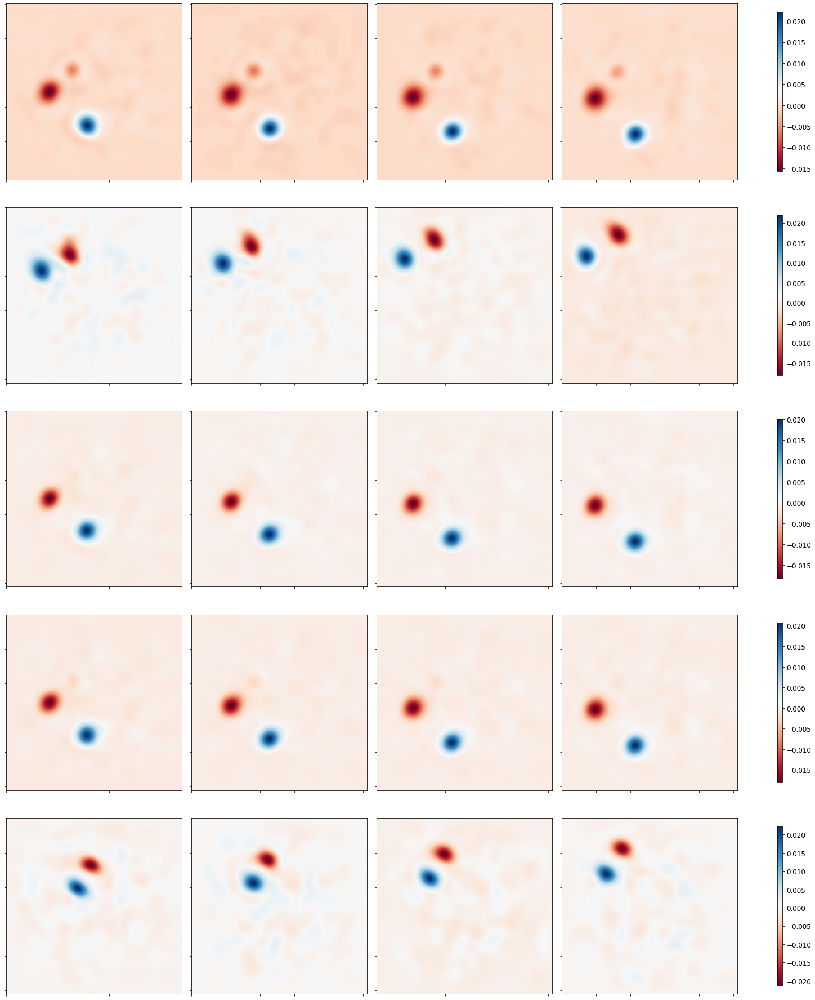

Loss: 


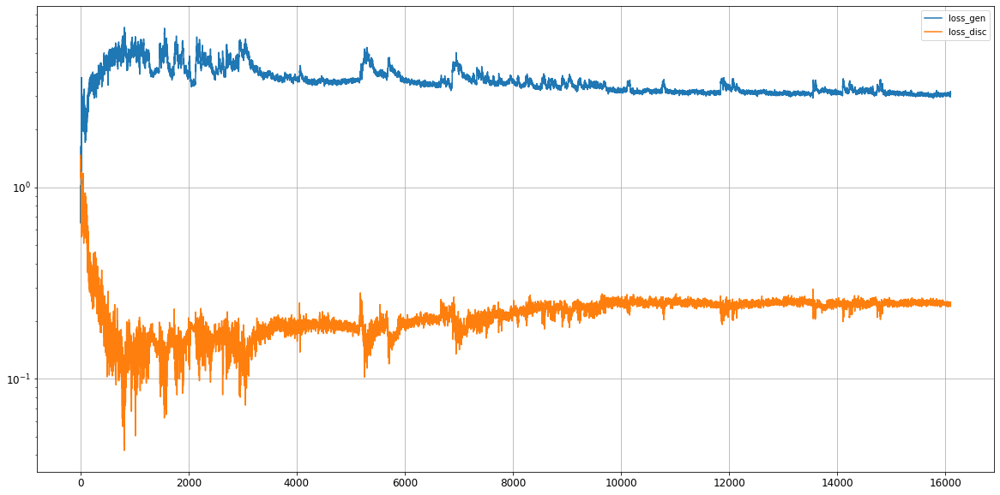

Epoch 16102/50000
discriminator loss:  0.247235 - generator loss:  2.994701 - 3s
Epoch 16103/50000
discriminator loss:  0.244037 - generator loss:  3.056778 - 3s
Epoch 16104/50000
discriminator loss:  0.243656 - generator loss:  3.073449 - 3s
Epoch 16105/50000
discriminator loss:  0.251888 - generator loss:  3.086956 - 3s
Epoch 16106/50000
discriminator loss:  0.245985 - generator loss:  3.034835 - 3s
Epoch 16107/50000
discriminator loss:  0.246609 - generator loss:  3.097458 - 3s
Epoch 16108/50000
discriminator loss:  0.247336 - generator loss:  3.079048 - 3s
Epoch 16109/50000
discriminator loss:  0.244052 - generator loss:  3.057181 - 3s
Epoch 16110/50000
discriminator loss:  0.247451 - generator loss:  3.055439 - 3s
Epoch 16111/50000
discriminator loss:  0.248899 - generator loss:  3.099702 - 3s
Epoch 16112/50000
discriminator loss:  0.245161 - generator loss:  3.073399 - 3s
Epoch 16113/50000
discriminator loss:  0.258079 - generator loss:  3.032285 - 3s
Epoch 16114/50000
discrimina

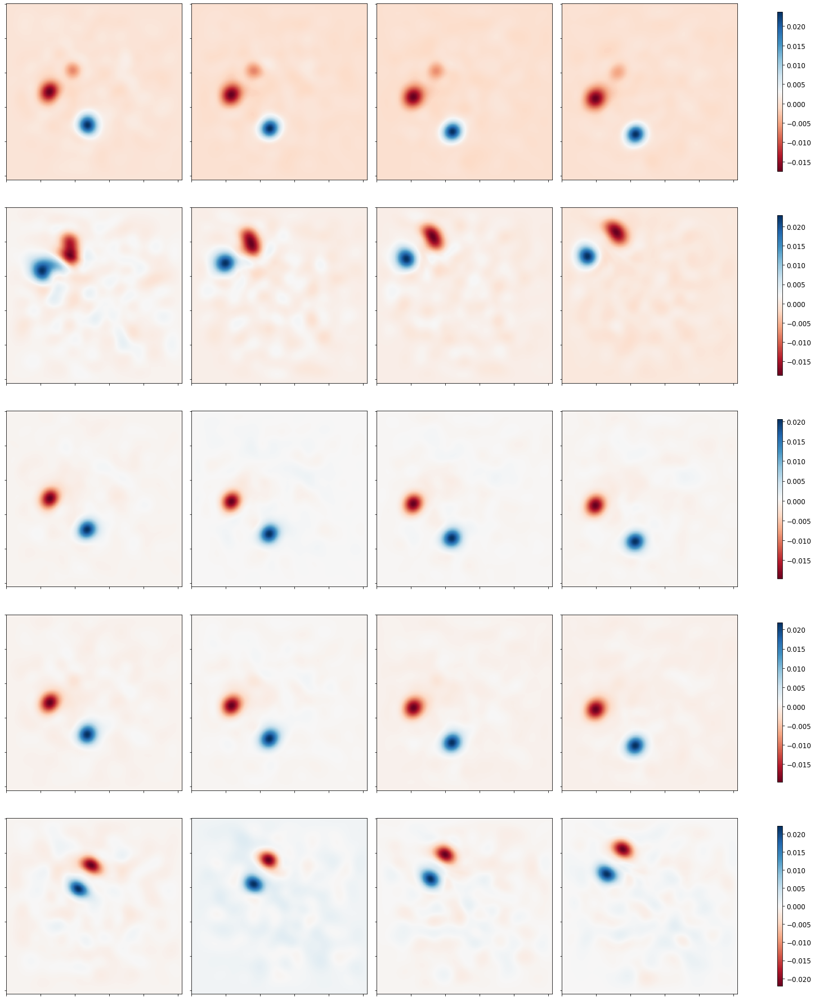

Loss: 


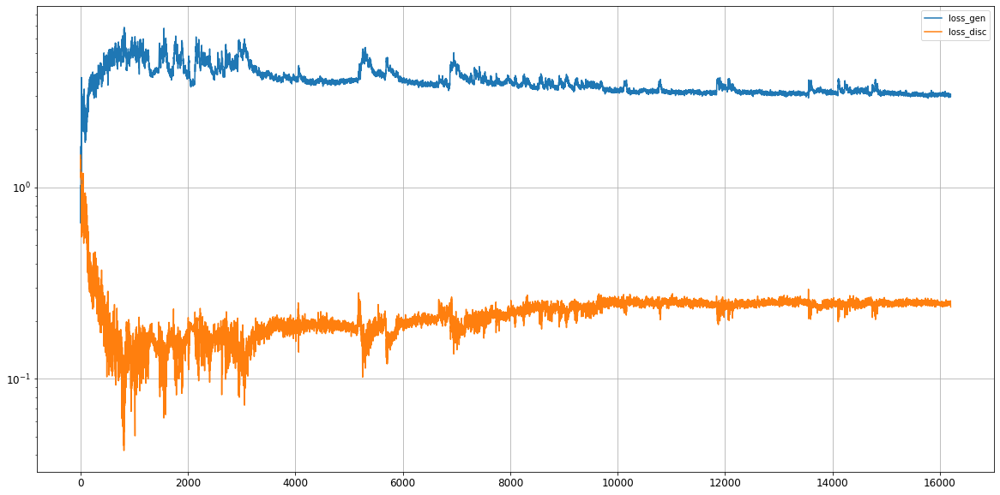

Epoch 16202/50000
discriminator loss:  0.243227 - generator loss:  2.985377 - 3s
Epoch 16203/50000
discriminator loss:  0.245464 - generator loss:  3.030473 - 3s
Epoch 16204/50000
discriminator loss:  0.248468 - generator loss:  3.082344 - 3s
Epoch 16205/50000
discriminator loss:  0.248122 - generator loss:  2.972813 - 3s
Epoch 16206/50000
discriminator loss:  0.249641 - generator loss:  3.069348 - 3s
Epoch 16207/50000
discriminator loss:  0.244054 - generator loss:  2.967496 - 3s
Epoch 16208/50000
discriminator loss:  0.248062 - generator loss:  3.076829 - 3s
Epoch 16209/50000
discriminator loss:  0.242327 - generator loss:  3.061102 - 3s
Epoch 16210/50000
discriminator loss:  0.254019 - generator loss:  2.994063 - 3s
Epoch 16211/50000
discriminator loss:  0.245425 - generator loss:  3.047153 - 3s
Epoch 16212/50000
discriminator loss:  0.246244 - generator loss:  3.012555 - 3s
Epoch 16213/50000
discriminator loss:  0.252263 - generator loss:  2.985706 - 3s
Epoch 16214/50000
discrimina

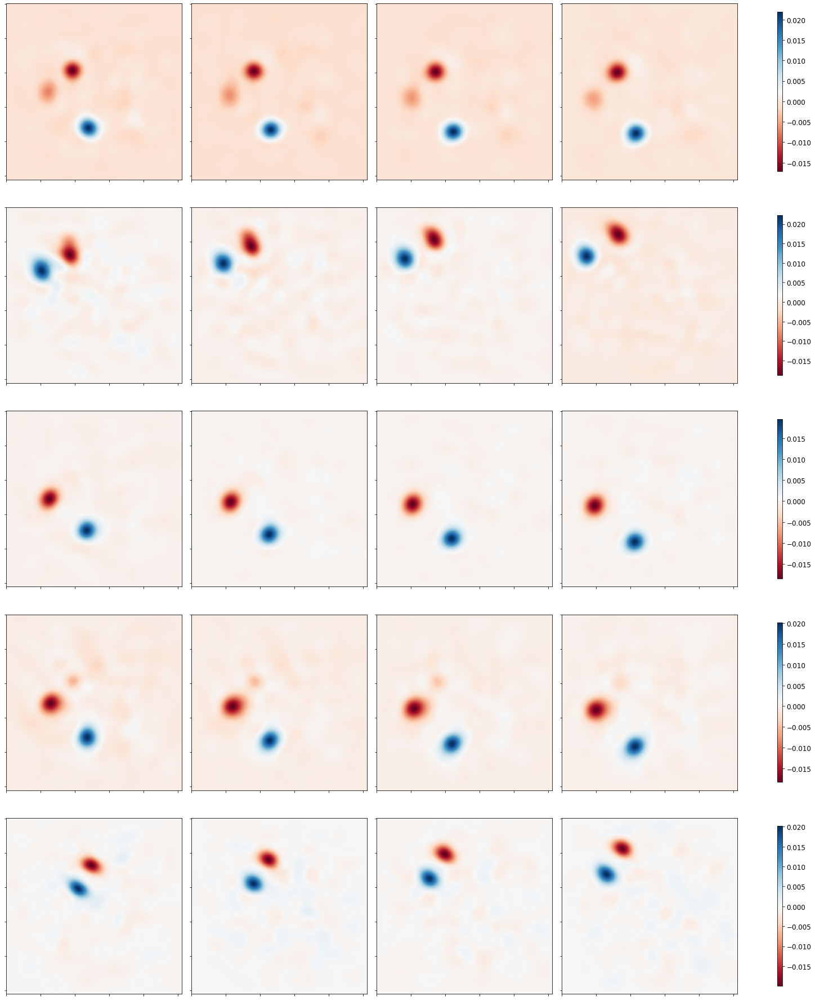

Loss: 


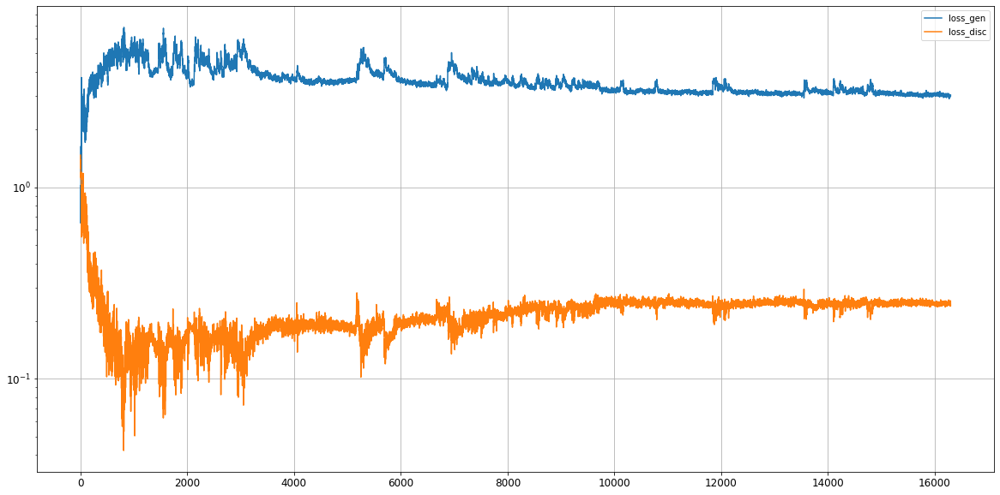

Epoch 16302/50000
discriminator loss:  0.241970 - generator loss:  2.994905 - 3s
Epoch 16303/50000
discriminator loss:  0.251202 - generator loss:  2.984997 - 3s
Epoch 16304/50000
discriminator loss:  0.247302 - generator loss:  3.061863 - 3s
Epoch 16305/50000
discriminator loss:  0.244552 - generator loss:  2.994975 - 3s
Epoch 16306/50000
discriminator loss:  0.247316 - generator loss:  2.968122 - 3s
Epoch 16307/50000
discriminator loss:  0.245604 - generator loss:  3.062718 - 3s
Epoch 16308/50000
discriminator loss:  0.251919 - generator loss:  3.000539 - 3s
Epoch 16309/50000
discriminator loss:  0.253312 - generator loss:  3.035103 - 3s
Epoch 16310/50000
discriminator loss:  0.242542 - generator loss:  2.946826 - 3s
Epoch 16311/50000
discriminator loss:  0.248828 - generator loss:  3.063822 - 3s
Epoch 16312/50000
discriminator loss:  0.248686 - generator loss:  3.018911 - 3s
Epoch 16313/50000
discriminator loss:  0.247379 - generator loss:  3.016991 - 3s
Epoch 16314/50000
discrimina

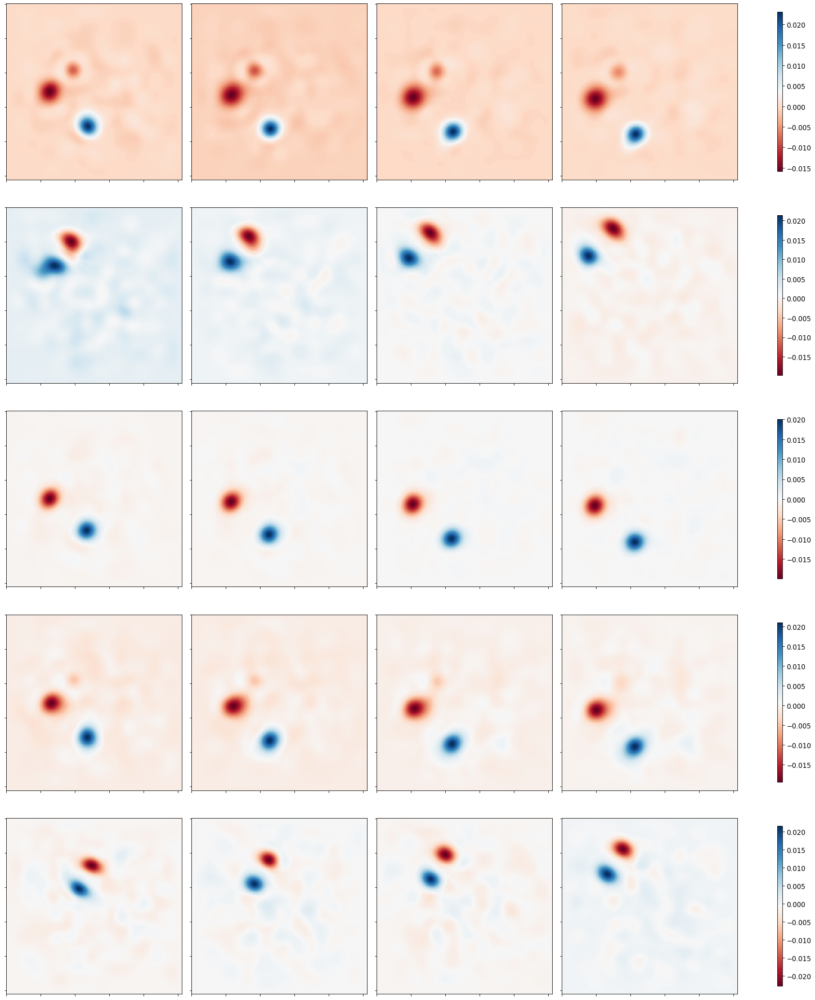

Loss: 


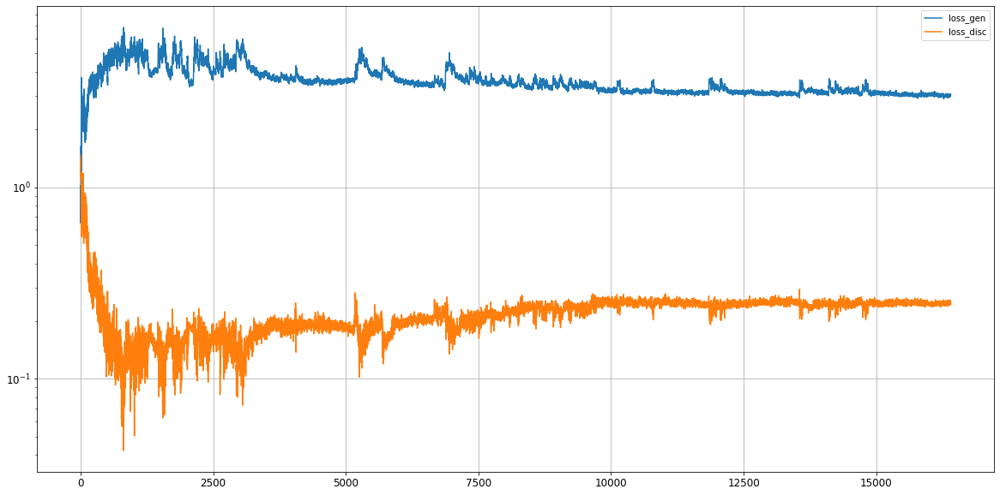

Epoch 16402/50000
discriminator loss:  0.245306 - generator loss:  3.020051 - 3s
Epoch 16403/50000
discriminator loss:  0.245093 - generator loss:  3.018239 - 3s
Epoch 16404/50000
discriminator loss:  0.247225 - generator loss:  2.981418 - 3s
Epoch 16405/50000
discriminator loss:  0.246691 - generator loss:  3.030725 - 3s
Epoch 16406/50000
discriminator loss:  0.244436 - generator loss:  3.044650 - 3s
Epoch 16407/50000
discriminator loss:  0.250532 - generator loss:  3.002985 - 3s
Epoch 16408/50000
discriminator loss:  0.245565 - generator loss:  3.039469 - 3s
Epoch 16409/50000
discriminator loss:  0.247755 - generator loss:  3.030475 - 3s
Epoch 16410/50000
discriminator loss:  0.244267 - generator loss:  2.940014 - 3s
Epoch 16411/50000
discriminator loss:  0.241176 - generator loss:  3.054589 - 3s
Epoch 16412/50000
discriminator loss:  0.241017 - generator loss:  3.031663 - 3s
Epoch 16413/50000
discriminator loss:  0.247468 - generator loss:  3.057652 - 3s
Epoch 16414/50000
discrimina

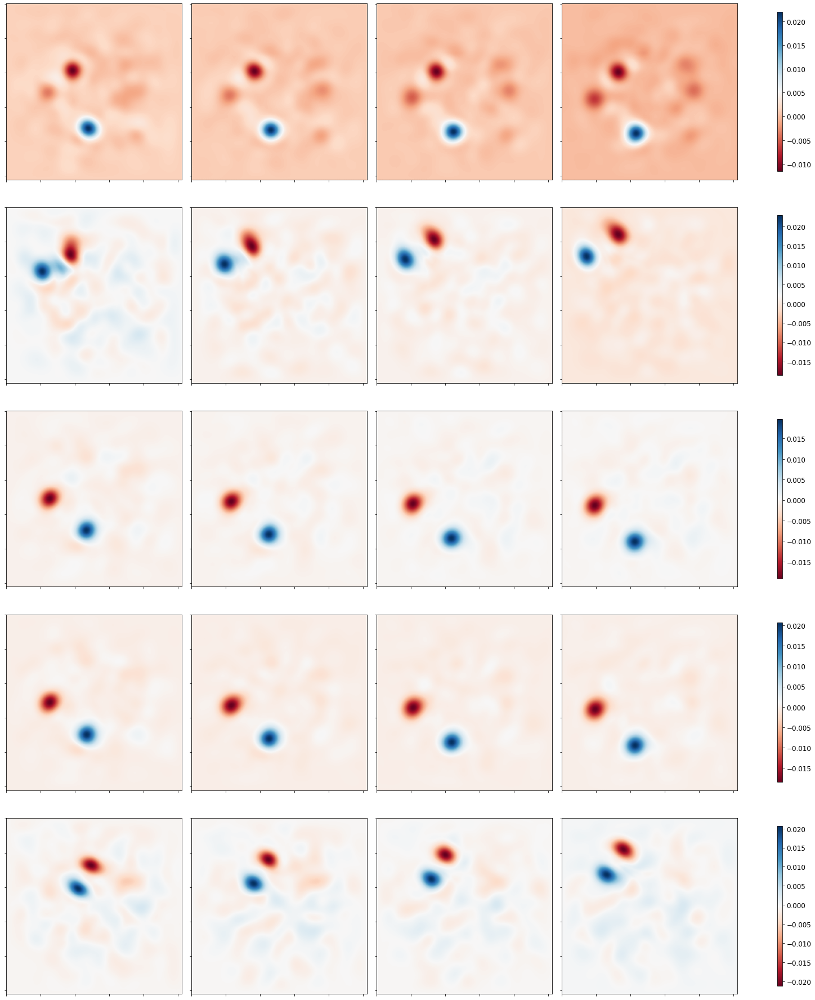

Loss: 


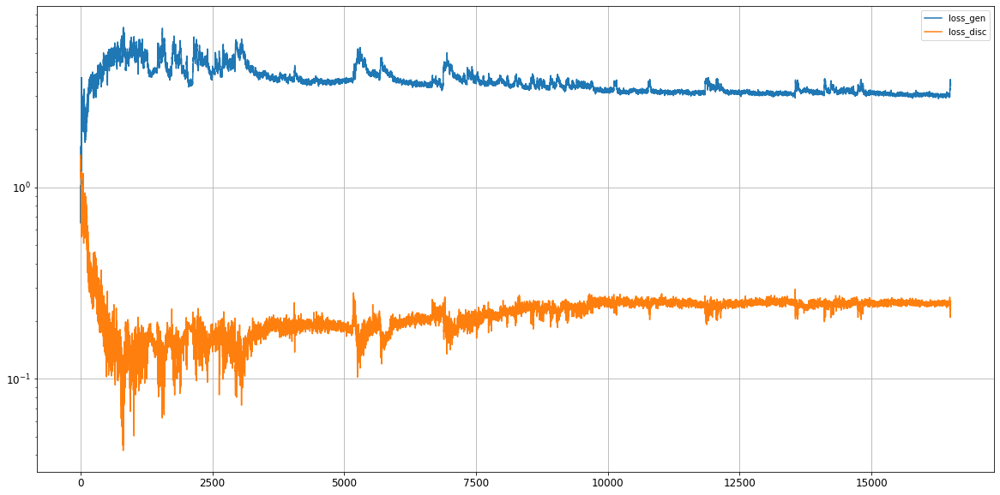

Epoch 16502/50000
discriminator loss:  0.244964 - generator loss:  3.446029 - 3s
Epoch 16503/50000
discriminator loss:  0.244420 - generator loss:  3.393170 - 3s
Epoch 16504/50000
discriminator loss:  0.254034 - generator loss:  3.337615 - 3s
Epoch 16505/50000
discriminator loss:  0.262073 - generator loss:  3.241599 - 3s
Epoch 16506/50000
discriminator loss:  0.246141 - generator loss:  3.345155 - 3s
Epoch 16507/50000
discriminator loss:  0.260062 - generator loss:  3.291318 - 3s
Epoch 16508/50000
discriminator loss:  0.248010 - generator loss:  3.272833 - 3s
Epoch 16509/50000
discriminator loss:  0.263105 - generator loss:  3.220341 - 3s
Epoch 16510/50000
discriminator loss:  0.248045 - generator loss:  3.242066 - 3s
Epoch 16511/50000
discriminator loss:  0.248572 - generator loss:  3.169880 - 3s
Epoch 16512/50000
discriminator loss:  0.250212 - generator loss:  3.261660 - 3s
Epoch 16513/50000
discriminator loss:  0.239866 - generator loss:  3.128472 - 3s
Epoch 16514/50000
discrimina

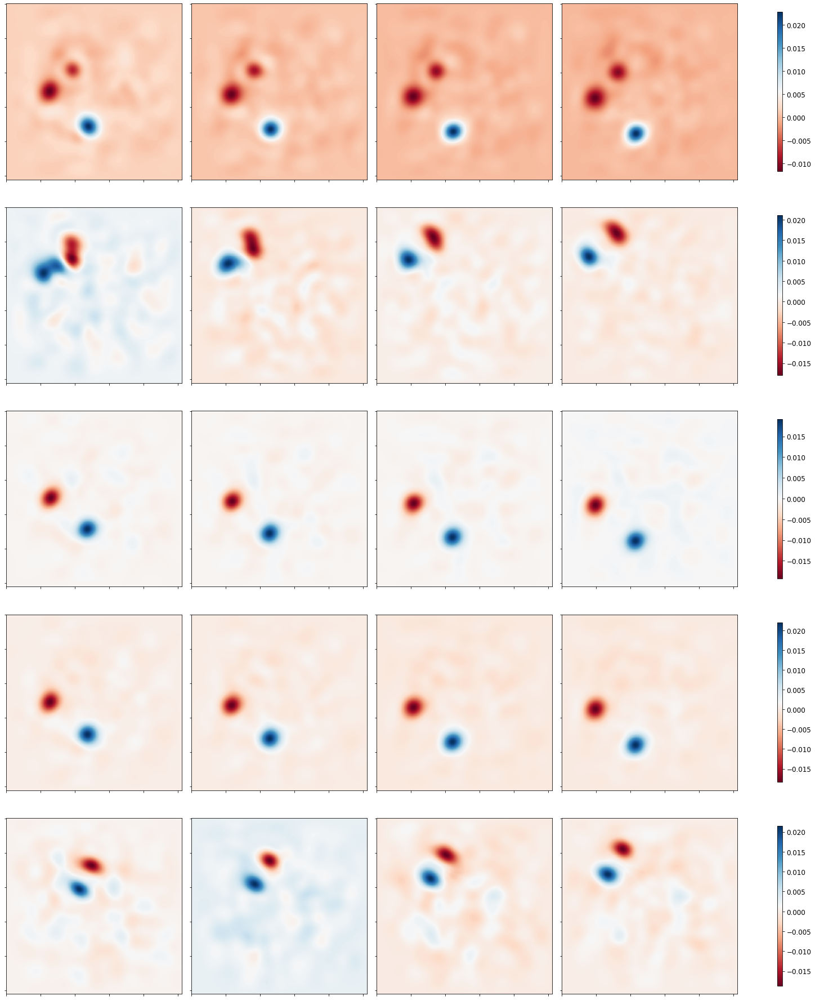

Loss: 


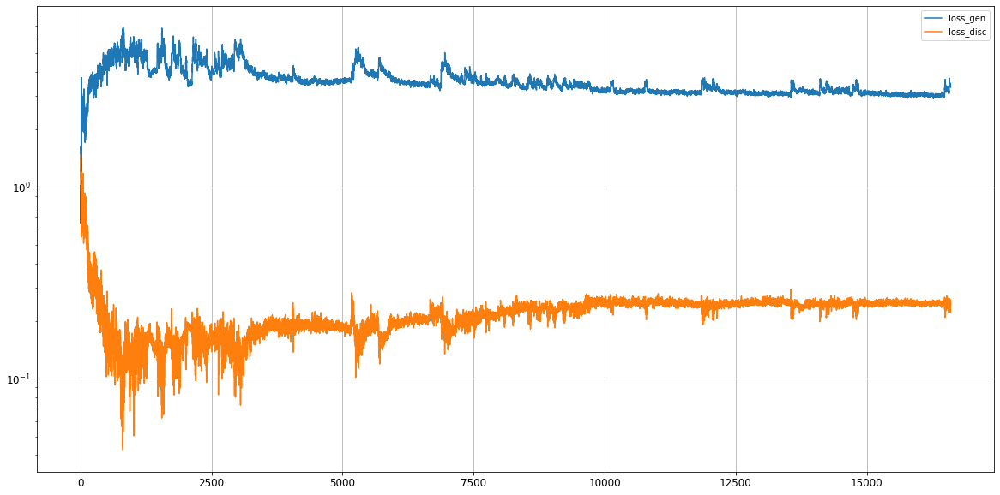

Epoch 16602/50000
discriminator loss:  0.244465 - generator loss:  3.402745 - 3s
Epoch 16603/50000
discriminator loss:  0.250705 - generator loss:  3.341633 - 3s
Epoch 16604/50000
discriminator loss:  0.253788 - generator loss:  3.231286 - 3s
Epoch 16605/50000
discriminator loss:  0.233130 - generator loss:  3.393300 - 3s
Epoch 16606/50000
discriminator loss:  0.249648 - generator loss:  3.261074 - 3s
Epoch 16607/50000
discriminator loss:  0.247163 - generator loss:  3.352638 - 3s
Epoch 16608/50000
discriminator loss:  0.207543 - generator loss:  3.347353 - 3s
Epoch 16609/50000
discriminator loss:  0.234919 - generator loss:  3.418277 - 3s
Epoch 16610/50000
discriminator loss:  0.225234 - generator loss:  3.589496 - 3s
Epoch 16611/50000
discriminator loss:  0.235732 - generator loss:  3.526582 - 3s
Epoch 16612/50000
discriminator loss:  0.228228 - generator loss:  3.423217 - 3s
Epoch 16613/50000
discriminator loss:  0.226115 - generator loss:  3.444591 - 3s
Epoch 16614/50000
discrimina

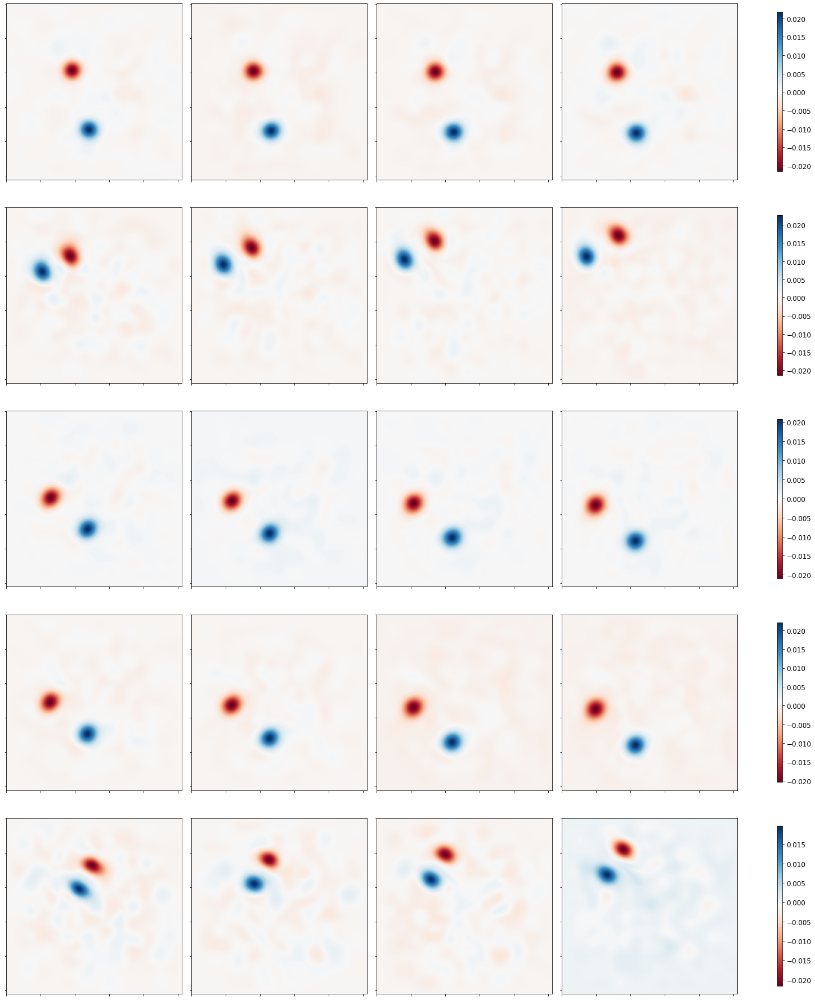

Loss: 


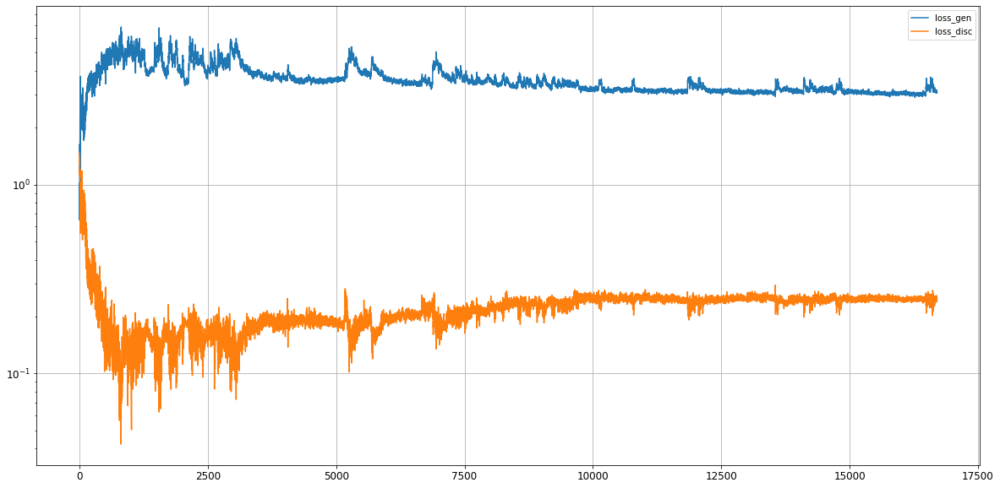

Epoch 16702/50000
discriminator loss:  0.250312 - generator loss:  3.088005 - 3s
Epoch 16703/50000
discriminator loss:  0.248191 - generator loss:  3.142232 - 3s
Epoch 16704/50000
discriminator loss:  0.252201 - generator loss:  3.045525 - 3s
Epoch 16705/50000
discriminator loss:  0.254432 - generator loss:  3.084554 - 3s
Epoch 16706/50000
discriminator loss:  0.256481 - generator loss:  3.045068 - 3s
Epoch 16707/50000
discriminator loss:  0.254922 - generator loss:  2.965159 - 3s
Epoch 16708/50000
discriminator loss:  0.244416 - generator loss:  3.091284 - 3s
Epoch 16709/50000
discriminator loss:  0.247887 - generator loss:  3.065973 - 3s
Epoch 16710/50000
discriminator loss:  0.239502 - generator loss:  3.096405 - 3s
Epoch 16711/50000
discriminator loss:  0.246823 - generator loss:  3.061155 - 3s
Epoch 16712/50000
discriminator loss:  0.241403 - generator loss:  3.057022 - 3s
Epoch 16713/50000
discriminator loss:  0.243245 - generator loss:  3.082713 - 3s
Epoch 16714/50000
discrimina

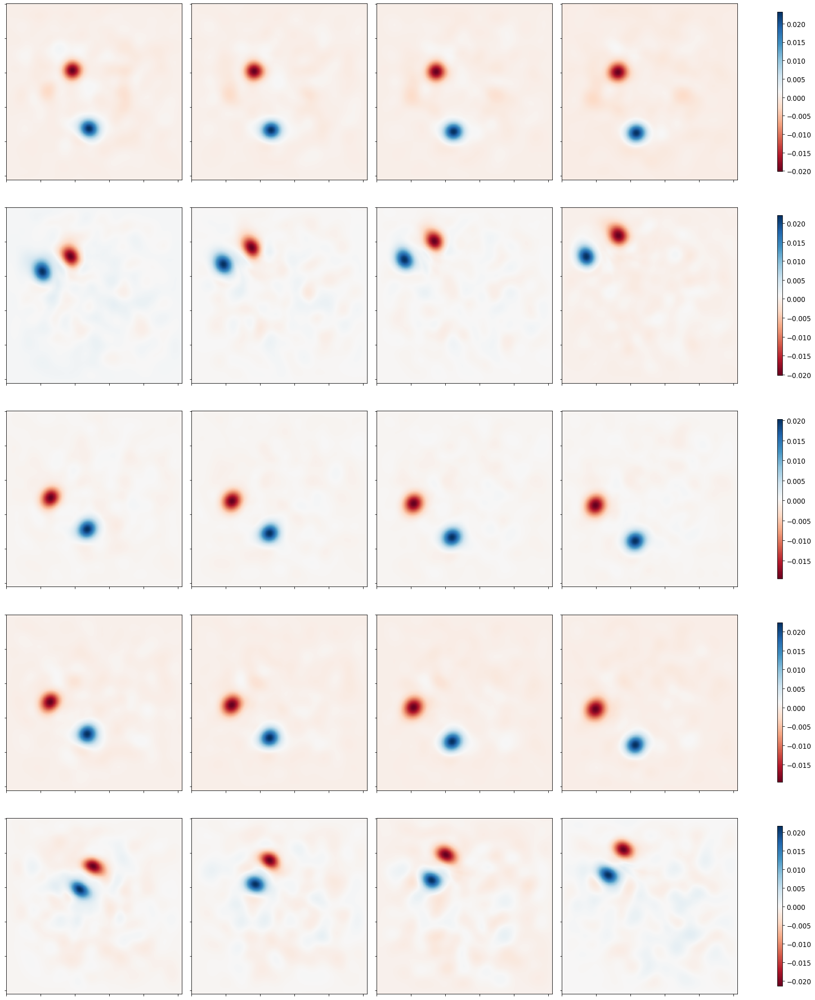

Loss: 


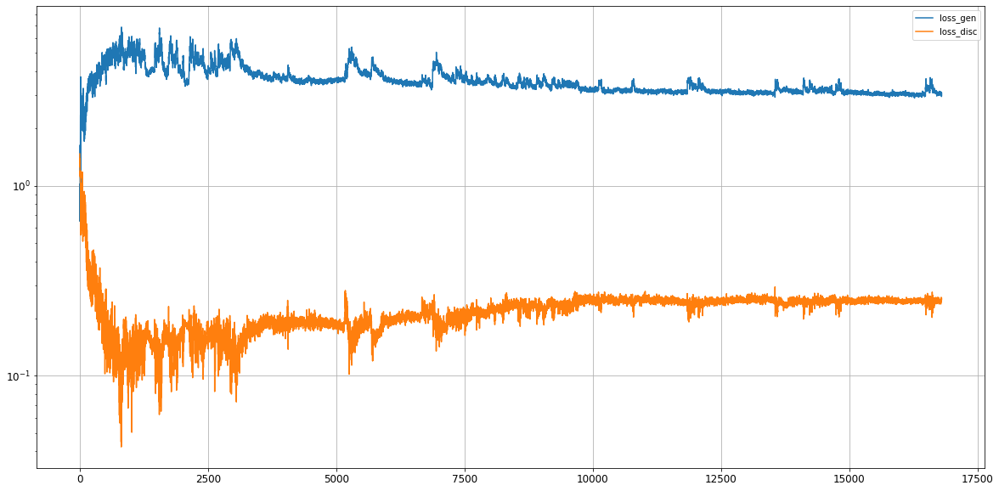

Epoch 16802/50000
discriminator loss:  0.246272 - generator loss:  3.063597 - 3s
Epoch 16803/50000
discriminator loss:  0.251177 - generator loss:  3.019036 - 3s
Epoch 16804/50000
discriminator loss:  0.248745 - generator loss:  3.025455 - 3s
Epoch 16805/50000
discriminator loss:  0.250547 - generator loss:  3.047065 - 3s
Epoch 16806/50000
discriminator loss:  0.249268 - generator loss:  3.033930 - 3s
Epoch 16807/50000
discriminator loss:  0.257421 - generator loss:  3.069917 - 3s
Epoch 16808/50000
discriminator loss:  0.240720 - generator loss:  3.021724 - 3s
Epoch 16809/50000
discriminator loss:  0.246250 - generator loss:  3.090402 - 3s
Epoch 16810/50000
discriminator loss:  0.242582 - generator loss:  3.049665 - 3s
Epoch 16811/50000
discriminator loss:  0.255850 - generator loss:  3.029105 - 3s
Epoch 16812/50000
discriminator loss:  0.254940 - generator loss:  3.047776 - 3s
Epoch 16813/50000
discriminator loss:  0.254916 - generator loss:  3.060972 - 3s
Epoch 16814/50000
discrimina

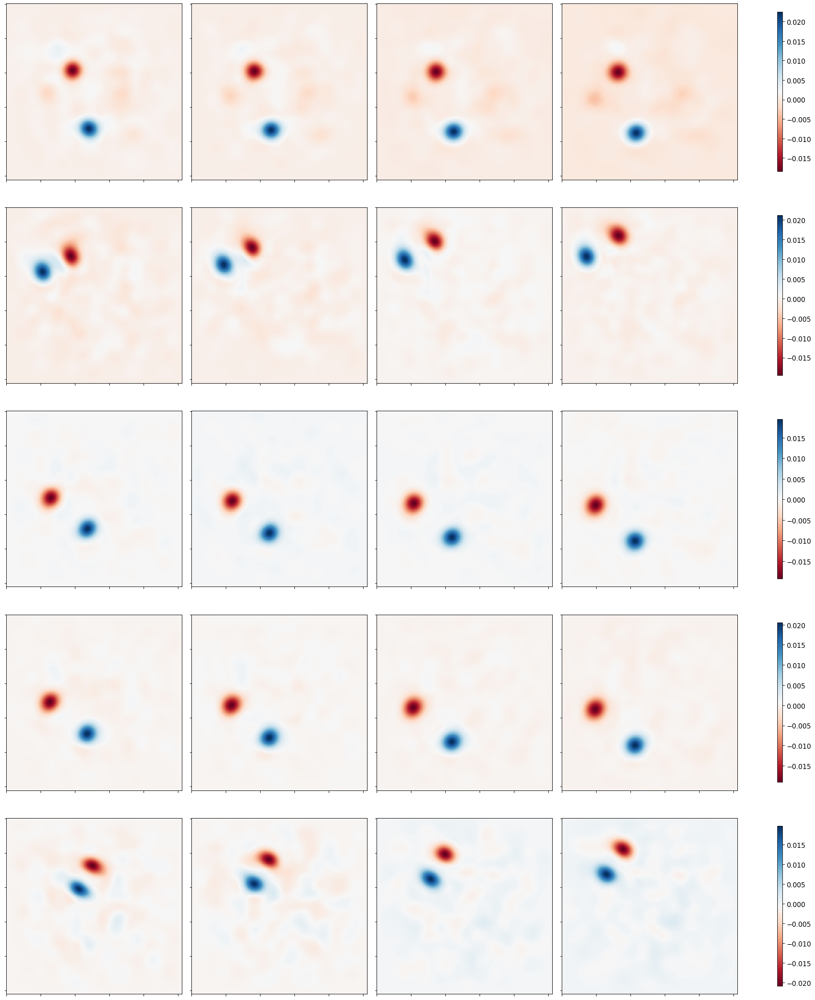

Loss: 


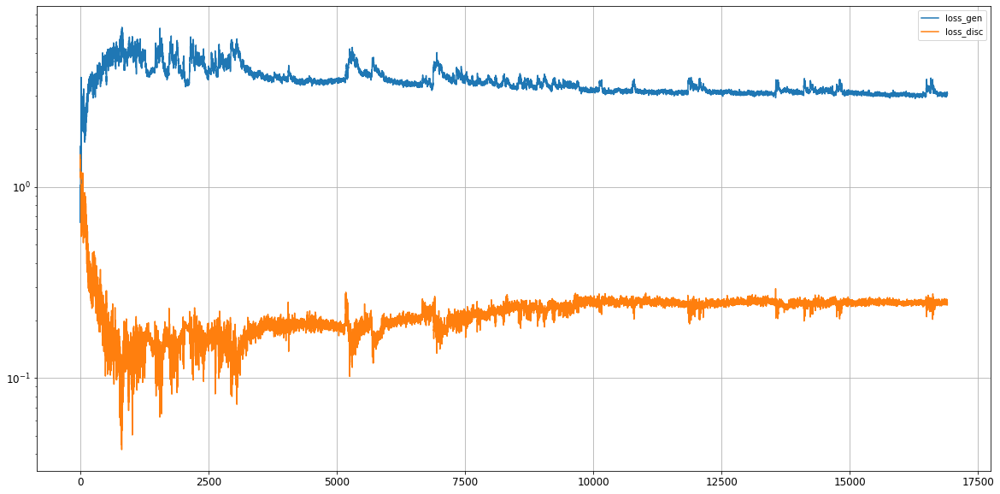

Epoch 16902/50000
discriminator loss:  0.240679 - generator loss:  3.084634 - 3s
Epoch 16903/50000
discriminator loss:  0.246937 - generator loss:  3.020953 - 3s
Epoch 16904/50000
discriminator loss:  0.251376 - generator loss:  3.071467 - 3s
Epoch 16905/50000
discriminator loss:  0.244618 - generator loss:  3.040080 - 3s
Epoch 16906/50000
discriminator loss:  0.245428 - generator loss:  3.051009 - 3s
Epoch 16907/50000
discriminator loss:  0.244423 - generator loss:  3.176461 - 3s
Epoch 16908/50000
discriminator loss:  0.242197 - generator loss:  3.056662 - 3s
Epoch 16909/50000
discriminator loss:  0.249467 - generator loss:  3.057293 - 3s
Epoch 16910/50000
discriminator loss:  0.250108 - generator loss:  3.062102 - 3s
Epoch 16911/50000
discriminator loss:  0.242624 - generator loss:  3.022025 - 3s
Epoch 16912/50000
discriminator loss:  0.247140 - generator loss:  3.114949 - 3s
Epoch 16913/50000
discriminator loss:  0.245133 - generator loss:  3.050857 - 3s
Epoch 16914/50000
discrimina

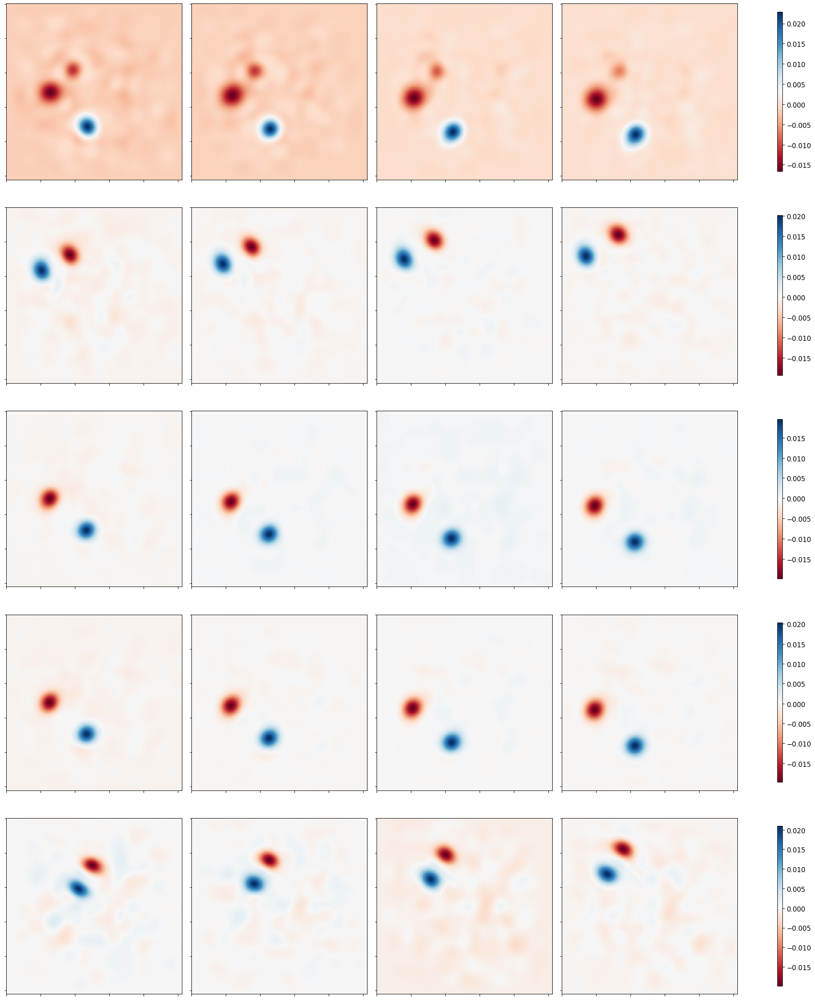

Loss: 


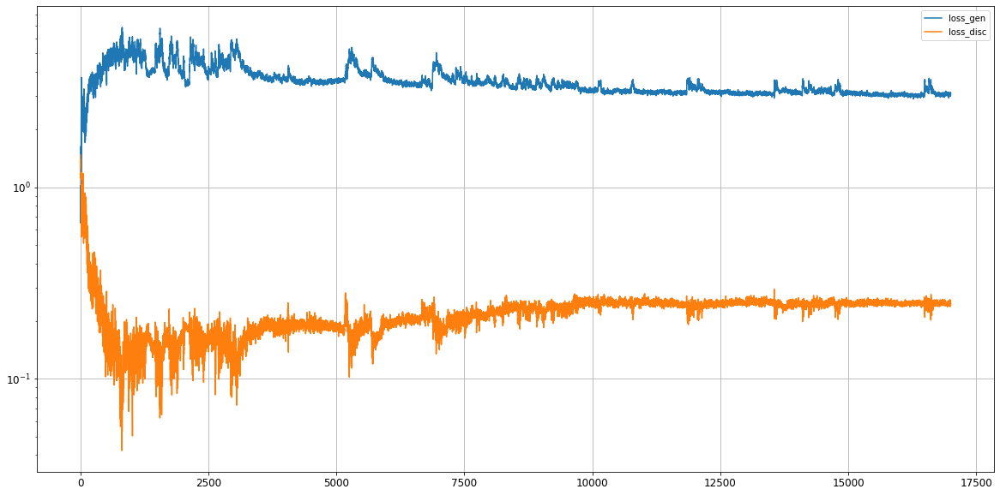

Epoch 17002/50000
discriminator loss:  0.248336 - generator loss:  3.070899 - 3s
Epoch 17003/50000
discriminator loss:  0.241842 - generator loss:  3.080798 - 3s
Epoch 17004/50000
discriminator loss:  0.248042 - generator loss:  3.040692 - 3s
Epoch 17005/50000
discriminator loss:  0.245157 - generator loss:  3.046252 - 3s
Epoch 17006/50000
discriminator loss:  0.246822 - generator loss:  3.098660 - 3s
Epoch 17007/50000
discriminator loss:  0.242558 - generator loss:  3.061186 - 3s
Epoch 17008/50000
discriminator loss:  0.248806 - generator loss:  2.984993 - 3s
Epoch 17009/50000
discriminator loss:  0.247167 - generator loss:  3.078055 - 3s
Epoch 17010/50000
discriminator loss:  0.251984 - generator loss:  3.067086 - 3s
Epoch 17011/50000
discriminator loss:  0.243728 - generator loss:  3.029721 - 3s
Epoch 17012/50000
discriminator loss:  0.248437 - generator loss:  3.071956 - 3s
Epoch 17013/50000
discriminator loss:  0.248882 - generator loss:  3.073271 - 3s
Epoch 17014/50000
discrimina

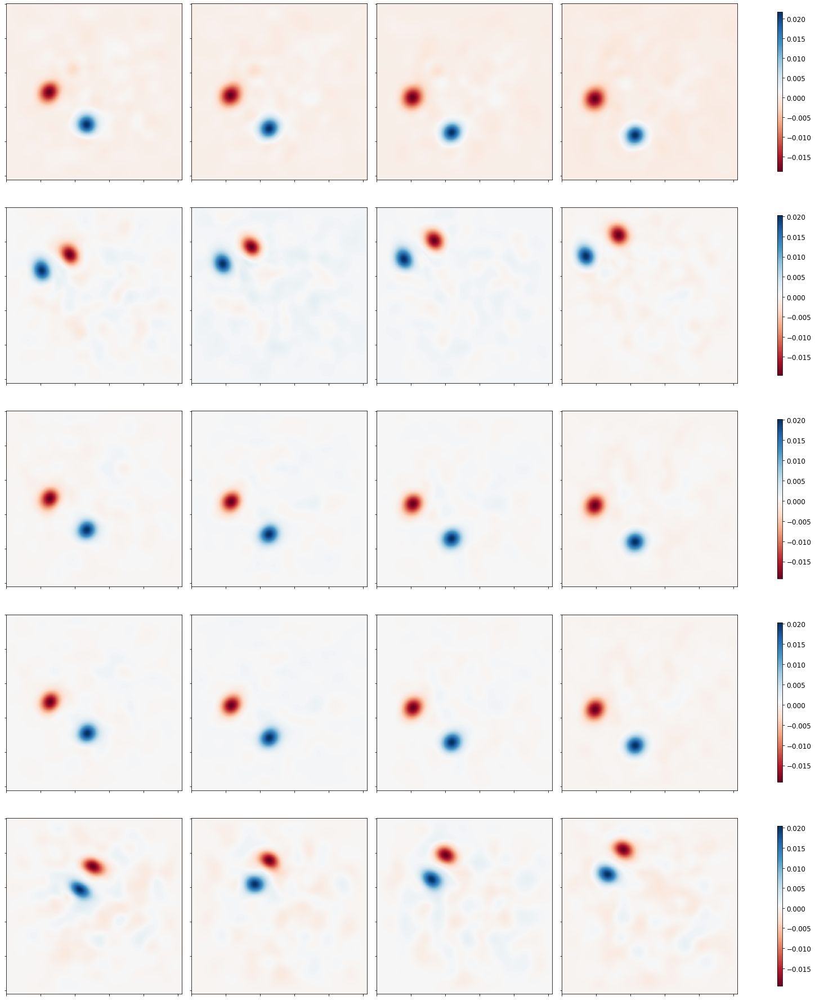

Loss: 


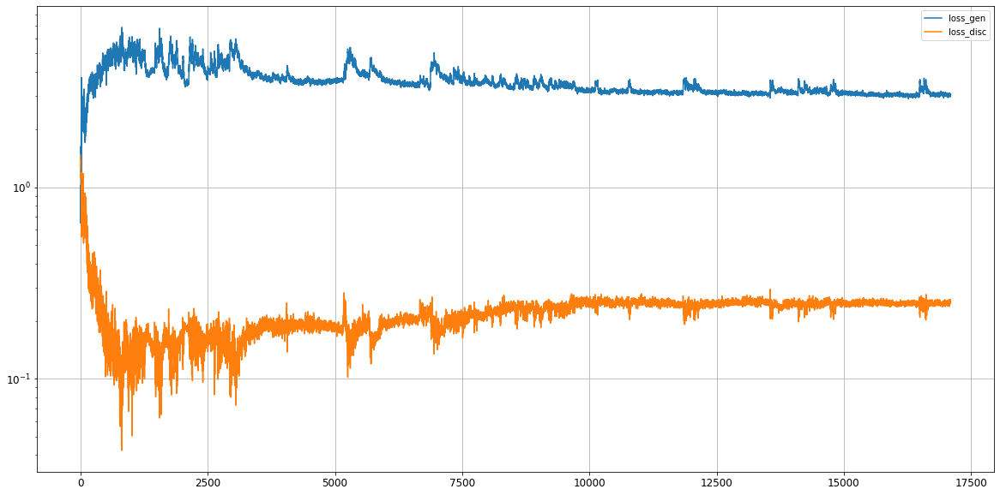

Epoch 17102/50000
discriminator loss:  0.258149 - generator loss:  2.951023 - 3s
Epoch 17103/50000
discriminator loss:  0.256886 - generator loss:  2.999010 - 3s
Epoch 17104/50000
discriminator loss:  0.245646 - generator loss:  2.995755 - 3s
Epoch 17105/50000
discriminator loss:  0.256180 - generator loss:  3.044948 - 3s
Epoch 17106/50000
discriminator loss:  0.245757 - generator loss:  2.959196 - 3s
Epoch 17107/50000
discriminator loss:  0.249377 - generator loss:  3.073874 - 3s
Epoch 17108/50000
discriminator loss:  0.248830 - generator loss:  2.985742 - 3s
Epoch 17109/50000
discriminator loss:  0.253462 - generator loss:  2.975358 - 3s
Epoch 17110/50000
discriminator loss:  0.248151 - generator loss:  2.971461 - 3s
Epoch 17111/50000
discriminator loss:  0.242803 - generator loss:  3.043546 - 3s
Epoch 17112/50000
discriminator loss:  0.246997 - generator loss:  3.058860 - 3s
Epoch 17113/50000
discriminator loss:  0.250883 - generator loss:  3.038501 - 3s
Epoch 17114/50000
discrimina

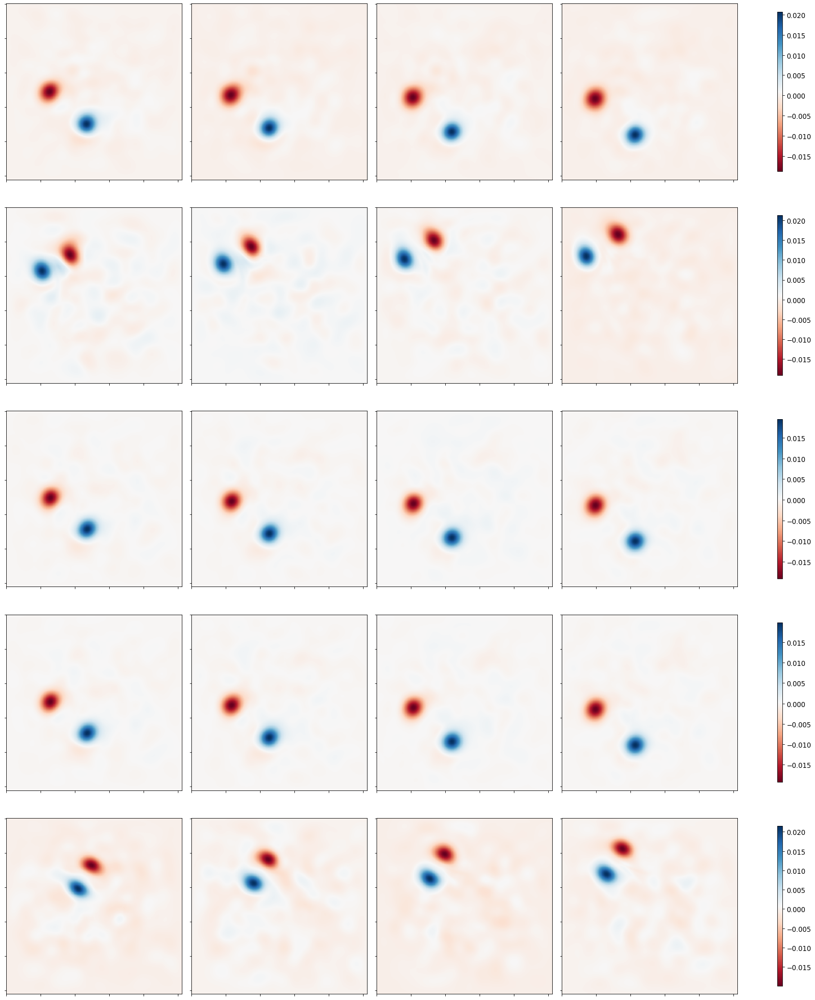

Loss: 


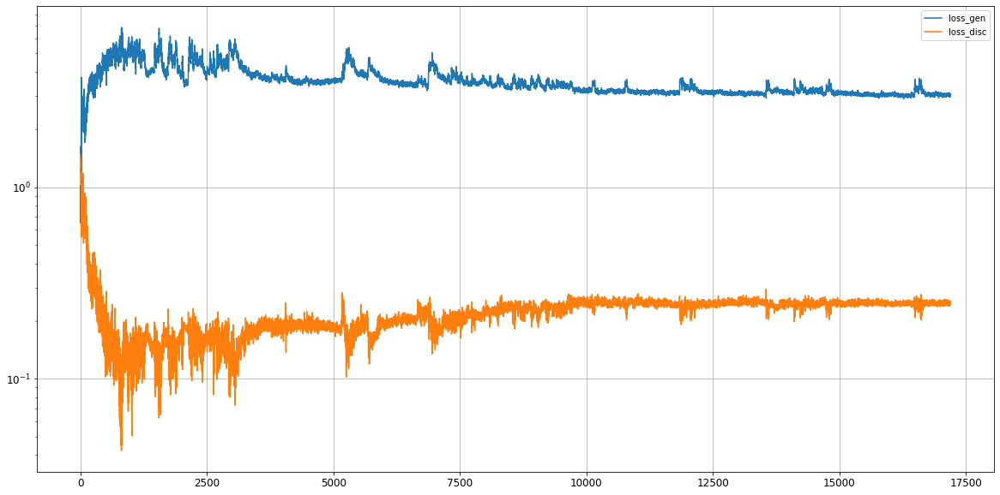

Epoch 17202/50000
discriminator loss:  0.247781 - generator loss:  3.028785 - 3s
Epoch 17203/50000
discriminator loss:  0.246745 - generator loss:  2.972113 - 3s
Epoch 17204/50000
discriminator loss:  0.255141 - generator loss:  3.030593 - 3s
Epoch 17205/50000
discriminator loss:  0.253317 - generator loss:  3.011166 - 3s
Epoch 17206/50000
discriminator loss:  0.253087 - generator loss:  3.004917 - 3s
Epoch 17207/50000
discriminator loss:  0.244431 - generator loss:  3.004089 - 3s
Epoch 17208/50000
discriminator loss:  0.246295 - generator loss:  3.015259 - 3s
Epoch 17209/50000
discriminator loss:  0.249869 - generator loss:  2.983941 - 3s
Epoch 17210/50000
discriminator loss:  0.243679 - generator loss:  3.038756 - 3s
Epoch 17211/50000
discriminator loss:  0.252099 - generator loss:  3.012044 - 3s
Epoch 17212/50000
discriminator loss:  0.248337 - generator loss:  3.024759 - 3s
Epoch 17213/50000
discriminator loss:  0.244094 - generator loss:  3.088755 - 3s
Epoch 17214/50000
discrimina

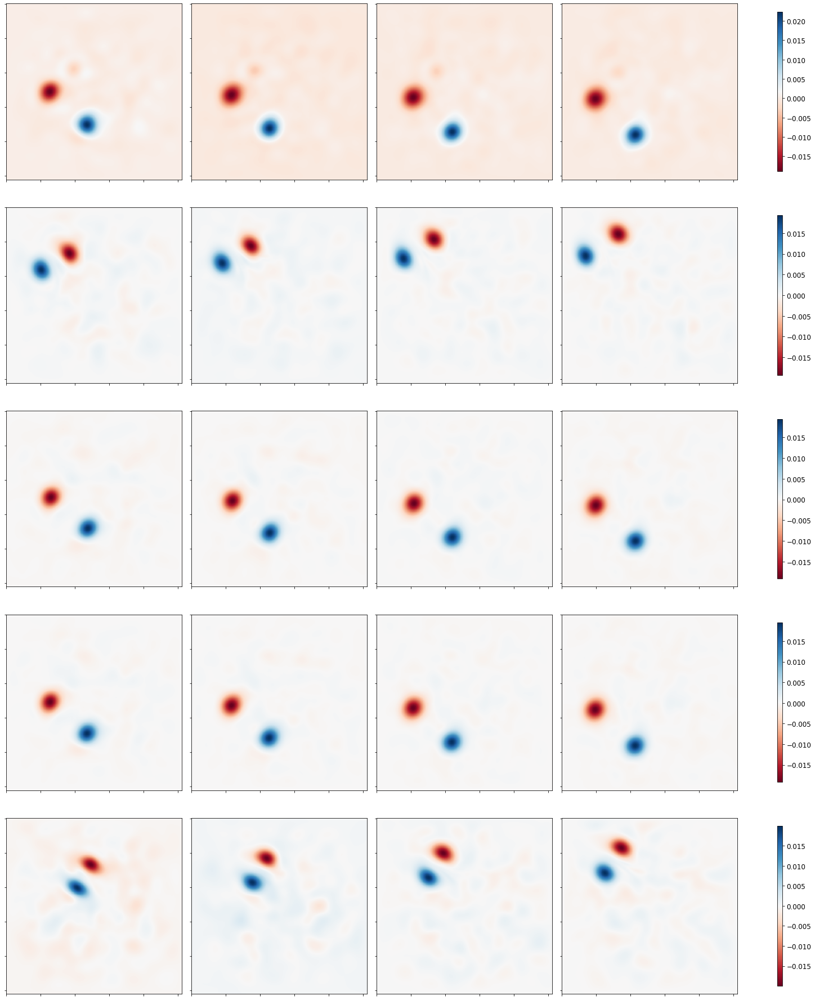

Loss: 


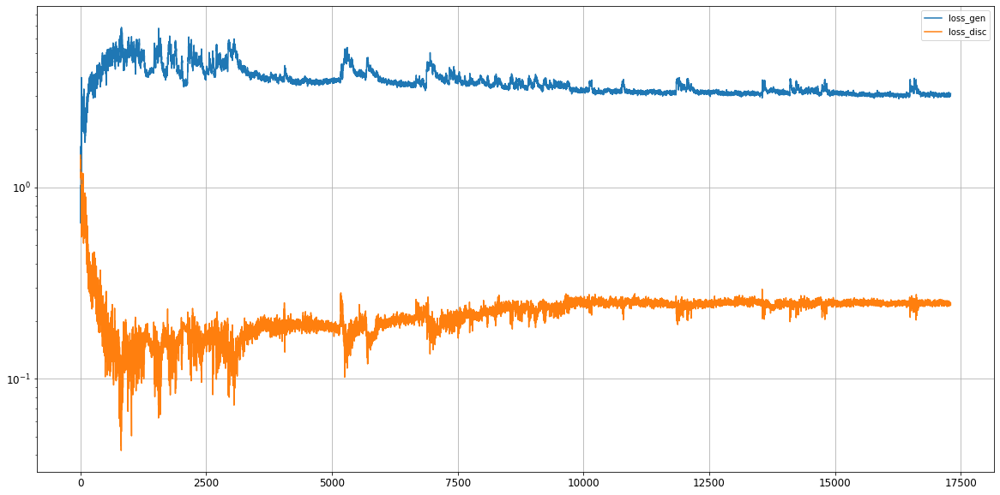

Epoch 17302/50000
discriminator loss:  0.246474 - generator loss:  3.093810 - 3s
Epoch 17303/50000
discriminator loss:  0.253212 - generator loss:  2.998435 - 3s
Epoch 17304/50000
discriminator loss:  0.241173 - generator loss:  3.032954 - 3s
Epoch 17305/50000
discriminator loss:  0.246767 - generator loss:  3.068557 - 3s
Epoch 17306/50000
discriminator loss:  0.246673 - generator loss:  2.990280 - 3s
Epoch 17307/50000
discriminator loss:  0.237141 - generator loss:  3.045360 - 3s
Epoch 17308/50000
discriminator loss:  0.248920 - generator loss:  3.051964 - 3s
Epoch 17309/50000
discriminator loss:  0.246173 - generator loss:  3.053291 - 3s
Epoch 17310/50000
discriminator loss:  0.252567 - generator loss:  3.076768 - 3s
Epoch 17311/50000
discriminator loss:  0.244265 - generator loss:  3.001274 - 3s
Epoch 17312/50000
discriminator loss:  0.242348 - generator loss:  3.062883 - 3s
Epoch 17313/50000
discriminator loss:  0.244800 - generator loss:  3.064480 - 3s
Epoch 17314/50000
discrimina

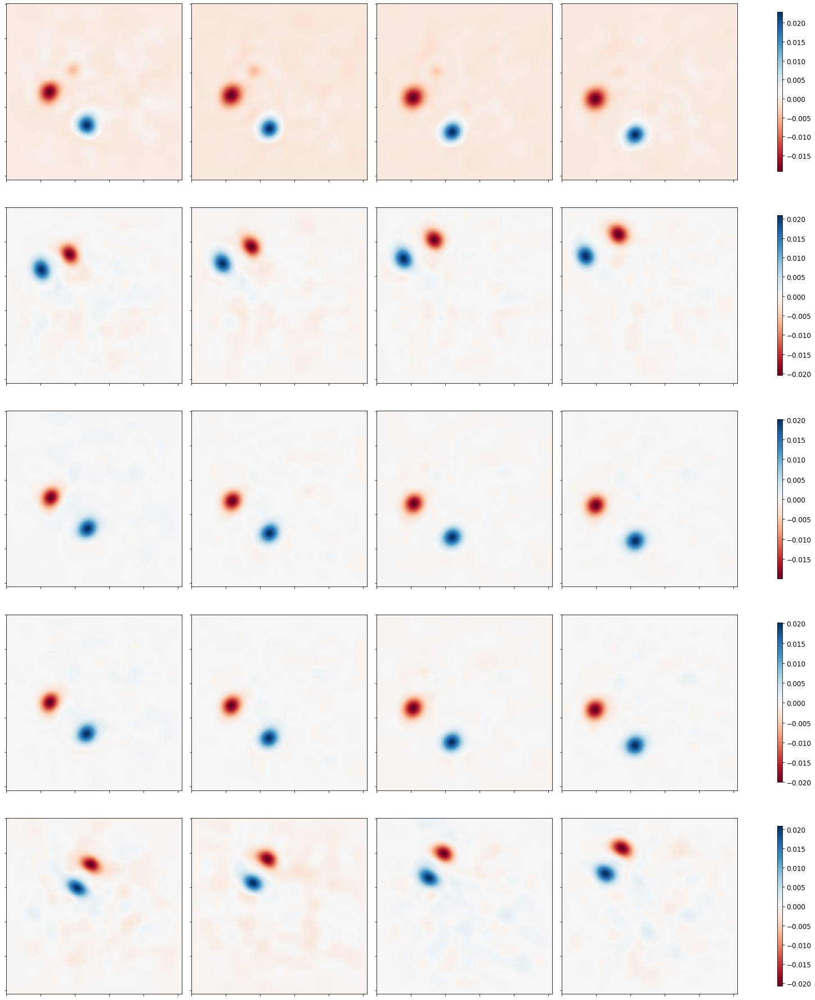

Loss: 


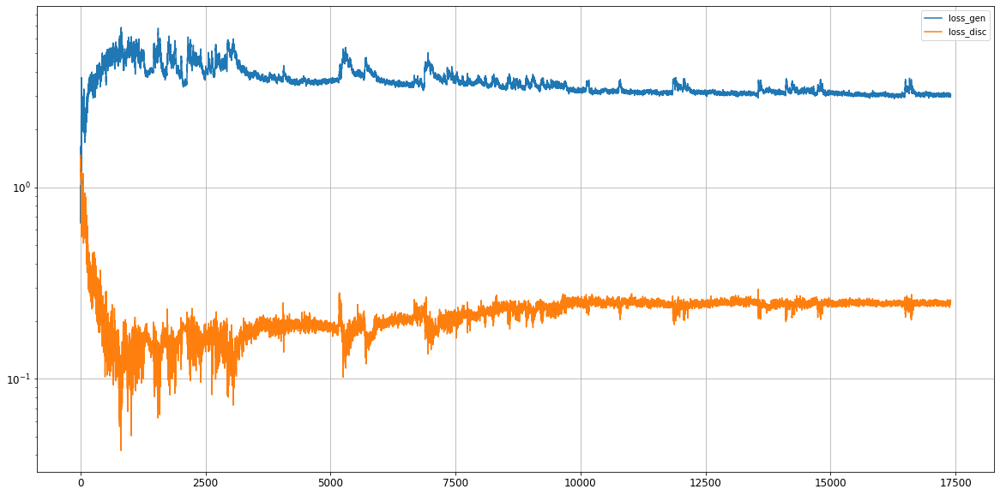

Epoch 17402/50000
discriminator loss:  0.241011 - generator loss:  3.007123 - 3s
Epoch 17403/50000
discriminator loss:  0.251546 - generator loss:  3.050466 - 3s
Epoch 17404/50000
discriminator loss:  0.244938 - generator loss:  3.006875 - 3s
Epoch 17405/50000
discriminator loss:  0.251228 - generator loss:  2.993275 - 3s
Epoch 17406/50000
discriminator loss:  0.250959 - generator loss:  3.042621 - 3s
Epoch 17407/50000
discriminator loss:  0.255137 - generator loss:  2.990430 - 3s
Epoch 17408/50000
discriminator loss:  0.249485 - generator loss:  3.027573 - 3s
Epoch 17409/50000
discriminator loss:  0.251189 - generator loss:  3.020302 - 3s
Epoch 17410/50000
discriminator loss:  0.251052 - generator loss:  3.005987 - 3s
Epoch 17411/50000
discriminator loss:  0.248358 - generator loss:  3.021266 - 3s
Epoch 17412/50000
discriminator loss:  0.251424 - generator loss:  2.941325 - 3s
Epoch 17413/50000
discriminator loss:  0.254655 - generator loss:  3.022777 - 3s
Epoch 17414/50000
discrimina

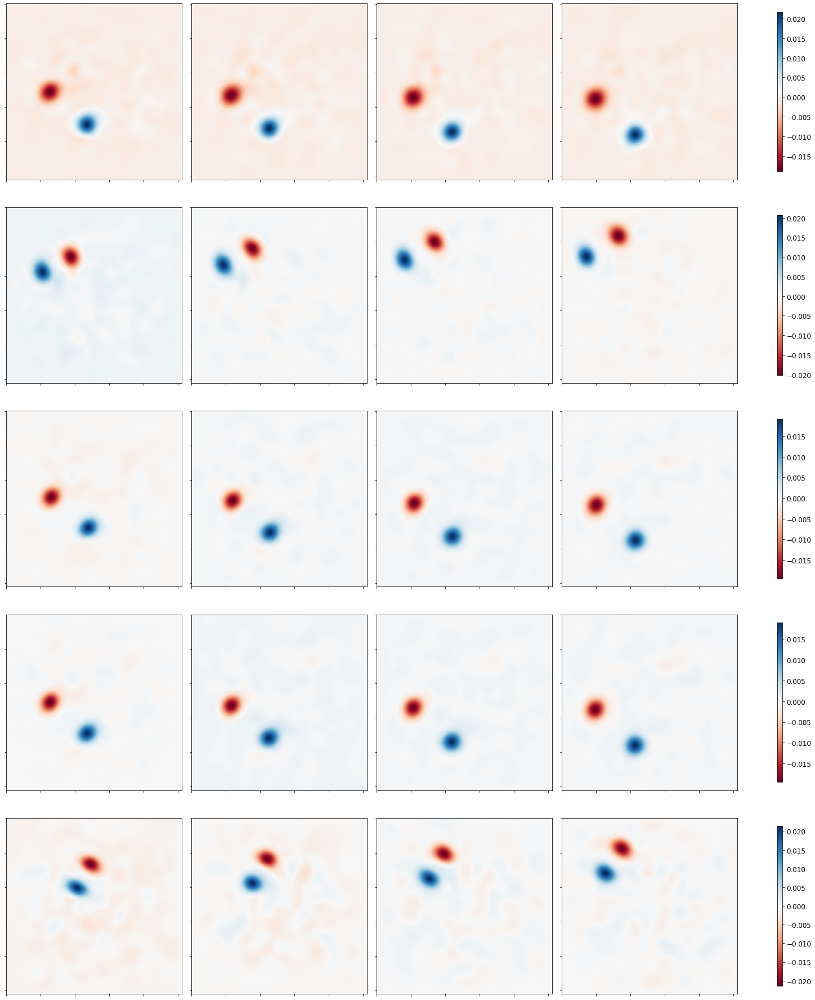

Loss: 


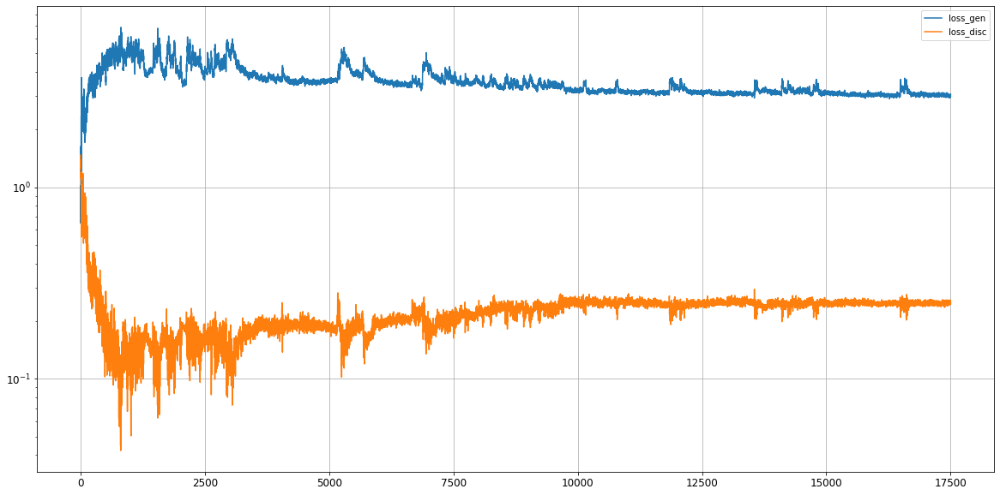

Epoch 17502/50000
discriminator loss:  0.250347 - generator loss:  2.969033 - 3s
Epoch 17503/50000
discriminator loss:  0.250209 - generator loss:  2.991996 - 3s
Epoch 17504/50000
discriminator loss:  0.250275 - generator loss:  2.957650 - 3s
Epoch 17505/50000
discriminator loss:  0.245280 - generator loss:  3.023592 - 3s
Epoch 17506/50000
discriminator loss:  0.247086 - generator loss:  3.029358 - 3s
Epoch 17507/50000
discriminator loss:  0.244704 - generator loss:  3.002880 - 3s
Epoch 17508/50000
discriminator loss:  0.248731 - generator loss:  2.989779 - 3s
Epoch 17509/50000
discriminator loss:  0.246179 - generator loss:  2.971452 - 3s
Epoch 17510/50000
discriminator loss:  0.245580 - generator loss:  3.038120 - 3s
Epoch 17511/50000
discriminator loss:  0.250488 - generator loss:  3.028647 - 3s
Epoch 17512/50000
discriminator loss:  0.253965 - generator loss:  2.971657 - 3s
Epoch 17513/50000
discriminator loss:  0.250608 - generator loss:  3.012570 - 3s
Epoch 17514/50000
discrimina

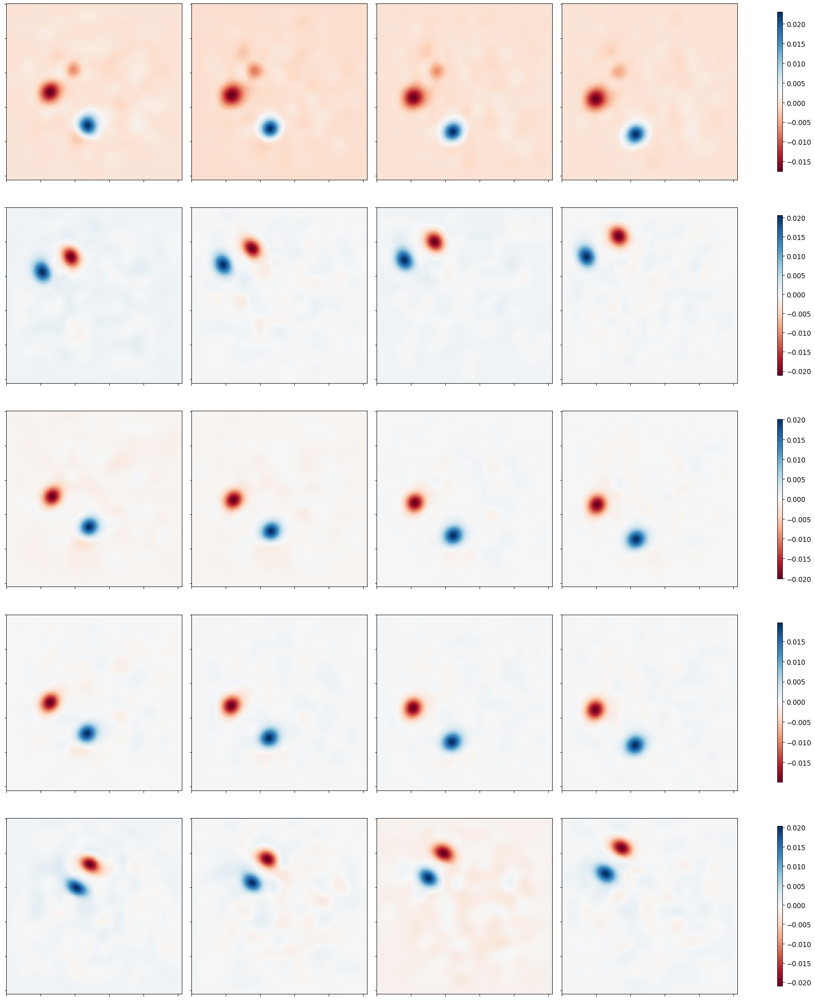

Loss: 


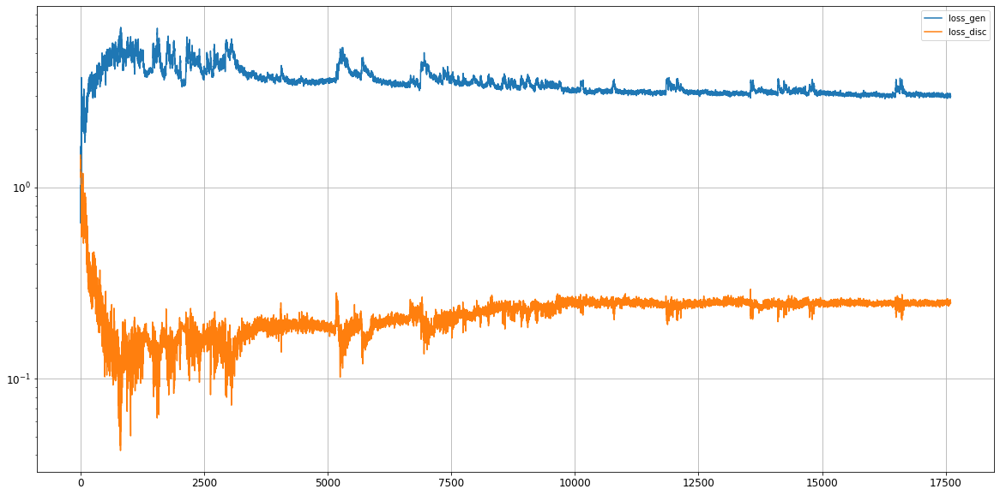

Epoch 17602/50000
discriminator loss:  0.257249 - generator loss:  2.976847 - 3s
Epoch 17603/50000
discriminator loss:  0.249737 - generator loss:  3.054113 - 3s
Epoch 17604/50000
discriminator loss:  0.259937 - generator loss:  2.972282 - 3s
Epoch 17605/50000
discriminator loss:  0.248207 - generator loss:  2.993960 - 3s
Epoch 17606/50000
discriminator loss:  0.253545 - generator loss:  3.026354 - 3s
Epoch 17607/50000
discriminator loss:  0.253376 - generator loss:  2.960857 - 3s
Epoch 17608/50000
discriminator loss:  0.257235 - generator loss:  2.979634 - 3s
Epoch 17609/50000
discriminator loss:  0.253967 - generator loss:  3.013486 - 3s
Epoch 17610/50000
discriminator loss:  0.256901 - generator loss:  3.028957 - 3s
Epoch 17611/50000
discriminator loss:  0.243200 - generator loss:  3.046833 - 3s
Epoch 17612/50000
discriminator loss:  0.258070 - generator loss:  2.980662 - 3s
Epoch 17613/50000
discriminator loss:  0.259273 - generator loss:  2.970630 - 3s
Epoch 17614/50000
discrimina

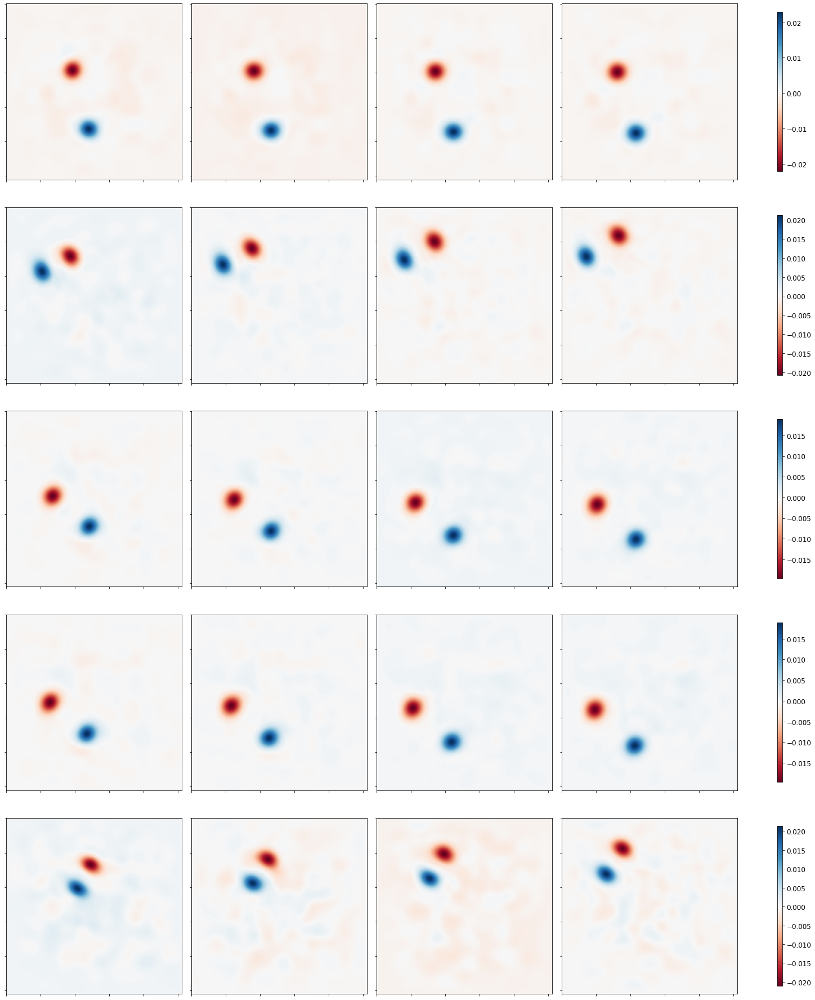

Loss: 


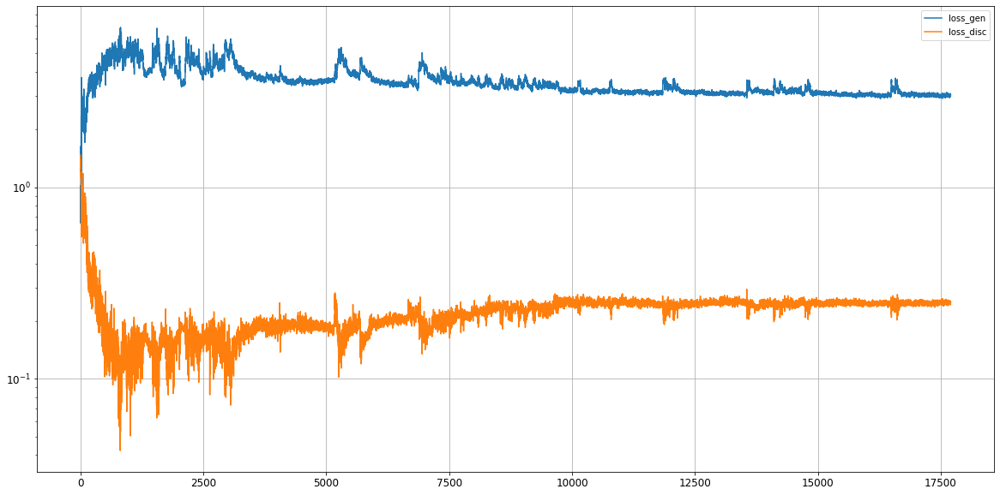

Epoch 17702/50000
discriminator loss:  0.243497 - generator loss:  2.988307 - 3s
Epoch 17703/50000
discriminator loss:  0.252511 - generator loss:  3.018177 - 3s
Epoch 17704/50000
discriminator loss:  0.253874 - generator loss:  3.031367 - 3s
Epoch 17705/50000
discriminator loss:  0.248921 - generator loss:  3.030962 - 3s
Epoch 17706/50000
discriminator loss:  0.254005 - generator loss:  2.959798 - 3s
Epoch 17707/50000
discriminator loss:  0.252713 - generator loss:  2.972219 - 3s
Epoch 17708/50000
discriminator loss:  0.247665 - generator loss:  3.036177 - 3s
Epoch 17709/50000
discriminator loss:  0.251801 - generator loss:  2.989227 - 3s
Epoch 17710/50000
discriminator loss:  0.259312 - generator loss:  2.989023 - 3s
Epoch 17711/50000
discriminator loss:  0.250517 - generator loss:  2.984069 - 3s
Epoch 17712/50000
discriminator loss:  0.246349 - generator loss:  3.012130 - 3s
Epoch 17713/50000
discriminator loss:  0.243576 - generator loss:  3.048703 - 3s
Epoch 17714/50000
discrimina

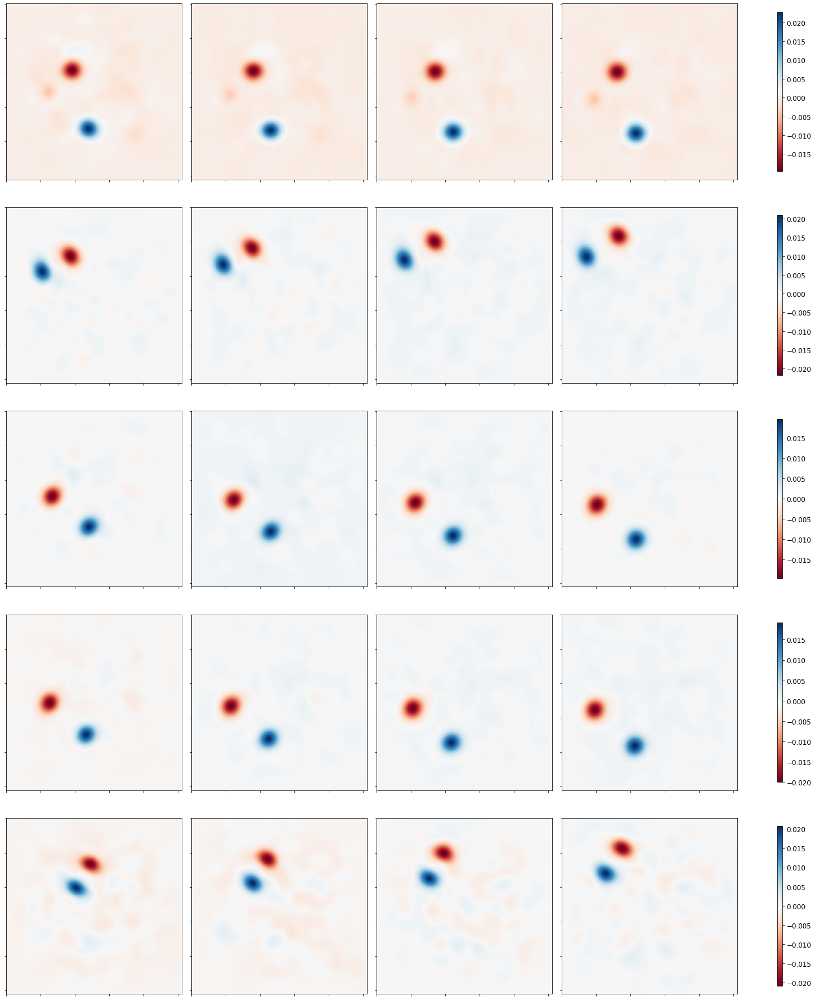

Loss: 


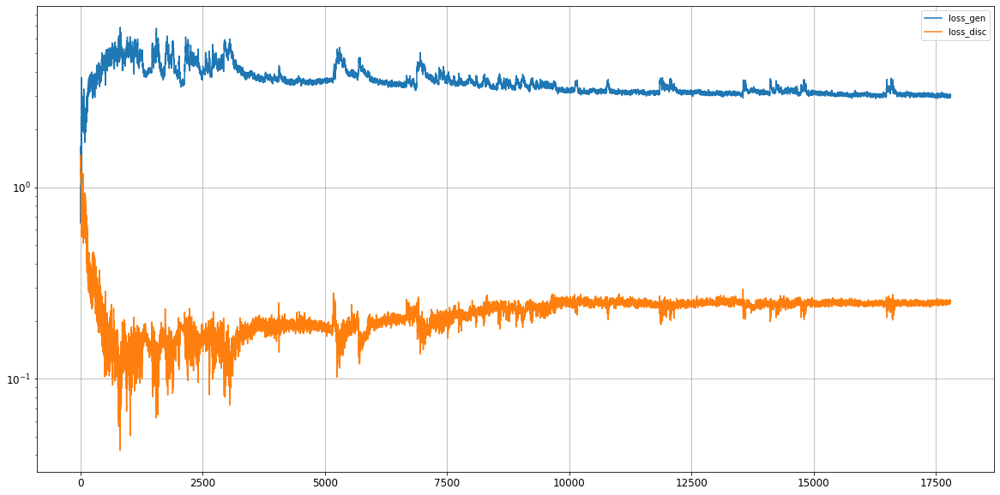

Epoch 17802/50000
discriminator loss:  0.250466 - generator loss:  2.981683 - 3s
Epoch 17803/50000
discriminator loss:  0.254429 - generator loss:  2.940187 - 3s
Epoch 17804/50000
discriminator loss:  0.251388 - generator loss:  2.971994 - 3s
Epoch 17805/50000
discriminator loss:  0.255737 - generator loss:  3.017113 - 3s
Epoch 17806/50000
discriminator loss:  0.256466 - generator loss:  2.970888 - 3s
Epoch 17807/50000
discriminator loss:  0.252164 - generator loss:  2.934238 - 3s
Epoch 17808/50000
discriminator loss:  0.248041 - generator loss:  3.033981 - 3s
Epoch 17809/50000
discriminator loss:  0.253966 - generator loss:  2.950689 - 3s
Epoch 17810/50000
discriminator loss:  0.243016 - generator loss:  2.990875 - 3s
Epoch 17811/50000
discriminator loss:  0.250601 - generator loss:  3.016839 - 3s
Epoch 17812/50000
discriminator loss:  0.248213 - generator loss:  2.980343 - 3s
Epoch 17813/50000
discriminator loss:  0.250194 - generator loss:  3.029579 - 3s
Epoch 17814/50000
discrimina

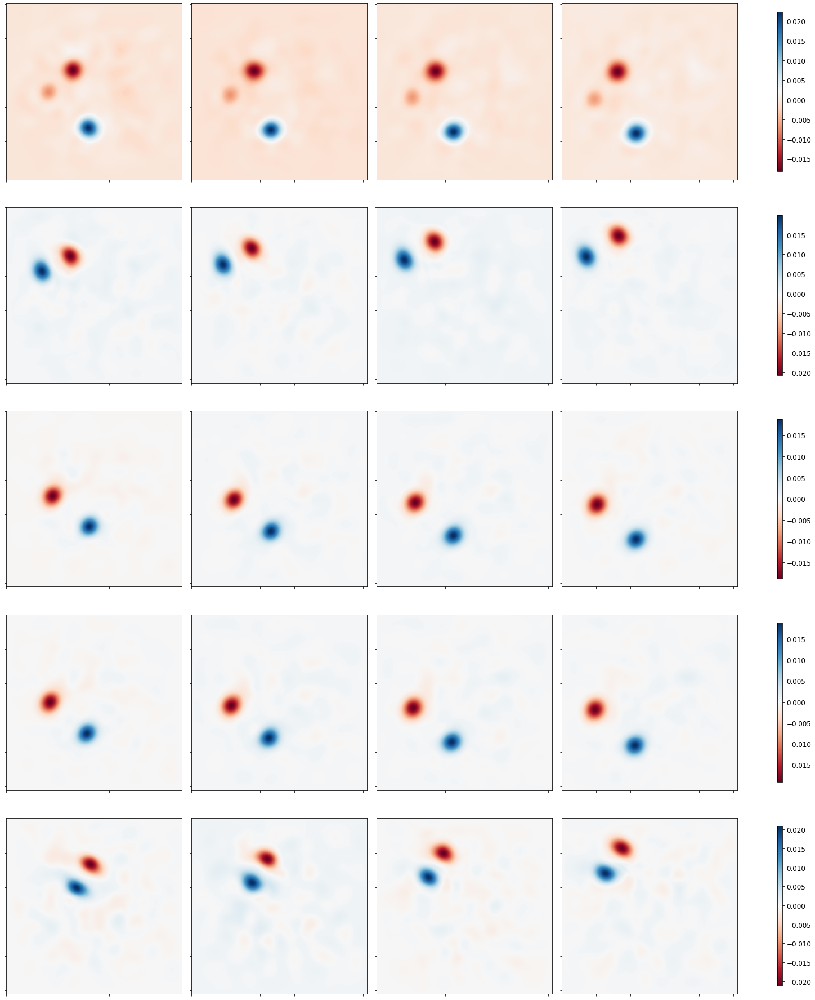

Loss: 


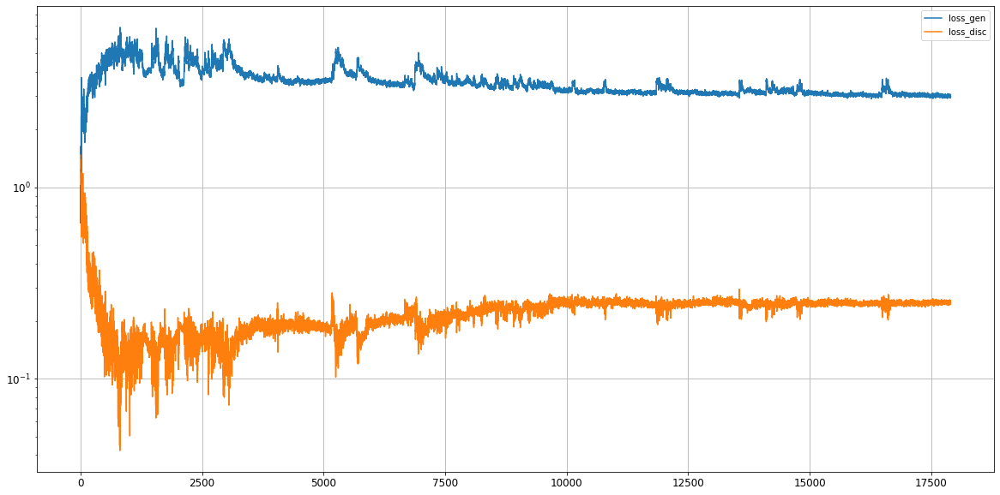

Epoch 17902/50000
discriminator loss:  0.246026 - generator loss:  3.009511 - 3s
Epoch 17903/50000
discriminator loss:  0.245995 - generator loss:  2.963416 - 3s
Epoch 17904/50000
discriminator loss:  0.249560 - generator loss:  3.021347 - 3s
Epoch 17905/50000
discriminator loss:  0.245943 - generator loss:  3.020823 - 3s
Epoch 17906/50000
discriminator loss:  0.246798 - generator loss:  2.992182 - 3s
Epoch 17907/50000
discriminator loss:  0.243253 - generator loss:  3.009959 - 3s
Epoch 17908/50000
discriminator loss:  0.253551 - generator loss:  3.048038 - 3s
Epoch 17909/50000
discriminator loss:  0.251334 - generator loss:  2.998242 - 3s
Epoch 17910/50000
discriminator loss:  0.250439 - generator loss:  2.934925 - 3s
Epoch 17911/50000
discriminator loss:  0.249221 - generator loss:  3.002426 - 3s
Epoch 17912/50000
discriminator loss:  0.247711 - generator loss:  3.001936 - 3s
Epoch 17913/50000
discriminator loss:  0.253765 - generator loss:  2.942566 - 3s
Epoch 17914/50000
discrimina

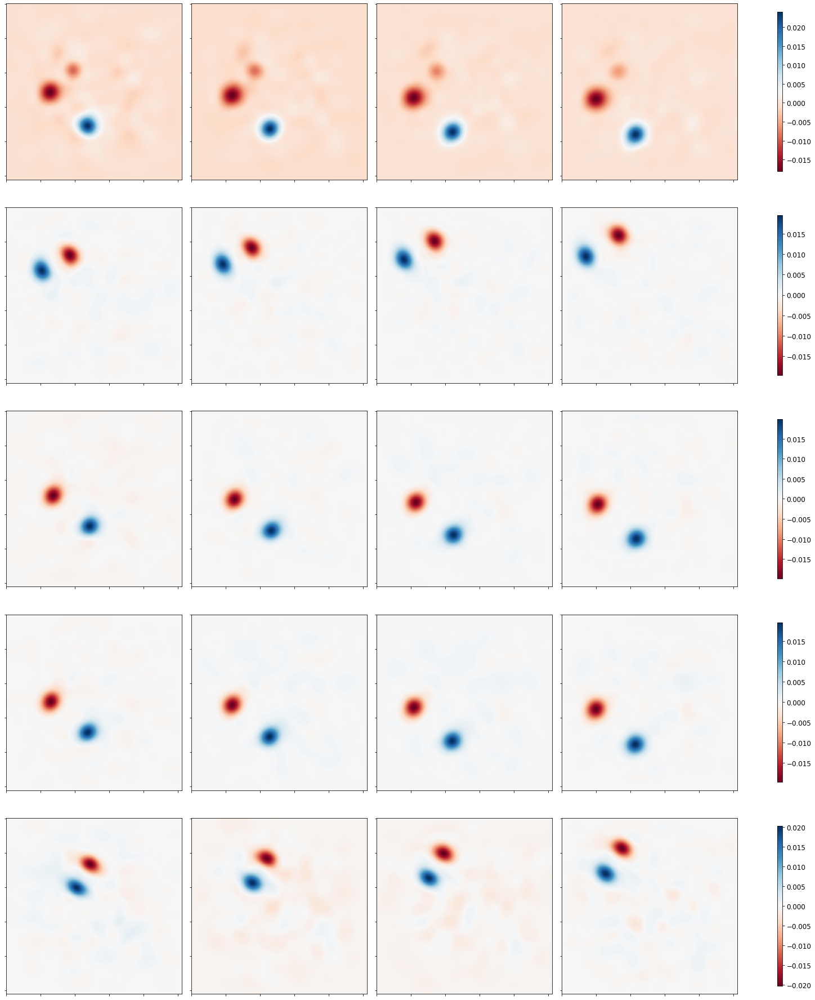

Loss: 


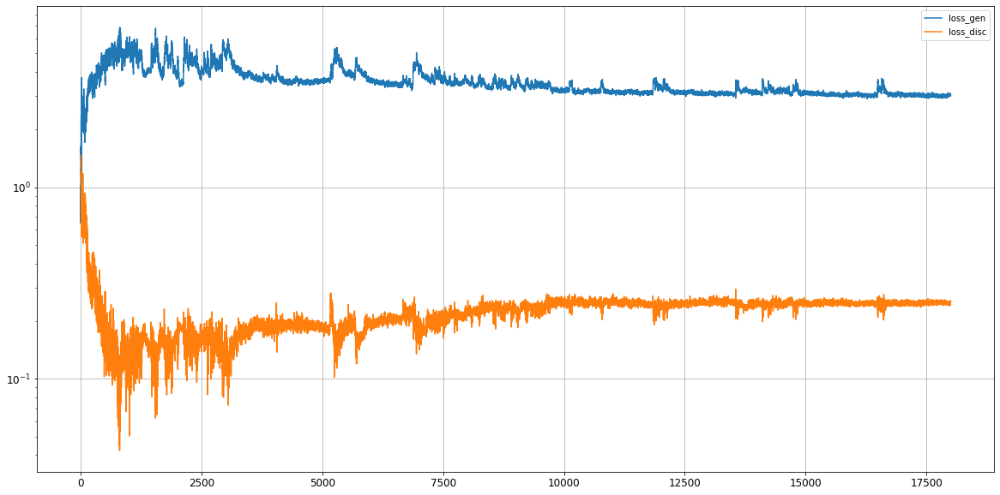

Epoch 18002/50000
discriminator loss:  0.249166 - generator loss:  2.982718 - 3s
Epoch 18003/50000
discriminator loss:  0.245303 - generator loss:  3.038549 - 3s
Epoch 18004/50000
discriminator loss:  0.248298 - generator loss:  2.989703 - 3s
Epoch 18005/50000
discriminator loss:  0.245685 - generator loss:  3.002522 - 3s
Epoch 18006/50000
discriminator loss:  0.251091 - generator loss:  3.015844 - 3s
Epoch 18007/50000
discriminator loss:  0.240660 - generator loss:  2.960087 - 3s
Epoch 18008/50000
discriminator loss:  0.246497 - generator loss:  3.058737 - 3s
Epoch 18009/50000
discriminator loss:  0.250943 - generator loss:  3.033303 - 3s
Epoch 18010/50000
discriminator loss:  0.246590 - generator loss:  3.085047 - 3s
Epoch 18011/50000
discriminator loss:  0.245101 - generator loss:  3.066788 - 3s
Epoch 18012/50000
discriminator loss:  0.247266 - generator loss:  2.992236 - 3s
Epoch 18013/50000
discriminator loss:  0.244997 - generator loss:  3.096666 - 3s
Epoch 18014/50000
discrimina

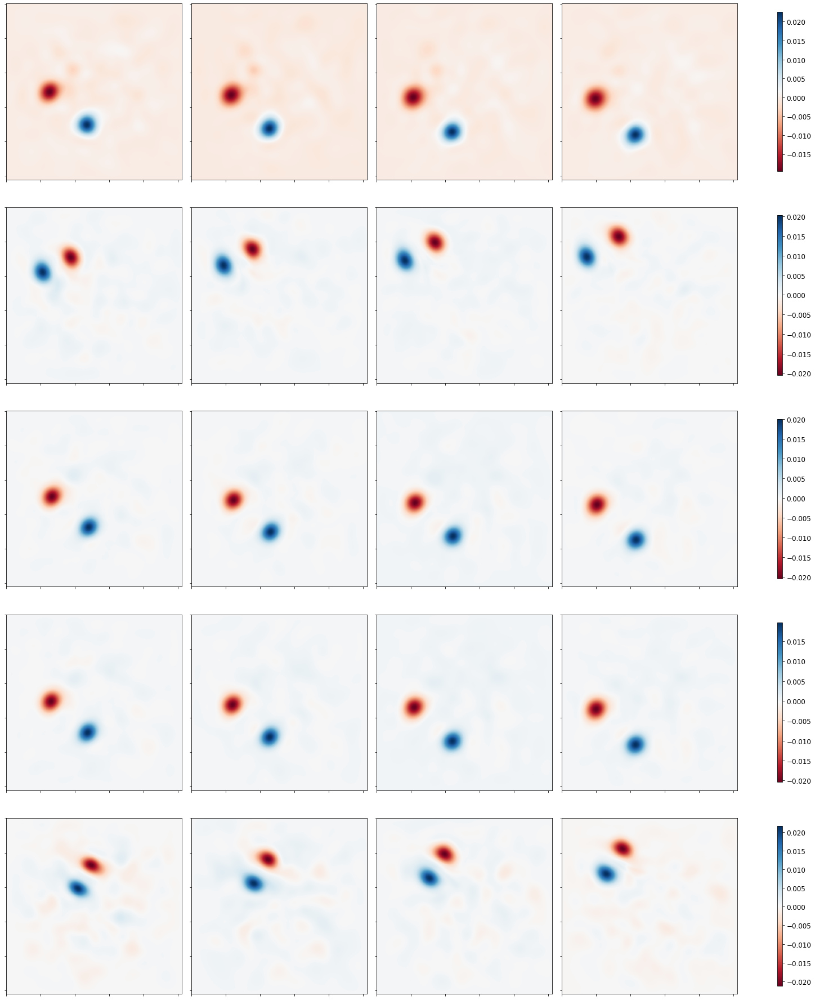

Loss: 


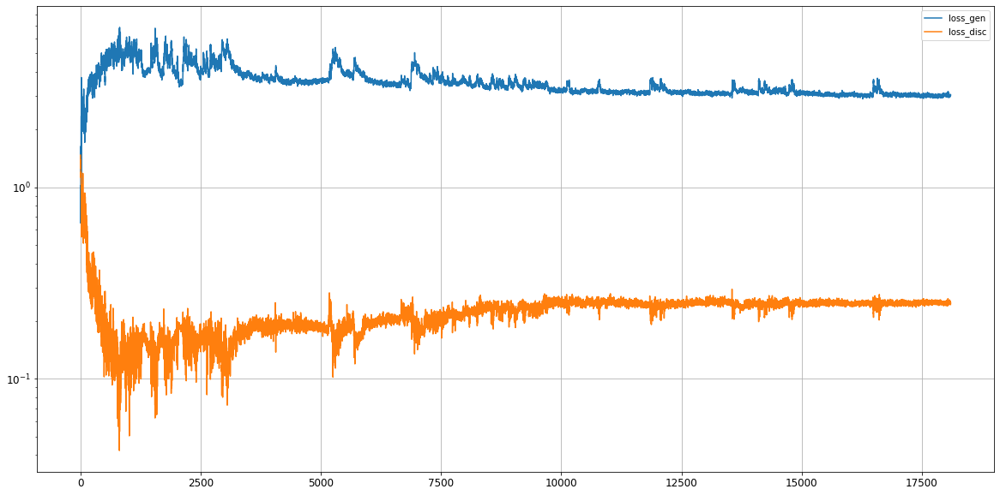

Epoch 18102/50000
discriminator loss:  0.254332 - generator loss:  2.992048 - 3s
Epoch 18103/50000
discriminator loss:  0.252533 - generator loss:  2.976070 - 3s
Epoch 18104/50000
discriminator loss:  0.250342 - generator loss:  3.019833 - 3s
Epoch 18105/50000
discriminator loss:  0.245301 - generator loss:  2.978775 - 3s
Epoch 18106/50000
discriminator loss:  0.251464 - generator loss:  3.002960 - 3s
Epoch 18107/50000
discriminator loss:  0.247819 - generator loss:  3.060607 - 3s
Epoch 18108/50000
discriminator loss:  0.250461 - generator loss:  2.991621 - 3s
Epoch 18109/50000
discriminator loss:  0.239381 - generator loss:  3.062495 - 3s
Epoch 18110/50000
discriminator loss:  0.246629 - generator loss:  3.004119 - 3s
Epoch 18111/50000
discriminator loss:  0.250373 - generator loss:  2.949044 - 3s
Epoch 18112/50000
discriminator loss:  0.243926 - generator loss:  3.036148 - 3s
Epoch 18113/50000
discriminator loss:  0.249358 - generator loss:  3.045382 - 3s
Epoch 18114/50000
discrimina

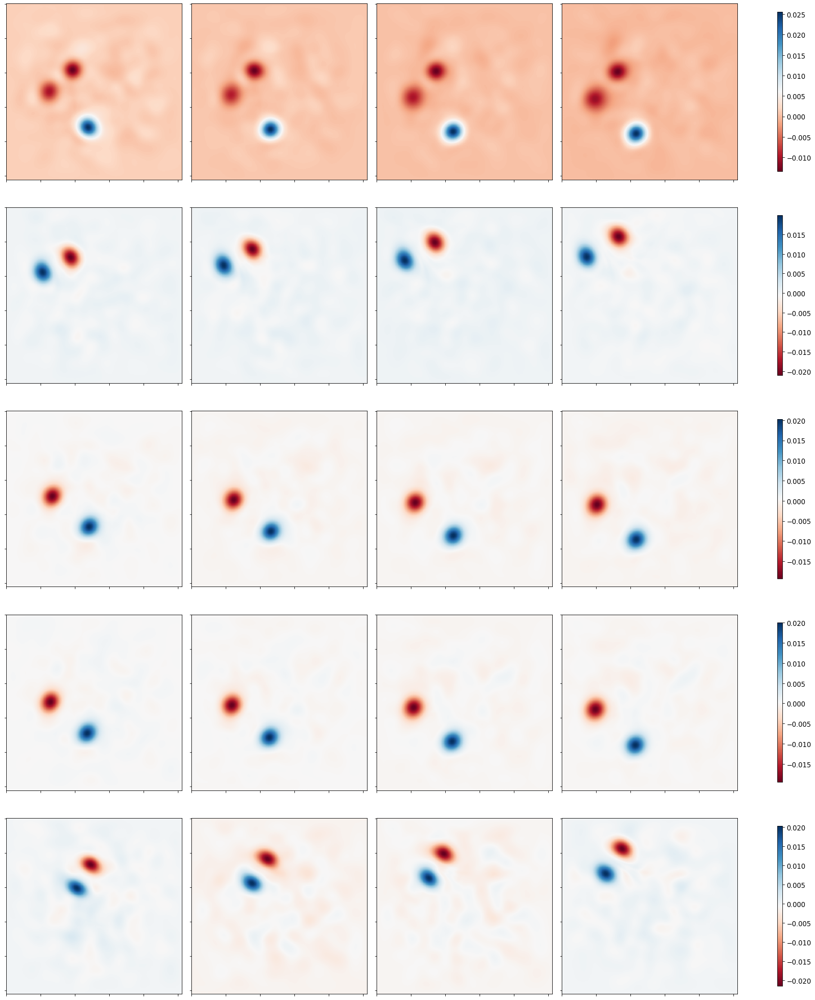

Loss: 


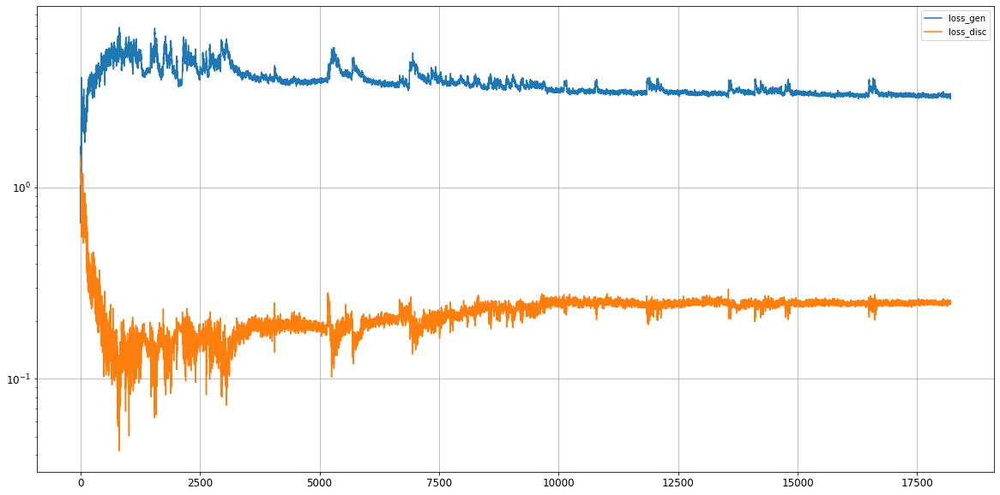

Epoch 18202/50000
discriminator loss:  0.255622 - generator loss:  2.923585 - 3s
Epoch 18203/50000
discriminator loss:  0.251234 - generator loss:  3.023187 - 3s
Epoch 18204/50000
discriminator loss:  0.249767 - generator loss:  2.944029 - 3s
Epoch 18205/50000
discriminator loss:  0.251493 - generator loss:  2.981988 - 3s
Epoch 18206/50000
discriminator loss:  0.251653 - generator loss:  2.980817 - 3s
Epoch 18207/50000
discriminator loss:  0.255469 - generator loss:  2.976171 - 3s
Epoch 18208/50000
discriminator loss:  0.254430 - generator loss:  2.952518 - 3s
Epoch 18209/50000
discriminator loss:  0.252270 - generator loss:  2.960871 - 3s
Epoch 18210/50000
discriminator loss:  0.256252 - generator loss:  2.945226 - 3s
Epoch 18211/50000
discriminator loss:  0.256418 - generator loss:  2.977948 - 3s
Epoch 18212/50000
discriminator loss:  0.255678 - generator loss:  2.948110 - 3s
Epoch 18213/50000
discriminator loss:  0.251386 - generator loss:  2.979412 - 3s
Epoch 18214/50000
discrimina

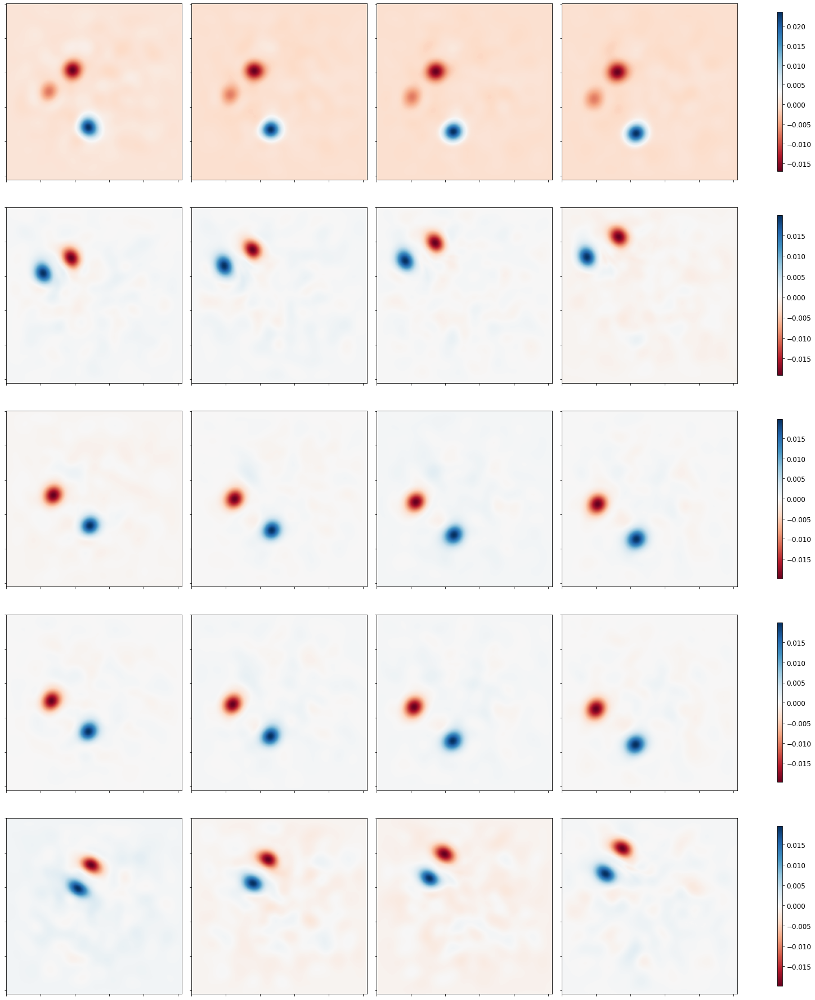

Loss: 


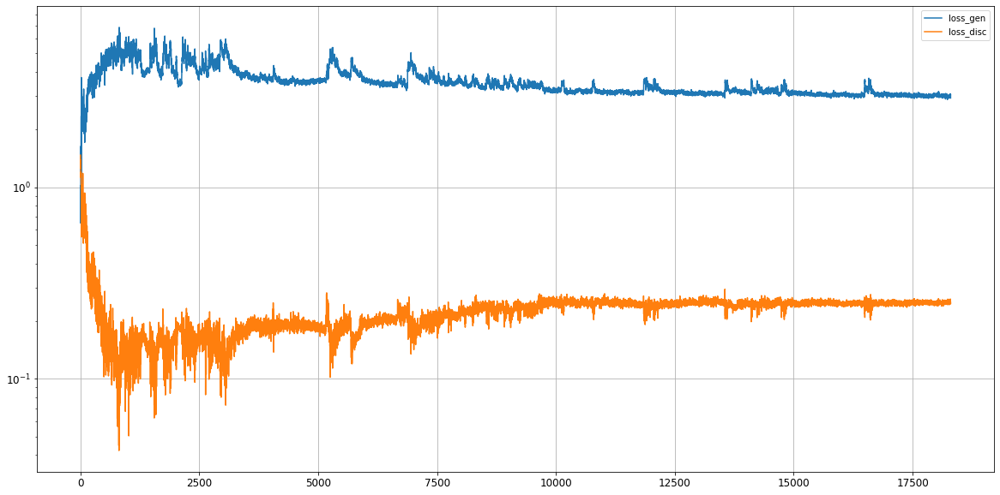

Epoch 18302/50000
discriminator loss:  0.252236 - generator loss:  2.972795 - 3s
Epoch 18303/50000
discriminator loss:  0.252523 - generator loss:  3.038684 - 3s
Epoch 18304/50000
discriminator loss:  0.252873 - generator loss:  2.951710 - 3s
Epoch 18305/50000
discriminator loss:  0.252628 - generator loss:  2.975916 - 3s
Epoch 18306/50000
discriminator loss:  0.253055 - generator loss:  3.018599 - 3s
Epoch 18307/50000
discriminator loss:  0.248411 - generator loss:  3.026294 - 3s
Epoch 18308/50000
discriminator loss:  0.251230 - generator loss:  2.947275 - 3s
Epoch 18309/50000
discriminator loss:  0.253585 - generator loss:  3.020346 - 3s
Epoch 18310/50000
discriminator loss:  0.246749 - generator loss:  3.011562 - 3s
Epoch 18311/50000
discriminator loss:  0.248480 - generator loss:  2.938837 - 3s
Epoch 18312/50000
discriminator loss:  0.253024 - generator loss:  3.040997 - 3s
Epoch 18313/50000
discriminator loss:  0.247656 - generator loss:  2.997773 - 3s
Epoch 18314/50000
discrimina

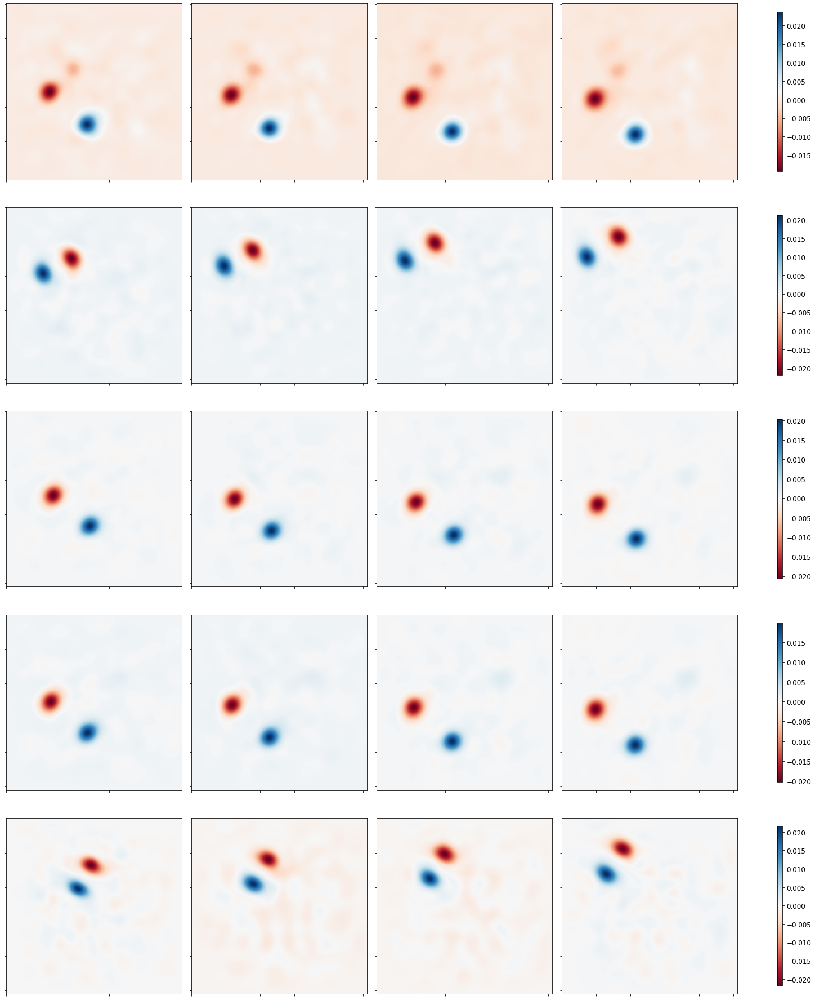

Loss: 


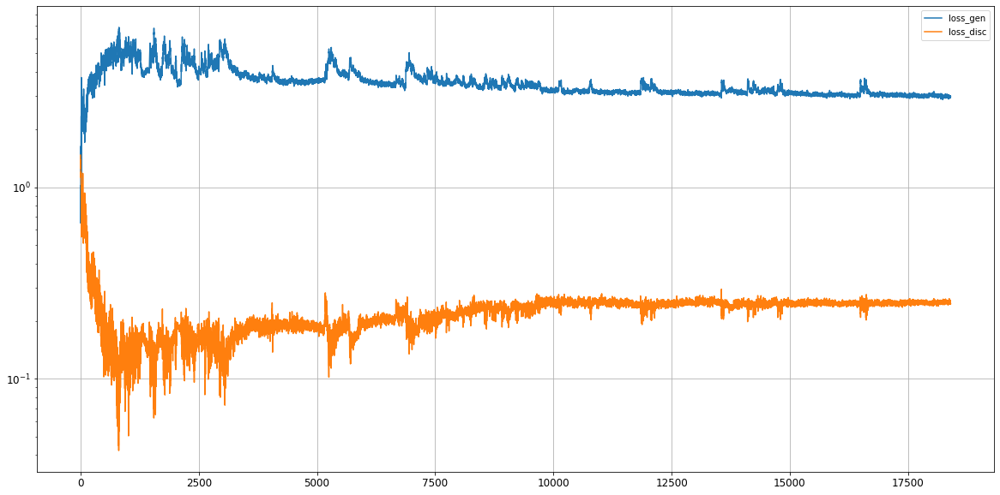

Epoch 18402/50000
discriminator loss:  0.251975 - generator loss:  3.009201 - 3s
Epoch 18403/50000
discriminator loss:  0.250297 - generator loss:  2.951099 - 3s
Epoch 18404/50000
discriminator loss:  0.246420 - generator loss:  2.951321 - 3s
Epoch 18405/50000
discriminator loss:  0.253757 - generator loss:  3.007197 - 3s
Epoch 18406/50000
discriminator loss:  0.254363 - generator loss:  2.940300 - 3s
Epoch 18407/50000
discriminator loss:  0.252686 - generator loss:  2.964202 - 3s
Epoch 18408/50000
discriminator loss:  0.250313 - generator loss:  3.020785 - 3s
Epoch 18409/50000
discriminator loss:  0.255108 - generator loss:  2.958411 - 3s
Epoch 18410/50000
discriminator loss:  0.251661 - generator loss:  2.992527 - 3s
Epoch 18411/50000
discriminator loss:  0.245863 - generator loss:  2.951828 - 3s
Epoch 18412/50000
discriminator loss:  0.246058 - generator loss:  3.059547 - 3s
Epoch 18413/50000
discriminator loss:  0.239623 - generator loss:  2.990582 - 3s
Epoch 18414/50000
discrimina

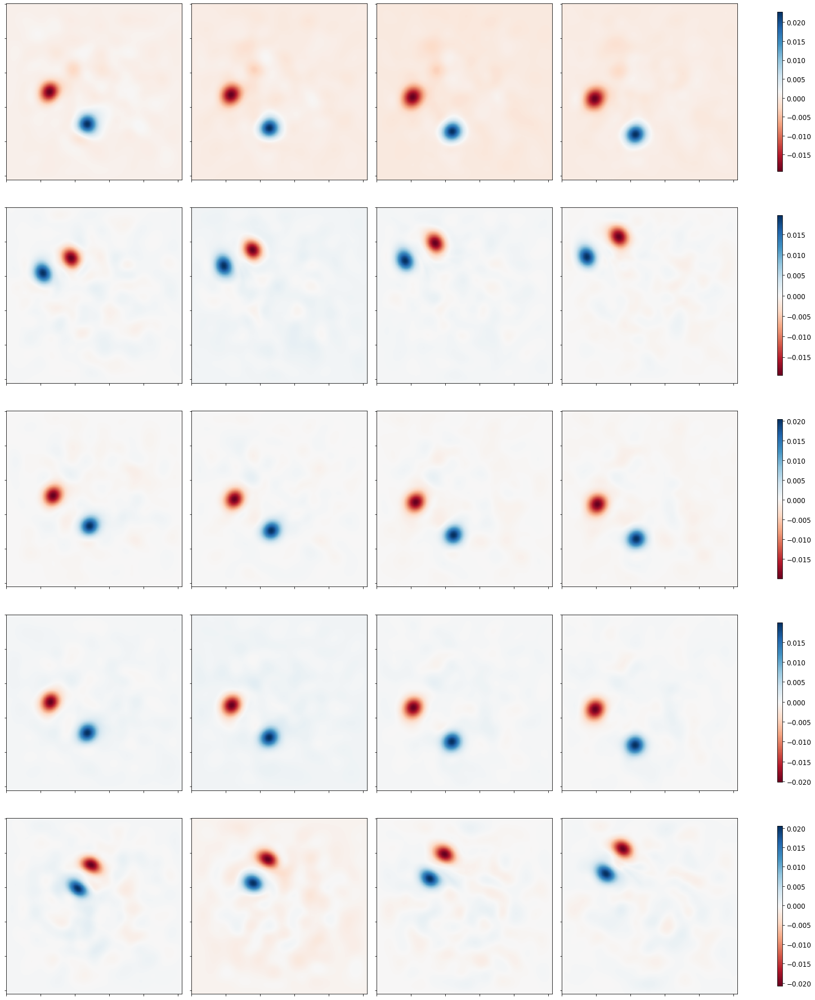

Loss: 


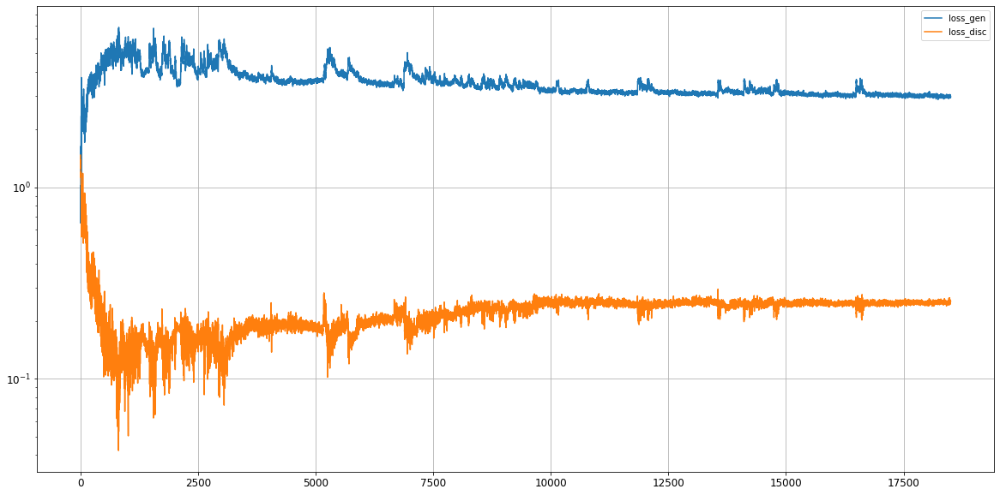

Epoch 18502/50000
discriminator loss:  0.249660 - generator loss:  3.011619 - 3s
Epoch 18503/50000
discriminator loss:  0.258484 - generator loss:  2.938889 - 3s
Epoch 18504/50000
discriminator loss:  0.253063 - generator loss:  2.932054 - 3s
Epoch 18505/50000
discriminator loss:  0.250097 - generator loss:  3.019312 - 3s
Epoch 18506/50000
discriminator loss:  0.259174 - generator loss:  2.911641 - 3s
Epoch 18507/50000
discriminator loss:  0.257415 - generator loss:  2.955564 - 3s
Epoch 18508/50000
discriminator loss:  0.256653 - generator loss:  2.965705 - 3s
Epoch 18509/50000
discriminator loss:  0.250690 - generator loss:  2.945488 - 3s
Epoch 18510/50000
discriminator loss:  0.247690 - generator loss:  2.968518 - 3s
Epoch 18511/50000
discriminator loss:  0.246497 - generator loss:  3.022230 - 3s
Epoch 18512/50000
discriminator loss:  0.240484 - generator loss:  2.937831 - 3s
Epoch 18513/50000
discriminator loss:  0.252239 - generator loss:  3.032847 - 3s
Epoch 18514/50000
discrimina

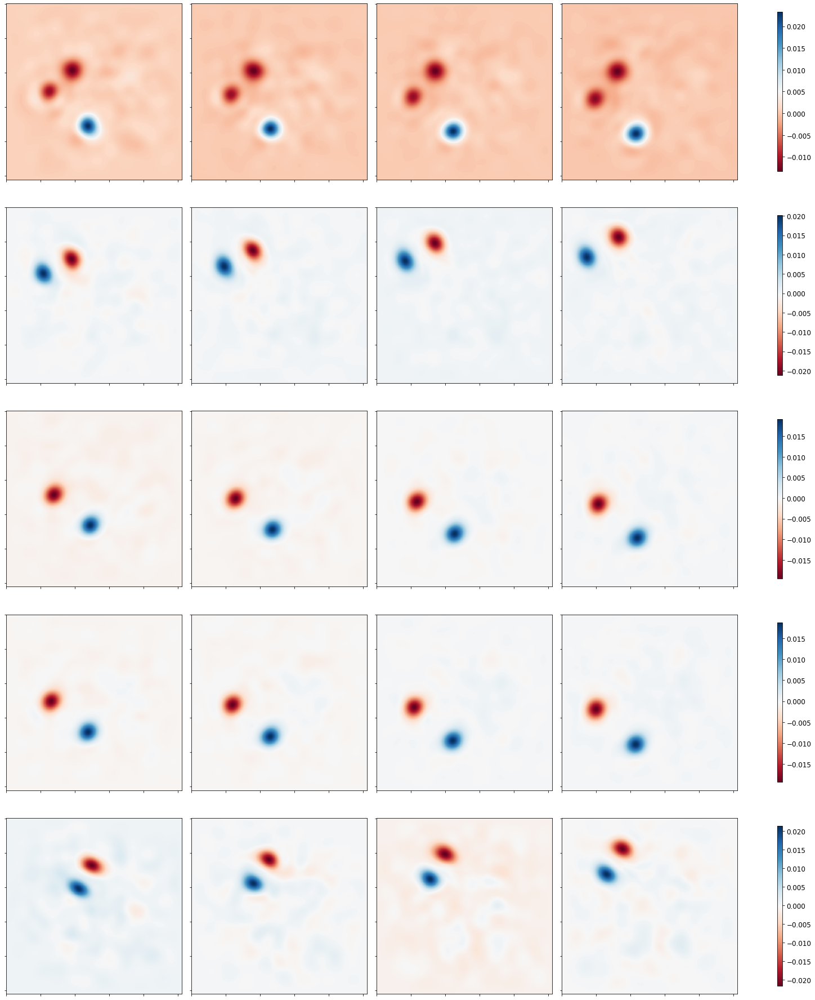

Loss: 


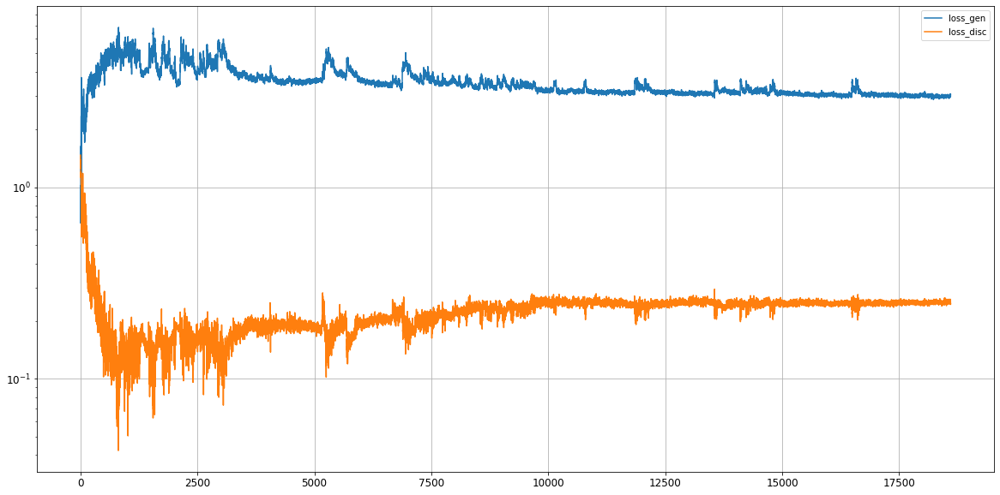

Epoch 18602/50000
discriminator loss:  0.250242 - generator loss:  2.992110 - 3s
Epoch 18603/50000
discriminator loss:  0.252358 - generator loss:  3.020850 - 3s
Epoch 18604/50000
discriminator loss:  0.251459 - generator loss:  3.019624 - 3s
Epoch 18605/50000
discriminator loss:  0.256812 - generator loss:  2.988573 - 3s
Epoch 18606/50000
discriminator loss:  0.252361 - generator loss:  2.963662 - 3s
Epoch 18607/50000
discriminator loss:  0.247331 - generator loss:  2.994693 - 3s
Epoch 18608/50000
discriminator loss:  0.249517 - generator loss:  3.018584 - 3s
Epoch 18609/50000
discriminator loss:  0.248613 - generator loss:  3.001316 - 3s
Epoch 18610/50000
discriminator loss:  0.252155 - generator loss:  3.037874 - 3s
Epoch 18611/50000
discriminator loss:  0.262310 - generator loss:  3.017484 - 3s
Epoch 18612/50000
discriminator loss:  0.245855 - generator loss:  3.033290 - 3s
Epoch 18613/50000
discriminator loss:  0.256478 - generator loss:  2.965811 - 3s
Epoch 18614/50000
discrimina

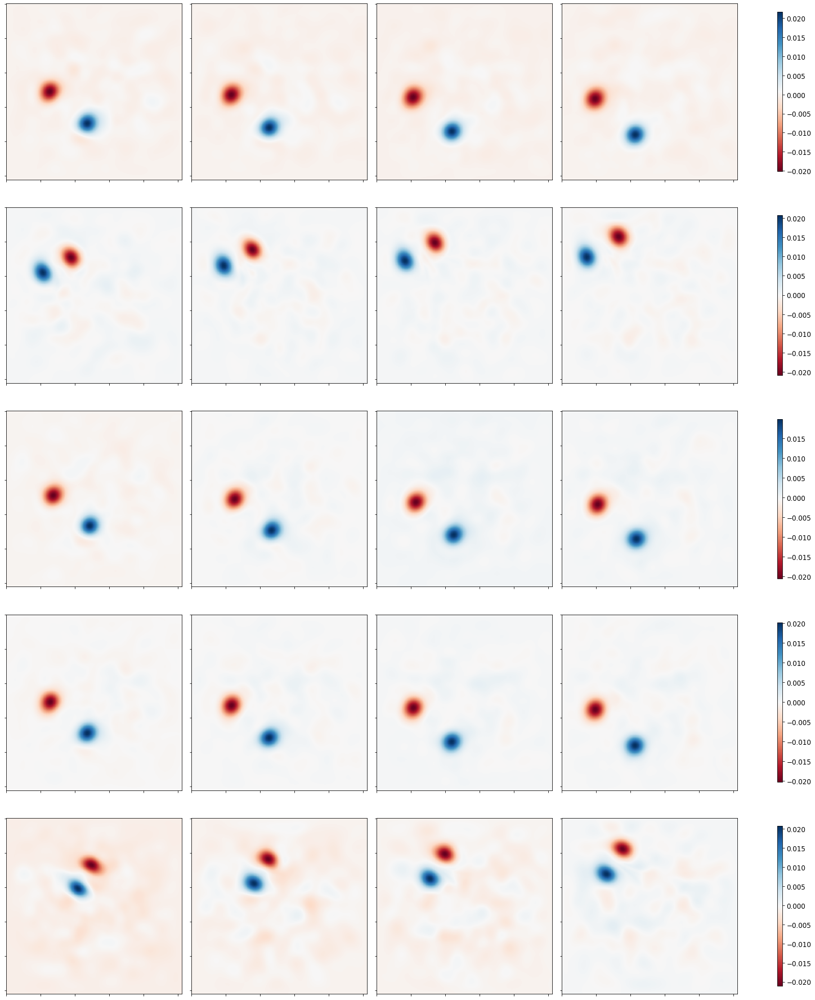

Loss: 


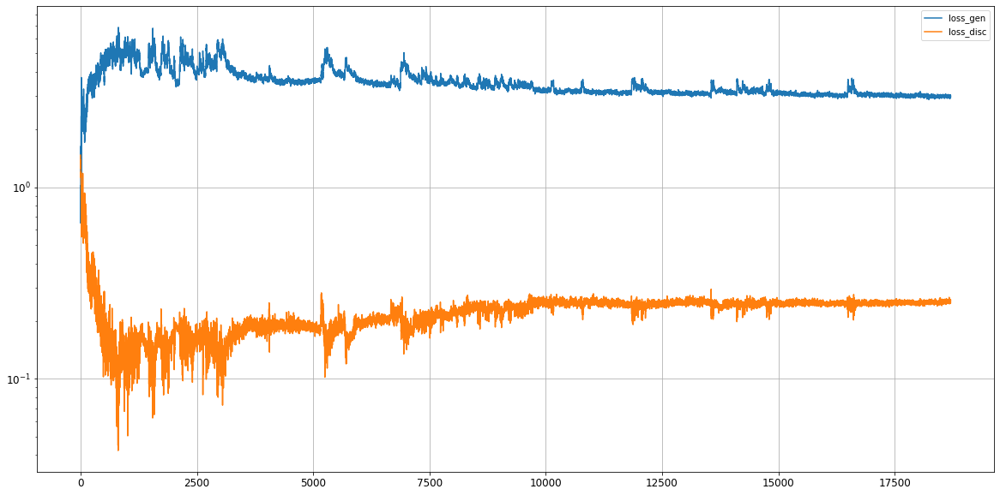

Epoch 18702/50000
discriminator loss:  0.256835 - generator loss:  2.977898 - 3s
Epoch 18703/50000
discriminator loss:  0.255199 - generator loss:  3.019323 - 3s
Epoch 18704/50000
discriminator loss:  0.260100 - generator loss:  2.907133 - 3s
Epoch 18705/50000
discriminator loss:  0.255186 - generator loss:  2.984576 - 3s
Epoch 18706/50000
discriminator loss:  0.248030 - generator loss:  2.998018 - 3s
Epoch 18707/50000
discriminator loss:  0.261988 - generator loss:  2.970557 - 3s
Epoch 18708/50000
discriminator loss:  0.251393 - generator loss:  2.936334 - 3s
Epoch 18709/50000
discriminator loss:  0.252025 - generator loss:  2.986654 - 3s
Epoch 18710/50000
discriminator loss:  0.250879 - generator loss:  3.034800 - 3s
Epoch 18711/50000
discriminator loss:  0.256091 - generator loss:  2.949033 - 3s
Epoch 18712/50000
discriminator loss:  0.254369 - generator loss:  3.017088 - 3s
Epoch 18713/50000
discriminator loss:  0.255259 - generator loss:  2.905637 - 3s
Epoch 18714/50000
discrimina

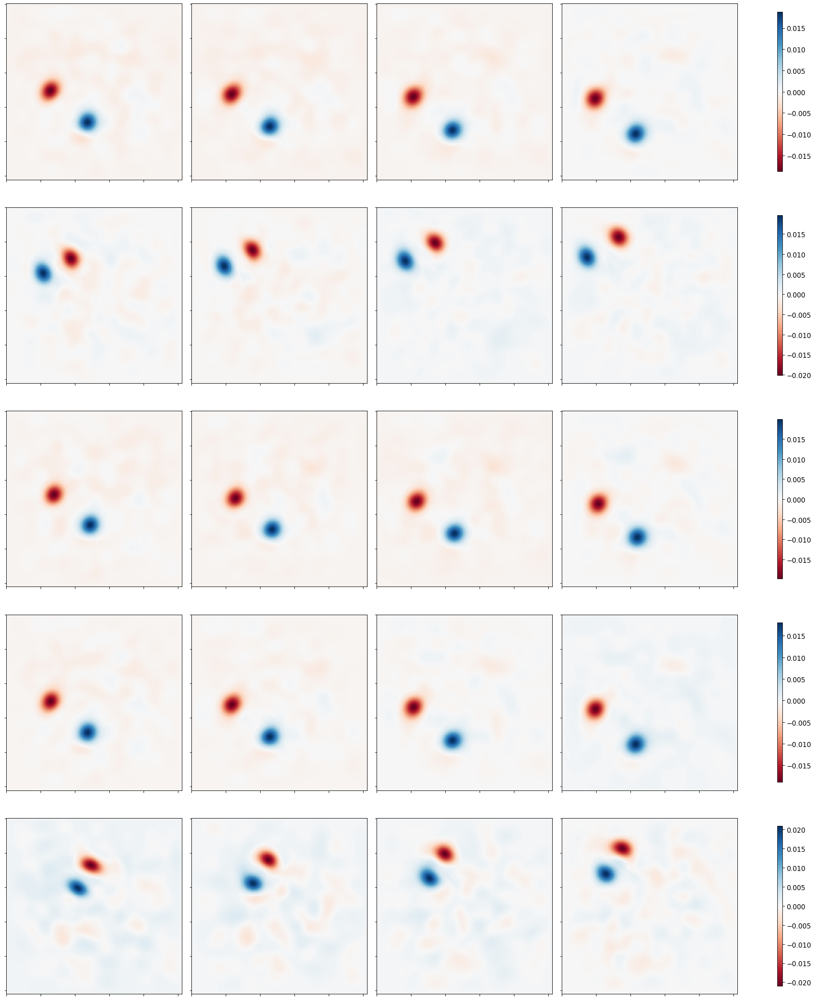

Loss: 


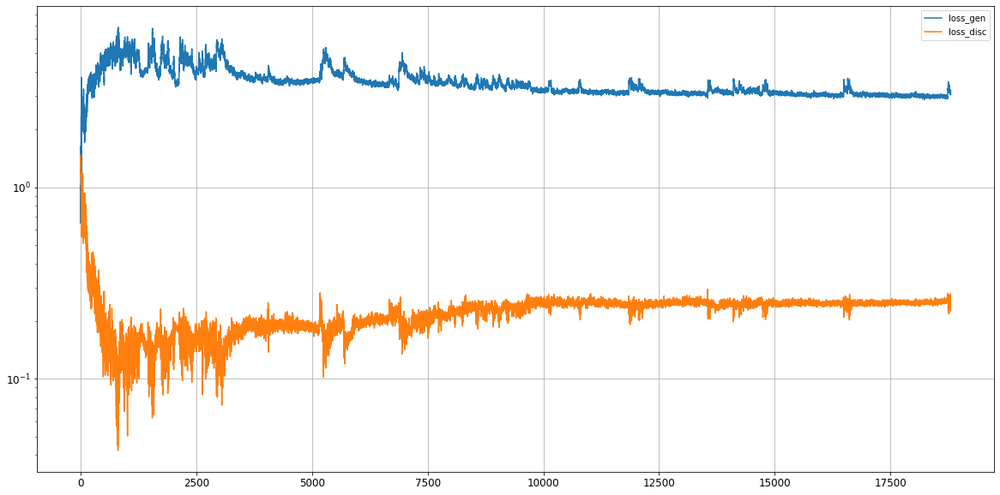

Epoch 18802/50000
discriminator loss:  0.255568 - generator loss:  3.062978 - 3s
Epoch 18803/50000
discriminator loss:  0.251790 - generator loss:  3.137056 - 3s
Epoch 18804/50000
discriminator loss:  0.259959 - generator loss:  3.114166 - 3s
Epoch 18805/50000
discriminator loss:  0.256913 - generator loss:  3.031707 - 3s
Epoch 18806/50000
discriminator loss:  0.266783 - generator loss:  3.106818 - 3s
Epoch 18807/50000
discriminator loss:  0.254138 - generator loss:  3.090239 - 3s
Epoch 18808/50000
discriminator loss:  0.243830 - generator loss:  3.235315 - 3s
Epoch 18809/50000
discriminator loss:  0.265614 - generator loss:  3.062327 - 3s
Epoch 18810/50000
discriminator loss:  0.255779 - generator loss:  3.148658 - 3s
Epoch 18811/50000
discriminator loss:  0.254758 - generator loss:  3.039962 - 3s
Epoch 18812/50000
discriminator loss:  0.251941 - generator loss:  3.092008 - 3s
Epoch 18813/50000
discriminator loss:  0.249701 - generator loss:  3.112385 - 3s
Epoch 18814/50000
discrimina

FailedPreconditionError: ignored

In [ ]:
import time
hist = train(train_dataset, epochs=50000)

### Unrolled DCGAN 

Generator Model

In [ ]:
def make_generator_model():
    # model = tf.keras.Sequential()
    # model.add(keras.layers.Dense(5*73*256, use_bias=False, input_shape=(latent_space,)))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Reshape((5, 73, 256)))

    # model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    
    #alt architecture
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
  

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3)) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))


    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3), padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 30720)             92160000  
_________________________________________________________________
batch_normalization_3 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 30720)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_4 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 5, 12, 256)       

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


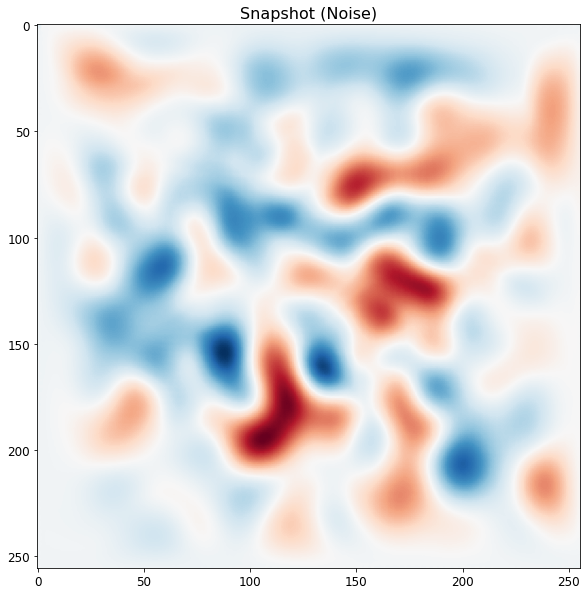

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Discriminator

In [ ]:

def make_discriminator_model():

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 4, 146, 64)        1664      
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 4, 146, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_9 (LeakyReLU)    (None, 2, 73, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 2, 73, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 1, 37, 128)       

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[1.818499e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

Cost Function and Optimization

In [ ]:
from collections import OrderedDict
_graph_replace = tf.contrib.graph_editor.graph_replace

def remove_original_op_attributes(graph):
    """Remove _original_op attribute from all operations in a graph."""
    for op in graph.get_operations():
        op._original_op = None
        
def graph_replace(*args, **kwargs):
    """Monkey patch graph_replace so that it works with TF 1.0"""
    remove_original_op_attributes(tf.get_default_graph())
    return _graph_replace(*args, **kwargs)

TensorFlow is already loaded. Please restart the runtime to change versions.


AttributeError: ignored

In [ ]:
def extract_update_dict(update_ops):
    """Extract variables and their new values from Assign and AssignAdd ops.
    
    Args:
        update_ops: list of Assign and AssignAdd ops, typically computed using Keras' opt.get_updates()

    Returns:
        dict mapping from variable values to their updated value
    """
    name_to_var = {v.name: v for v in tf.global_variables()}
    updates = OrderedDict()
    for update in update_ops:
        var_name = update.op.inputs[0].name
        var = name_to_var[var_name]
        value = update.op.inputs[1]
        if update.op.type == 'Assign':
            updates[var.value()] = value
        elif update.op.type == 'AssignAdd':
            updates[var.value()] = var + value
        else:
            raise ValueError("Update op type (%s) must be of type Assign or AssignAdd"%update_op.op.type)
    return updates

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def generator_loss(disc_loss, disc_updates, unrolled_steps):

  # update_dict contains a dictionary mapping from variables (\theta_D^0)
  # to their values after one step of optimization (\theta_D^1)
  update_dict = extract_update_dict(disc_updates)
  cur_update_dict = update_dict
  for i in xrange(unrolled_steps-1):
    # Compute variable updates given the previous iteration's updated variable
    cur_update_dict = graph_replace(update_dict, cur_update_dict)
  # Final unrolled loss uses the parameters at the last time step
  fake_loss = graph_replace(disc_loss, cur_update_dict)
  return fake_loss

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

# Optimizers for generator and optimizer models

generator_optimizer = tf.keras.optimizers.Adam(learning_rate=g_lr)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=d_lr)


In [ ]:
# logs to document losses
version_num = 'E3000_16b_UGAN'
# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: ', g_lr, '(gen),', d_lr, '(disc)')
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_16b_UGAN
POD coeffiecients:  292
Batch size:  16
Learning Rate:  0.0001 (gen), 0.0001 (disc)
Instances:  7
Time steps:  5


Training step

In [ ]:
@tf.function
def train_step(batch, unrolled_steps):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    # Discriminator training 
    with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        disc_loss = discriminator_loss(real_output, fake_output)
      
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    discriminator_mean_loss(disc_loss)
    
    # Generator training
    with tf.GradientTape() as gen_tape:
        # Unrolled Loss (applies to generator)
        gen_unrolled_loss = generator_loss(disc_loss, gradients_of_discriminator, unrolled_steps)

    gradients_of_generator = gen_tape.gradient(-gen_unrolled_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    generator_mean_loss(gen_unrolled_loss)

Training loop

In [ ]:
def train(dataset, epochs, unrolled_steps):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch, unrolled_steps)
            
        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        

        print("discriminator loss: ", "{:.6f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.6f}".format(hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show()  
        
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
            
        if epoch%1000 == 0:            
          # Save model once greater that 10,000 iterations 
          gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                        str(num_of_coeff)+'_'+str(epoch)+'.h5')  
    return hist


In [ ]:
import time
hist = train(train_dataset, epochs=50000, unrolled_steps=10)

### Improved GAN (Mininbatch Discrimination) copy from predgan_saved copy

# Prediction with GAN

### Sample generation

In [30]:
from tensorflow.keras import backend as K
from tensorflow.keras.layers import InputSpec, Layer
from tensorflow.keras import initializers, regularizers, constraints

class MinibatchDiscrimination(Layer):
  def __init__(self, nb_kernels, kernel_dim, init='glorot_uniform', weights=None,
                W_regularizer=None, activity_regularizer=None,
                W_constraint=None, input_dim=None, **kwargs):
      self.init = initializers.get(init)
      self.nb_kernels = nb_kernels
      self.kernel_dim = kernel_dim
      self.input_dim = input_dim

      self.W_regularizer = regularizers.get(W_regularizer)
      self.activity_regularizer = regularizers.get(activity_regularizer)

      self.W_constraint = constraints.get(W_constraint)

      self.initial_weights = weights
      self.input_spec = [InputSpec(ndim=2)]

      if self.input_dim:
          kwargs['input_shape'] = (self.input_dim,)
      super(MinibatchDiscrimination, self).__init__(**kwargs)

  def build(self, input_shape):
      assert len(input_shape) == 2

      input_dim = input_shape[1]
      self.input_spec = [InputSpec(dtype=K.floatx(),
                                    shape=(None, input_dim))]

      self.W = self.add_weight(shape=(self.nb_kernels, input_dim, self.kernel_dim),
          initializer=self.init,
          name='kernel',
          regularizer=self.W_regularizer,
          trainable=True,
          constraint=self.W_constraint)

      # Set built to true.
      super(MinibatchDiscrimination, self).build(input_shape)

  def call(self, x, mask=None):
      activation = K.reshape(K.dot(x, self.W), (-1, self.nb_kernels, self.kernel_dim))
      diffs = K.expand_dims(activation, 3) - K.expand_dims(K.permute_dimensions(activation, [1, 2, 0]), 0)
      #in_shape = tf.Variable(BATCH_SIZE)
      abs_diffs = K.sum(K.abs(diffs), axis=2)
      if x.shape[0] != None:
        abs_diffs += 1e6*K.expand_dims(K.eye(x.shape[0]), 1)
      minibatch_features = K.sum(K.exp(-abs_diffs), axis=2)
      return K.concatenate([x, minibatch_features], 1)

  def compute_output_shape(self, input_shape):
      assert input_shape and len(input_shape) == 2
      return input_shape[0], input_shape[1]+self.nb_kernels

  def get_config(self):
      config = {'nb_kernels': self.nb_kernels,
                  'kernel_dim': self.kernel_dim,
                  'init': self.__init__.__name__,
                  'W_regularizer': self.W_regularizer.get_config() if self.W_regularizer else None,
                  'activity_regularizer': self.activity_regularizer.get_config() if self.activity_regularizer else None,
                  'W_constraint': self.W_constraint.get_config() if self.W_constraint else None,
                  'input_dim': self.input_dim}
      base_config = super(MinibatchDiscrimination, self).get_config()
      return dict(list(base_config.items()) + list(config.items()))

In [39]:
# loading modesl with custom layers
from tensorflow.keras.models import load_model
from tensorflow.python.keras.initializers import glorot_uniform
model_dir = 'ganmodels/model_vE3000_minibatch1_292_5000.h5'
custom_objects={'MinibatchDiscrimination': MinibatchDiscrimination, '__init__':glorot_uniform()}
with tf.keras.utils.custom_object_scope(custom_objects):
  generator, discriminator = load_model(SAVE_DIR + model_dir).layers

np.random.seed(99)
tf.random.set_seed(99)


(28, 65536)


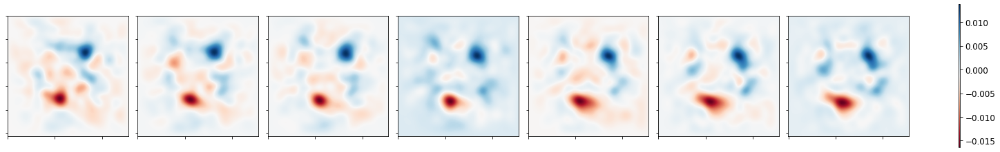

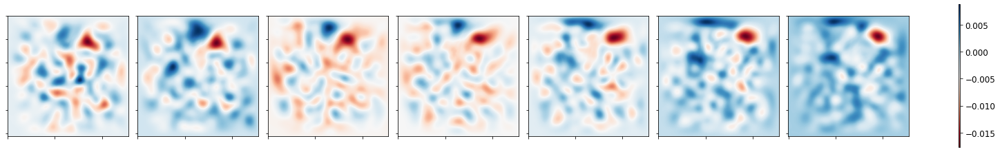

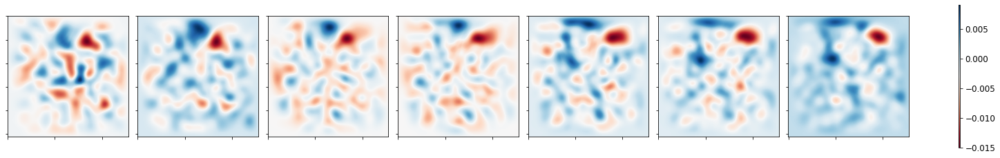

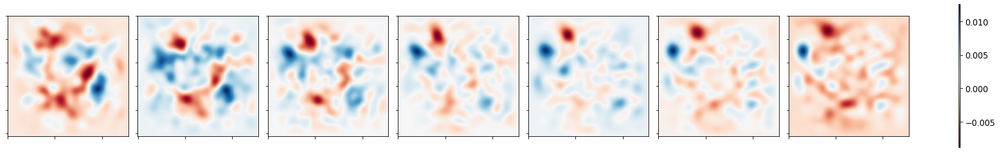

In [44]:

npredict = 4
latent_size = 3000
pred_time_len = 7
ntimes = 7
noise = tf.random.normal(shape=[npredict, latent_size])
X_generated = generator.predict(noise).reshape(-1, num_of_coeff)
X_generated = invert_data(X_generated)
print(X_generated.shape)
X_generated = X_generated.reshape(npredict, ntimes, nx, nx)

for j in range(npredict):
  fig, ax = plt.subplots(1, pred_time_len, figsize=[20, 16], constrained_layout=True)
  for i in range(pred_time_len):
    im = ax.flatten()[i].imshow(X_generated[j][i,:,:], cmap='RdBu')
    ax[i].set_xticklabels([]), ax[i].set_yticklabels([])
  fig.colorbar(im, ax=ax[:], location='right', shrink=0.18, pad=0.05)
  plt.show() 


### Number of Statistically Different Bins (NDB score) 

Mode collapse test based on [2018 paper by Richardson and Weiss](https://arxiv.org/abs/1805.12462)

Steps:
1. Use K-means clustering to divide the training samples into K diffrenet bins.

2. Take the test samples and allocate into the closest bins (based on L2 distance from one of the K centroids).

3. For each bin, condduct a 2-sample test between trainig and test data to obtain a z-score. If this score is smaller than a set threshold value, then mark bin as statistically different.

4. Coun total number of statisticaly different bins and divide by K to get NDB score.

In [ ]:
discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 6, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 6, 146, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 6, 146, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 3, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 3, 73, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 3, 73, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 2, 37, 64)        

In [ ]:
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 30720)             61440000  
_________________________________________________________________
batch_normalization_5 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 30720)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_6 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 5, 12, 256)       

### Predict a point in time 

In [ ]:
weight = tf.constant(pca.singular_values_, dtype=tf.float32)
weight.shape

TensorShape([292])

In [ ]:
codings_size = num_of_coeff
mse = tf.keras.losses.MeanSquaredError()
mae = tf.keras.losses.MeanAbsoluteError()
optimizer = tf.keras.optimizers.Adam(2e-4)

def mse_loss(inp, outp, loss_weight):
    inp = tf.reshape(inp, [-1, codings_size]) #*tf.math.sqrt(loss_weight)
    outp = tf.reshape(outp, [-1, codings_size]) # *tf.math.sqrt(loss_weight)
    return mse(inp, outp)

def mae_loss(inp, outp, loss_weight):
    inp = tf.reshape(inp, [-1, codings_size])*loss_weight
    outp = tf.reshape(outp, [-1, codings_size])*loss_weight
    return mae(inp, outp)

In [ ]:
@tf.function
def opt_step(latent_values, real_coding, loss_weight):
    with tf.GradientTape() as tape:
        tape.watch(latent_values)
        gen_output = generator(latent_values, training=False)  #results from generator
        loss = mae_loss(real_coding, gen_output[:,:(ntimes - 1),:,:], loss_weight)   
        #codings_size is size of each output, ntimes is number of time levels. 
        #If training for 9 time levels, it finds the loss between the first 8 outputs from the generator and 8 real outputs

    gradient = tape.gradient(loss, latent_values)   #gradient of the loss ws to the input
    optimizer.apply_gradients(zip([gradient], [latent_values]))   #applies gradients to the input
    
    return loss

In [ ]:
def optimize_coding(real_coding, loss_weight, opt_epochs):
    latent_values = tf.random.normal([len(real_coding), latent_size])  
    latent_values = tf.Variable(latent_values)     #make input a tensorflow variable so it can be trained
    
    loss = []
    step_loss = 1
    opt_num = 0
    # while step_loss > 0.05:
    for epoch in range(opt_epochs):
        step_loss = opt_step(latent_values, real_coding, loss_weight).numpy()
        loss.append(step_loss)
        opt_num += 1
        
    plt.plot(loss)
    plt.grid()
    plt.show
        
    return latent_values, opt_num  #returns the optimized input that generates the desired output

(2000, 2044)
(1, 2044)
(1, 1752)
MSE Loss:  0.0058178175
MAE Loss:  0.109529085
150000


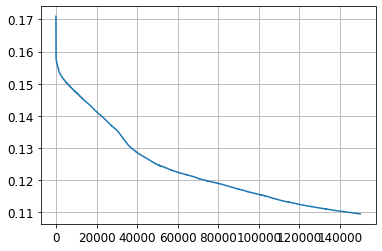

In [ ]:
n = 500 # arbitrary sample
opt_epochs = 150000
print(X_train_concat_flatten.shape)
real_coding = X_train_concat_flatten[n].reshape(1,-1)
print(real_coding.shape)
real_coding = real_coding[:,:codings_size*(ntimes - 1)]
print(real_coding.shape)
real_coding = tf.constant(real_coding)  
real_coding = tf.cast(real_coding, dtype=tf.float32)
latent_values, opt_num = optimize_coding(real_coding, weight, opt_epochs)
print('MSE Loss: ', mse_loss(generator(latent_values)[:,:(ntimes - 1),:,:], real_coding, weight).numpy())
print('MAE Loss: ', mae_loss(generator(latent_values)[:,:(ntimes - 1),:,:], real_coding, weight).numpy())
print(opt_num)
# print(latent_values)

In [ ]:
X_gen = generator.predict(np.asarray(latent_values)).reshape(ntimes, codings_size)
X_gen = invert_data(X_gen)
print(X_gen.shape)
X_gen = X_gen.reshape(ntimes, nx*nx)

(7, 65536)


In [ ]:
X_real = X_train_concat_flatten[10].reshape(ntimes,codings_size)
print(X_train_concat_flatten.shape)
X_real = invert_data(X_real)
print(X_real.shape)
X_real = X_real.reshape(ntimes, nx*nx)

(2000, 2044)
(7, 65536)


**Generated Data**

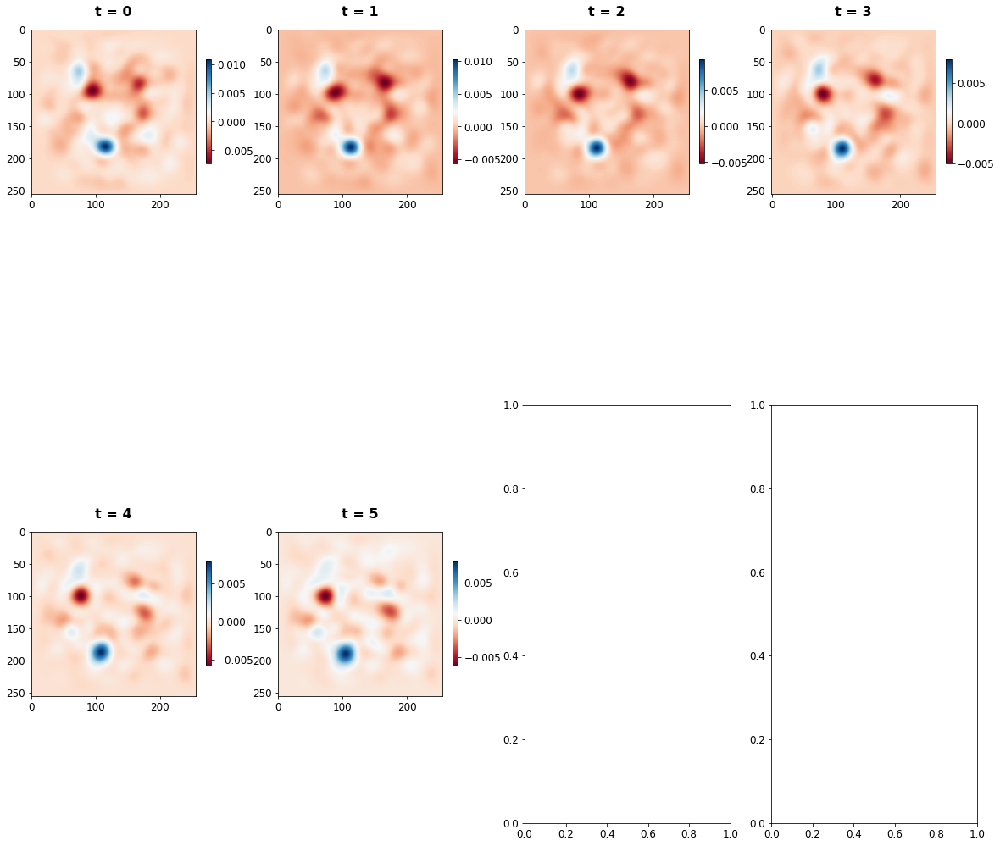

In [ ]:
times = [i for i in range(ntimes-1)]
plot_vortex(X_gen.reshape(ntimes, nx, nx), times, 4, 2)

**Real Data**

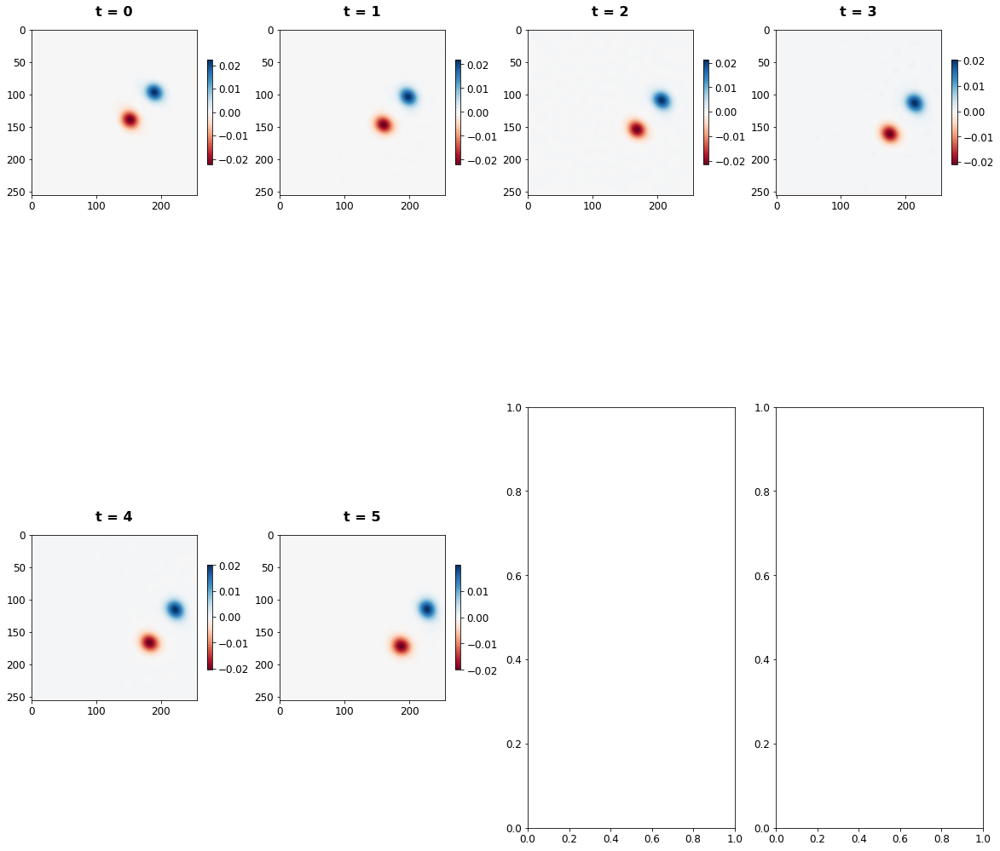

In [ ]:
plot_vortex(X_real.reshape(ntimes, nx, nx), times, 4, 2)

**Comparing Predicted and Real Data for 20th timestep**

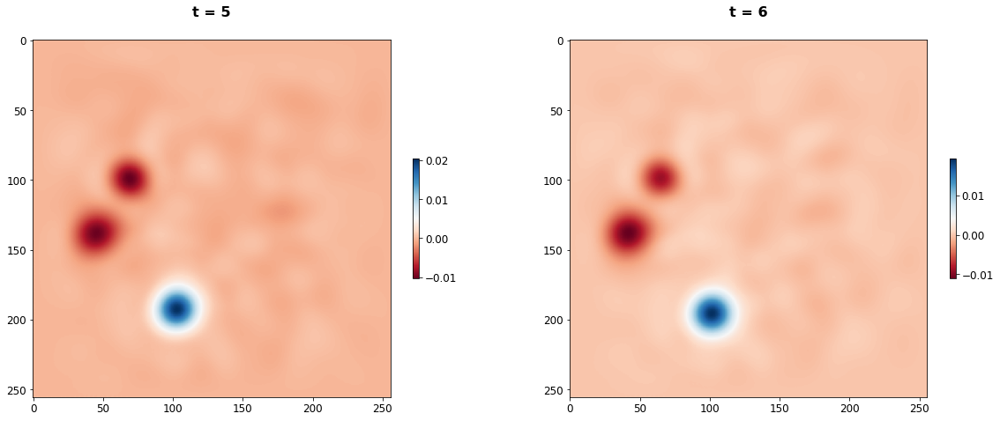

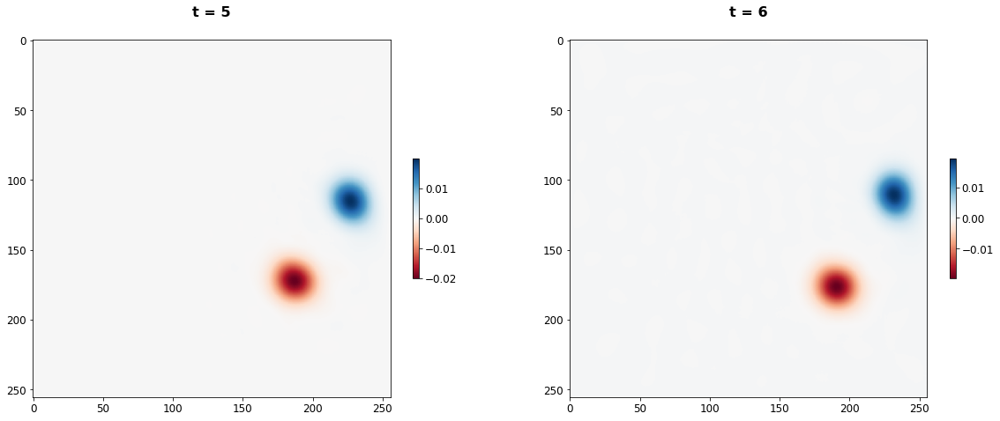

In [ ]:
plot_vortex(X_gen.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1], 2)
plot_vortex(X_real.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1],2)

In [ ]:
real = X_real.reshape(ntimes, nx, nx)
generated = X_gen.reshape(ntimes, nx, nx)
X_diff = real - generated
print('Mean Error: ', np.mean(X_diff))
print('Max. Error: ', np.max(X_diff))
plot_vortex(X_diff, times, 4, 2)

In [ ]:
discriminator.get_config()

{'layers': [{'class_name': 'InputLayer',
   'config': {'batch_input_shape': (None, 7, 292, 1),
    'dtype': 'float32',
    'name': 'conv2d_input',
    'ragged': False,
    'sparse': False}},
  {'class_name': 'Conv2D',
   'config': {'activation': 'linear',
    'activity_regularizer': None,
    'batch_input_shape': (None, 7, 292, 1),
    'bias_constraint': None,
    'bias_initializer': {'class_name': 'Zeros', 'config': {}},
    'bias_regularizer': None,
    'data_format': 'channels_last',
    'dilation_rate': (1, 1),
    'dtype': 'float32',
    'filters': 64,
    'groups': 1,
    'kernel_constraint': None,
    'kernel_initializer': {'class_name': 'GlorotUniform',
     'config': {'seed': None}},
    'kernel_regularizer': None,
    'kernel_size': (3, 3),
    'name': 'conv2d',
    'padding': 'same',
    'strides': (2, 2),
    'trainable': True,
    'use_bias': True}},
  {'class_name': 'LeakyReLU',
   'config': {'alpha': 0.30000001192092896,
    'dtype': 'float32',
    'name': 'leaky_re_lu_1

In [ ]:
generator.get_config()

{'layers': [{'class_name': 'InputLayer',
   'config': {'batch_input_shape': (None, 3000),
    'dtype': 'float32',
    'name': 'dense_1_input',
    'ragged': False,
    'sparse': False}},
  {'class_name': 'Dense',
   'config': {'activation': 'linear',
    'activity_regularizer': None,
    'batch_input_shape': (None, 3000),
    'bias_constraint': None,
    'bias_initializer': {'class_name': 'Zeros', 'config': {}},
    'bias_regularizer': None,
    'dtype': 'float32',
    'kernel_constraint': None,
    'kernel_initializer': {'class_name': 'GlorotUniform',
     'config': {'seed': None}},
    'kernel_regularizer': None,
    'name': 'dense_1',
    'trainable': True,
    'units': 30720,
    'use_bias': False}},
  {'class_name': 'BatchNormalization',
   'config': {'axis': ListWrapper([1]),
    'beta_constraint': None,
    'beta_initializer': {'class_name': 'Zeros', 'config': {}},
    'beta_regularizer': None,
    'center': True,
    'dtype': 'float32',
    'epsilon': 0.001,
    'gamma_constrai